<a href="https://colab.research.google.com/github/diegormsouza/goes-r_datajam_2023/blob/main/INPE_GOES_R_DataJam_Sept_2023_Long.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

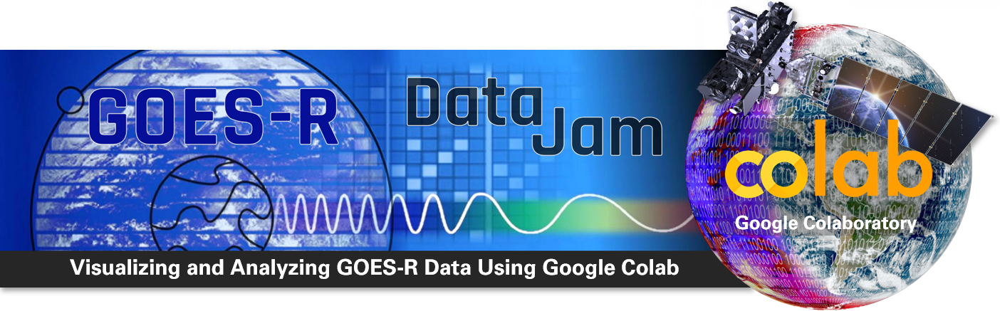

**Developed by:** Diego Souza - INPE / CGCT / DISSM - Brazil

**COLAB Notebook Version:** September 07, 2023

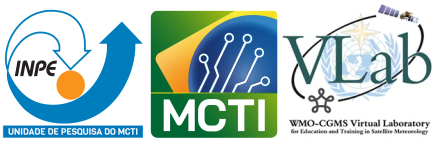

### **Contact:**
####Diego Souza - INPE / CGCT / DISSM - (diego.souza@inpe.br)
https://github.com/diegormsouza/gnc-a-caribbean/tree/main/GOES

# **Introduction**

Welcome to the **"GOES-R Data Processing With Python"** DataJam COLAB Notebook (long version)!

---


This interactive COLAB notebook contains instructions for installing the tools needed to create Python scripts to manipulate GOES-R data. All instructions and scripts run in the cloud, and there is no need to install tools and download files locally. To run the code cells, just click on the "Play" icon in square brackets on the upper left side of each cell.

# **Step 1: Checking the Virtual Machine Configuration**

In this step we check the virtual machine configuration and the Python version installed (the commands starting with "!" are shell commands, all the others are Python commands).

In [ ]:
# Verifying the installed O.S.
!cat /etc/issue
!uname -a
print('\n')

# Verifying the available RAM
!grep MemTotal /proc/meminfo
print('\n')

# Verifying the available HD space
!df -h
print('\n')

# Verifying the default Python installation directory
!which python
print('\n')

# Verifying the Python version
!python --version
print('\n')

Ubuntu 22.04.2 LTS \n \l

Linux 779a6a8f4d76 5.15.109+ #1 SMP Fri Jun 9 10:57:30 UTC 2023 x86_64 x86_64 x86_64 GNU/Linux


MemTotal:       13294252 kB


Filesystem      Size  Used Avail Use% Mounted on
overlay         108G   27G   82G  25% /
tmpfs            64M     0   64M   0% /dev
shm             5.8G     0  5.8G   0% /dev/shm
/dev/root       2.0G  1.1G  887M  55% /usr/sbin/docker-init
tmpfs           6.4G   17M  6.4G   1% /var/colab
/dev/sda1        44G   29G   16G  66% /etc/hosts
tmpfs           6.4G     0  6.4G   0% /proc/acpi
tmpfs           6.4G     0  6.4G   0% /proc/scsi
tmpfs           6.4G     0  6.4G   0% /sys/firmware


/usr/local/bin/python


Python 3.10.12




# **Step 2: Installing the Required Libraries**

In this step we install the libraries needed to run the scripts. Basically, the libraries will do the following:

*   **NetCDF4:** Read the pixel values from the NetCDF4 files.
*   **Cartopy:** Add maps to our plots.
*   **Boto3:** Download GOES-R data directly from the Amazon Web Services
*   **GDAL:** Reprojection (from GOES-R projection to equidistant)







In [ ]:
# Installing the NetCDF4 library
!pip install netcdf4
print('\n')

# Installing the Cartopy library
!pip install cartopy
!pip install shapely --no-binary shapely --force
print('\n')

# Installing the Boto3 library
!pip install boto3
print('\n')

# Installing / updating the GDAL library
!apt-add-repository -y ppa:ubuntugis/ubuntugis-unstable
!add-apt-repository -y ppa:ubuntugis/ppa
!apt-get install gdal-bin
!pip install 'gdal==3.0.4'
print('\n')

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.4/5.4 MB 16.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 28.3 MB/s eta 0:00:00


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 15.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.5/46.5 kB 4.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.5/275.5 kB 3.0 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.2/18.2 MB 37.4 MB/s eta 0:00:00
  Created wheel for shapely: filename=shapely-2.0.1-cp310-cp310-linux_x86_64.whl size=890041 sha256=95b31b438b92bb7643a4af873d36dcde38a071db86633c6d9747cf20d15d6234
  Stored in directory: /root/.cache/pip/wheels/07/bd/06/4e979fa263bca266484ee65f5aab8e6b1c9b20f8caa6f2d7da
Successfully built shapely
  Attempting uninstall: numpy
    Found 



     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.8/135.8 kB 1.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.2/11.2 MB 28.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.8/79.8 kB 7.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.1/143.1 kB 13.0 MB/s eta 0:00:00
  Attempting uninstall: urllib3
    Found existing installation: urllib3 2.0.4
    Uninstalling urllib3-2.0.4:
      Successfully uninstalled urllib3-2.0.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.12.0 requires numpy<1.24,>=1.22, but you have numpy 1.25.2 which is incompatible.


PPA publishes dbgsym, you may need to include 'main/debug' component
Repository: 'deb https://ppa.launchpadcontent.net/ubuntugis/ubuntugis-unstable/ubuntu/ jammy main'
Description:
Unstable releases of Ubuntu GIS packages. These releases are more 

#**Step 3: Downloading Ancillary Files**

In this step we will download some ancillary files, necessary for some of the scripts that will be demonstrated:



*   **ne_10m_admin_1_states_provinces.zip:** Shapefile with the world states and provinces
*   **IR4AVHRR6.cpt:** Color palette for GOES-16 infrared channels
*   **utilities.py:** Script with some useful functions
*   **OR_ABI-L2-CMIPF-M6C0X_G16_s*_e*_c*.nc:** GOES-16 data samples (ABI sensor)
*   **OR_GLM-L2-LCFA_G16_s*_e*_c*.nc:** GOES-16 data sample (GLM sensor)

In [ ]:
# Download a shapefile (world states and provinces)
!wget -c https://www.naturalearthdata.com/http//www.naturalearthdata.com/download/10m/cultural/ne_10m_admin_1_states_provinces.zip
print('\n')

# Unzip the shapefile
!unzip -o ne_10m_admin_1_states_provinces.zip
print('\n')

# Download an example "CPT" file (color pallete for IR channels)
!wget -c https://www.dropbox.com/s/fdgnaqt91cy3x97/IR4AVHRR6.cpt
print('\n')

# Download the utilities.py script, created by INPE (contains some useful functions for processing GOES-R data)
!wget -c https://www.dropbox.com/s/i8j1g9xg1g7o56l/utilities.py
print('\n')

# Create the 'Samples' and 'Output' directories
!mkdir -p Samples
!mkdir -p Output
print('\n')

# Download some GOES-16 samples
!wget -c https://noaa-goes16.s3.amazonaws.com/ABI-L2-CMIPF/2019/198/12/OR_ABI-L2-CMIPF-M6C08_G16_s20191981200396_e20191981210104_c20191981210182.nc -P /content/Samples/
!wget -c https://noaa-goes16.s3.amazonaws.com/ABI-L2-CMIPF/2019/198/12/OR_ABI-L2-CMIPF-M6C10_G16_s20191981200396_e20191981210116_c20191981210188.nc -P /content/Samples/
!wget -c https://noaa-goes16.s3.amazonaws.com/ABI-L2-CMIPF/2019/198/12/OR_ABI-L2-CMIPF-M6C12_G16_s20191981200396_e20191981210111_c20191981210185.nc -P /content/Samples/
!wget -c https://noaa-goes16.s3.amazonaws.com/ABI-L2-CMIPF/2019/198/12/OR_ABI-L2-CMIPF-M6C13_G16_s20191981200396_e20191981210116_c20191981210189.nc -P /content/Samples/
!wget -c https://noaa-goes16.s3.amazonaws.com/GLM-L2-LCFA/2019/198/12/OR_GLM-L2-LCFA_G16_s20191981200000_e20191981200200_c20191981200224.nc -P /content/Samples/
print('\n')

--2023-09-07 14:50:37--  https://www.naturalearthdata.com/http//www.naturalearthdata.com/download/10m/cultural/ne_10m_admin_1_states_provinces.zip
Resolving www.naturalearthdata.com (www.naturalearthdata.com)... 50.87.253.14
Connecting to www.naturalearthdata.com (www.naturalearthdata.com)|50.87.253.14|:443... connected.
HTTP request sent, awaiting response... 302 Moved Temporarily
Location: https://naciscdn.org/naturalearth/10m/cultural/ne_10m_admin_1_states_provinces.zip [following]
--2023-09-07 14:50:38--  https://naciscdn.org/naturalearth/10m/cultural/ne_10m_admin_1_states_provinces.zip
Resolving naciscdn.org (naciscdn.org)... 18.65.229.31, 18.65.229.66, 18.65.229.84, ...
Connecting to naciscdn.org (naciscdn.org)|18.65.229.31|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 14909524 (14M) [application/zip]
Saving to: ‘ne_10m_admin_1_states_provinces.zip’

ne_10m_admin_1_stat 100%[===================>]  14.22M  --.-KB/s    in 0.09s   

2023-09-07 14:50:38 (1

# **Reference Table: GOES-R Channels and Wavelengths**

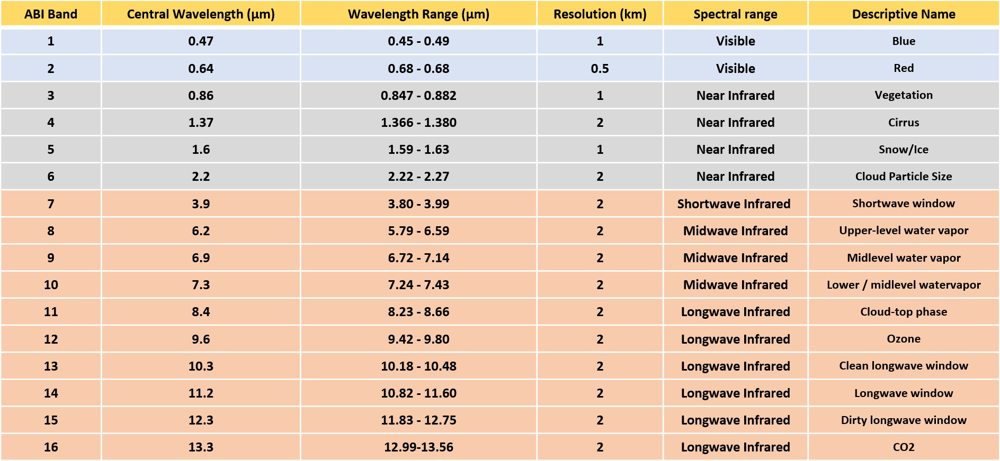

#**Script 1: Basic Plot / Reading Pixel Values**


In this script we are going to make a basic plot of one of the ABI sensor channels. We're going to see how to use the NetCDF library to read data from one of the datasets in the file, called "CMI" or "Cloud and Moisture Imagery" (https://www.goes-r.gov/products/baseline-cloud-moisture-imagery.html). This is a 2D matrix, which we will read in its entirety in this example (colon ":" in the code). We'll also see how to set the size of the plot, configure its basic appearance and save the resulting plot in PNG.

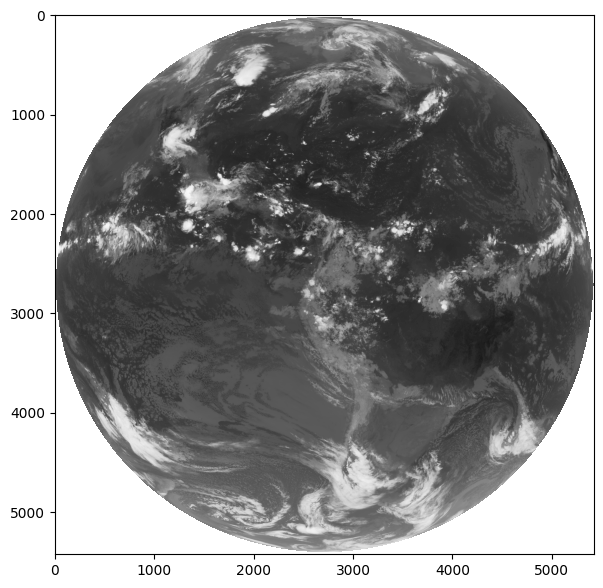

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Training: Python and GOES-R Imagery: Script 1 - Basic Plot / Extracting Pixel Values
# Author: Diego Souza (DISSM/CGCT/INPE)
#-----------------------------------------------------------------------------------------------------------
# Required modules
from netCDF4 import Dataset      # Read / Write NetCDF4 files
import matplotlib.pyplot as plt  # Plotting library
#-----------------------------------------------------------------------------------------------------------
# Open the GOES-R image
# Download files at this link: http://home.chpc.utah.edu/~u0553130/Brian_Blaylock/cgi-bin/goes16_download.cgi
file = Dataset("Samples/OR_ABI-L2-CMIPF-M6C13_G16_s20191981200396_e20191981210116_c20191981210189.nc")

# Get the pixel values
data = file.variables['CMI'][:]
#-----------------------------------------------------------------------------------------------------------
# Choose the plot size (width x height, in inches)
plt.figure(figsize=(7,7))

# Plot the image
plt.imshow(data, vmin=193, vmax=313, cmap='Greys')
#-----------------------------------------------------------------------------------------------------------
# Save the image
plt.savefig('Output/Image_01.png')

# Show the image
plt.show()

**Checking the available datasets of a NetCDF file**

But how can we know the available datasets? Please find below the instructions needed to list the datasets and check the parameters of a given dataset (CMI in this example). We can check the dimensions, units and many other info.

In [ ]:
# Reading the key variables
print(file.variables.keys())
print('\n')

# Reading an specific variable
print(file.variables['CMI'])
print('\n')

# Reading an specific variable parameter
print("The fill value is:", file.variables['CMI']._FillValue)

dict_keys(['CMI', 'DQF', 't', 'y', 'x', 'time_bounds', 'goes_imager_projection', 'y_image', 'y_image_bounds', 'x_image', 'x_image_bounds', 'nominal_satellite_subpoint_lat', 'nominal_satellite_subpoint_lon', 'nominal_satellite_height', 'geospatial_lat_lon_extent', 'band_wavelength', 'band_id', 'total_number_of_points', 'valid_pixel_count', 'outlier_pixel_count', 'min_brightness_temperature', 'max_brightness_temperature', 'mean_brightness_temperature', 'std_dev_brightness_temperature', 'planck_fk1', 'planck_fk2', 'planck_bc1', 'planck_bc2', 'algorithm_dynamic_input_data_container', 'percent_uncorrectable_GRB_errors', 'percent_uncorrectable_L0_errors', 'earth_sun_distance_anomaly_in_AU', 'processing_parm_version_container', 'algorithm_product_version_container', 'esun', 'kappa0', 'focal_plane_temperature_threshold_exceeded_count', 'maximum_focal_plane_temperature', 'focal_plane_temperature_threshold_increasing', 'focal_plane_temperature_threshold_decreasing'])


<class 'netCDF4._netCDF4.V

**Reading the global attributes of a NetCDF file**

We can also read the so-called "global attributes", with very usefull information like the file time and date, resolution, satellite and the instrument).

In [ ]:
# Reading the global attributes
print(file.ncattrs())
print('\n')

# Reading specific global attributes
print("Start of the scan: " +file.getncattr('time_coverage_start'))
print("Satellite: " + file.getncattr('platform_ID'))
print("Instrument: " + file.getncattr('instrument_type'))

# Reading the band number
print("Band " + str(file.variables['band_id'][0]).zfill(2))

['naming_authority', 'Conventions', 'Metadata_Conventions', 'standard_name_vocabulary', 'institution', 'project', 'production_site', 'production_environment', 'spatial_resolution', 'orbital_slot', 'platform_ID', 'instrument_type', 'scene_id', 'instrument_ID', 'dataset_name', 'iso_series_metadata_id', 'title', 'summary', 'keywords', 'keywords_vocabulary', 'license', 'processing_level', 'date_created', 'cdm_data_type', 'time_coverage_start', 'time_coverage_end', 'timeline_id', 'production_data_source', 'id']


Start of the scan: 2019-07-17T12:00:39.6Z
Satellite: G16
Instrument: GOES R Series Advanced Baseline Imager
Band 13


#**Script 2: Basic Operation / Colorbar / Title / Date**

In this example we'll check how to convert the data from K to °C, we'll add a legend (colorbar), and read the aqcuisition date directly from the metadata. We'll also add a title to our plot.

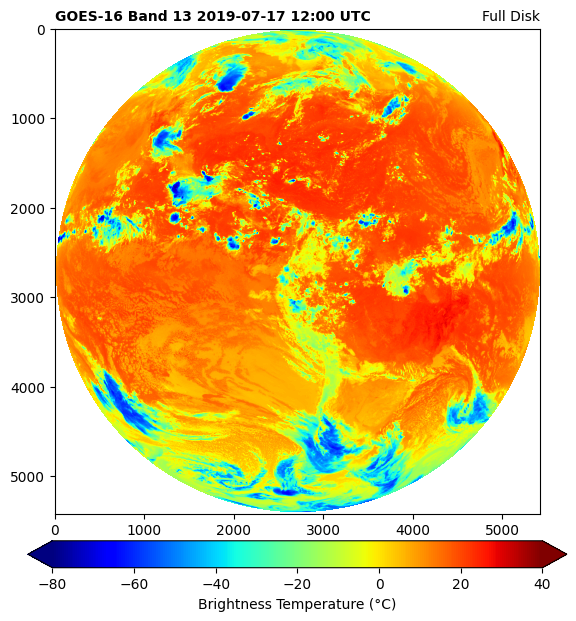

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Training: Python and GOES-R Imagery: Script 2 - Basic Operation / Colorbar / Title / Date
# Author: Diego Souza (DISSM/CGCT/INPE)
#-----------------------------------------------------------------------------------------------------------
# Required modules
from netCDF4 import Dataset      # Read / Write NetCDF4 files
import matplotlib.pyplot as plt  # Plotting library
from datetime import datetime    # Basic Dates and time types
#-----------------------------------------------------------------------------------------------------------
# Open the GOES-R image
# Download files at this link: http://home.chpc.utah.edu/~u0553130/Brian_Blaylock/cgi-bin/goes16_download.cgi
file = Dataset("/content/Samples/OR_ABI-L2-CMIPF-M6C13_G16_s20191981200396_e20191981210116_c20191981210189.nc")

# Get the pixel values
data = file.variables['CMI'][:] - 273.15
#-----------------------------------------------------------------------------------------------------------
# Choose the plot size (width x height, in inches)
plt.figure(figsize=(7,7))

# Plot the image
plt.imshow(data, vmin=-80, vmax=40, cmap='jet')

# Add a colorbar
plt.colorbar(label='Brightness Temperature (°C)', extend='both', orientation='horizontal', pad=0.05, fraction=0.05)

# Extract date
date = (datetime.strptime(file.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title('GOES-16 Band 13 ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')
#-----------------------------------------------------------------------------------------------------------
# Save the image
plt.savefig('/content/Output/Image_02.png')

# Show the image
plt.show()

#**Script 3: Overlaying Maps with Cartopy**

So far, our data is not georeferenced. The Cartopy library makes this job much easier. Using it, we'll add maps to our plot (coastlines and contries [borders]), as well as latitude and longitude references.

/usr/local/lib/python3.10/dist-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/110m_cultural/ne_110m_admin_0_boundary_lines_land.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)
/usr/local/lib/python3.10/dist-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/110m_physical/ne_110m_coastline.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)


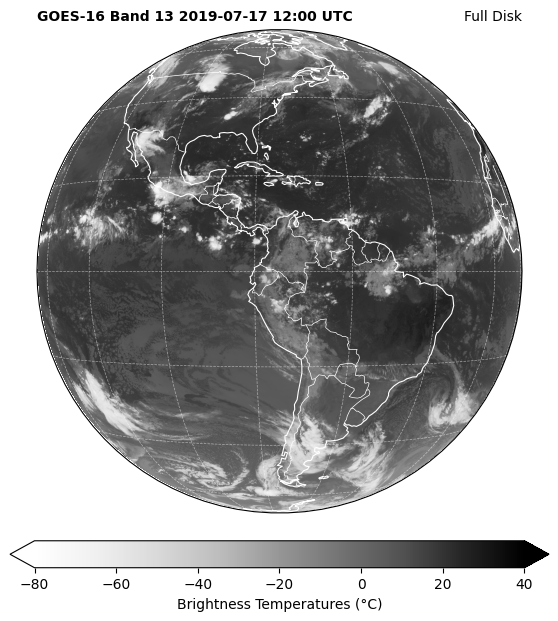

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Training: Python and GOES-R Imagery: Script 3 - Adding a Map with Cartopy (Readin parameters from header)
# Author: Diego Souza (DISSM/CGCT/INPE)
#-----------------------------------------------------------------------------------------------------------
# Required modules
from netCDF4 import Dataset                # Read / Write NetCDF4 files
import matplotlib.pyplot as plt            # Plotting library
from datetime import datetime              # Basic Dates and time types
import cartopy, cartopy.crs as ccrs        # Plot maps
import cartopy.io.shapereader as shpreader # Import shapefiles
#-----------------------------------------------------------------------------------------------------------
# Open the GOES-R image
# Download files at this link: http://home.chpc.utah.edu/~u0553130/Brian_Blaylock/cgi-bin/goes16_download.cgi
file = Dataset("/content/Samples/OR_ABI-L2-CMIPF-M6C13_G16_s20191981200396_e20191981210116_c20191981210189.nc")

# Get the pixel values
data = file.variables['CMI'][:] - 273.15
#-----------------------------------------------------------------------------------------------------------
# Choose the plot size (width x height, in inches)
plt.figure(figsize=(7,7))

# Use the Geostationary projection in cartopy
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=-75.0, satellite_height=35786023.0))
img_extent = (-5434894.67527,5434894.67527,-5434894.67527,5434894.67527)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
ax.coastlines(resolution='110m', color='white', linewidth=0.8)
ax.gridlines(color='white', alpha=0.5, linestyle='--', linewidth=0.5)

# Plot the image
img = ax.imshow(data, vmin=-80, vmax=40, origin='upper', extent=img_extent, cmap='Greys')

# Add a colorbar
plt.colorbar(img, label='Brightness Temperatures (°C)', extend='both', orientation='horizontal', pad=0.05, fraction=0.05)

# Extract date
date = (datetime.strptime(file.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title('GOES-16 Band 13 ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')
#-----------------------------------------------------------------------------------------------------------
# Save the image
plt.savefig('/content/Output/Image_03.png')

# Show the image
plt.show()

#**Script 4: Overlaying Maps with Cartopy (Reading the Metadata)**

In the previous example, we manually added the data extension required by Cartopy. In the example below, we will read this information directly from the metadata and calculate the extent of the information, according to the CMI product documentation. We'll also read the satellite's central longitude and altitude directly from its metadata. The result should be the same as in the previous script.

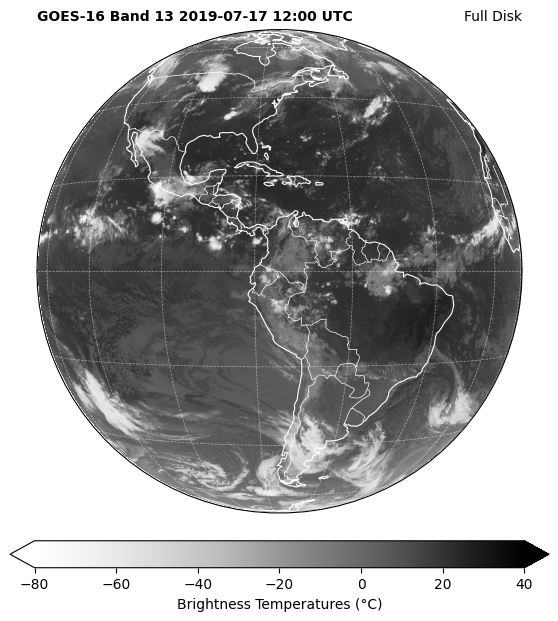

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Training: Python and GOES-R Imagery: Script 4 - Adding a Map with Cartopy
# Author: Diego Souza (DISSM/CGCT/INPE)
#-----------------------------------------------------------------------------------------------------------
# Required modules
from netCDF4 import Dataset                # Read / Write NetCDF4 files
import matplotlib.pyplot as plt            # Plotting library
from datetime import datetime              # Basic Dates and time types
import cartopy, cartopy.crs as ccrs        # Plot maps
import cartopy.io.shapereader as shpreader # Import shapefiles
#-----------------------------------------------------------------------------------------------------------
# Open the GOES-R image
# Download files at this link: http://home.chpc.utah.edu/~u0553130/Brian_Blaylock/cgi-bin/goes16_download.cgi
file = Dataset("/content/Samples/OR_ABI-L2-CMIPF-M6C13_G16_s20191981200396_e20191981210116_c20191981210189.nc")

# Get the pixel values
data = file.variables['CMI'][:] - 273.15
#-----------------------------------------------------------------------------------------------------------
# Choose the plot size (width x height, in inches)
plt.figure(figsize=(7,7))

# Use the Geostationary projection in cartopy
longitude_of_projection_origin = file.variables['goes_imager_projection'].longitude_of_projection_origin
perspective_point_height = file.variables['goes_imager_projection'].perspective_point_height
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=longitude_of_projection_origin, satellite_height=perspective_point_height))

# Extent of data in decimais (2712*0.000056*35786023.0)
xmin = file.variables['x'][:].min()*perspective_point_height
xmax = file.variables['x'][:].max()*perspective_point_height
ymin = file.variables['y'][:].min()*perspective_point_height
ymax = file.variables['y'][:].max()*perspective_point_height
img_extent = (xmin, xmax, ymin, ymax)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
ax.coastlines(resolution='110m', color='white', linewidth=0.8)
ax.gridlines(color='white', alpha=0.5, linestyle='--', linewidth=0.5)

# Plot the image
img = ax.imshow(data, vmin=-80, vmax=40, origin='upper', extent=img_extent, cmap='Greys')

# Add a colorbar
plt.colorbar(img, label='Brightness Temperatures (°C)', extend='both', orientation='horizontal', pad=0.05, fraction=0.05)

# Extract date
date = (datetime.strptime(file.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title('GOES-16 Band 13 ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')
#-----------------------------------------------------------------------------------------------------------
# Save the image
plt.savefig('/content/Output/Image_04.png')

# Show the image
plt.show()

#**Script 5: Reading a Shapefile**

In this example we will add a shapefile of world states and provinces.

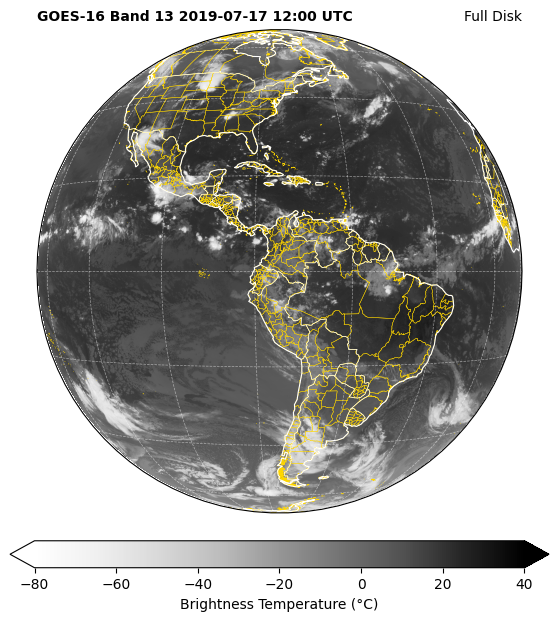

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Training: Python and GOES-R Imagery: Script 5 - Reading a Shapefile
# Author: Diego Souza (DISSM/CGCT/INPE)
#-----------------------------------------------------------------------------------------------------------
# Required modules
from netCDF4 import Dataset                # Read / Write NetCDF4 files
import matplotlib.pyplot as plt            # Plotting library
from datetime import datetime              # Basic Dates and time types
import cartopy, cartopy.crs as ccrs        # Plot maps
import cartopy.io.shapereader as shpreader # Import shapefiles
#-----------------------------------------------------------------------------------------------------------
# Open the GOES-R image
# Download files at this link: http://home.chpc.utah.edu/~u0553130/Brian_Blaylock/cgi-bin/goes16_download.cgi
file = Dataset("/content/Samples/OR_ABI-L2-CMIPF-M6C13_G16_s20191981200396_e20191981210116_c20191981210189.nc")

# Get the pixel values, and convert to Celsius
data = file.variables['CMI'][:] - 273.15
#-----------------------------------------------------------------------------------------------------------
# Choose the plot size (width x height, in inches)
plt.figure(figsize=(7,7))

# Use the Geostationary projection in cartopy
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=-75.0, satellite_height=35786023.0))
img_extent = (-5434894.67527,5434894.67527,-5434894.67527,5434894.67527)

# Add a shapefile
shapefile = list(shpreader.Reader('/content/ne_10m_admin_1_states_provinces.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='gold',facecolor='none', linewidth=0.3)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
ax.coastlines(resolution='110m', color='white', linewidth=0.8)
ax.gridlines(color='white', alpha=0.5, linestyle='--', linewidth=0.5)

# Plot the image
img = ax.imshow(data, vmin=-80, vmax=40, origin='upper', extent=img_extent, cmap='Greys')

# Add a colorbar
plt.colorbar(img, label='Brightness Temperature (°C)', extend='both', orientation='horizontal', pad=0.05, fraction=0.05)

# Extract date
date = (datetime.strptime(file.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title('GOES-16 Band 13 ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')
#-----------------------------------------------------------------------------------------------------------
# Save the image
plt.savefig('/content/Output/Image_05.png')

# Show the image
plt.show()

#**Script 6: ABI + GLM (Basic Plot)**

In this example, we're going to overlay data from the GLM sensor on our ABI  plot. We'll read the arrays of events, groups and flashes and add them to the plot as point data.

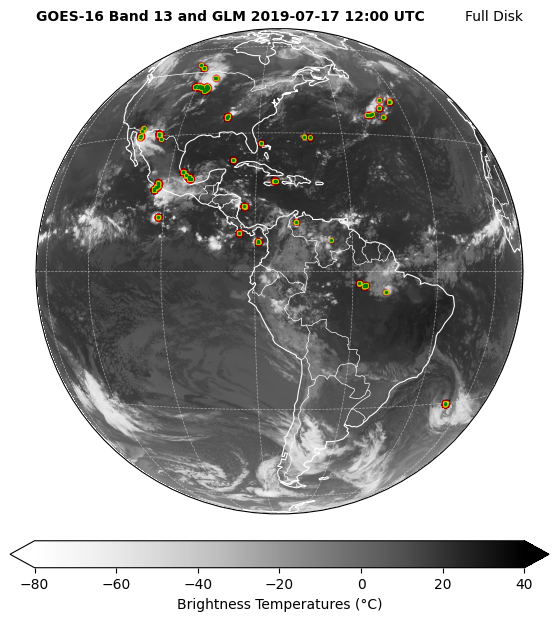

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Training: Python and GOES-R Imagery: Script 6 - ABI and GLM
# Author: Diego Souza (DISSM/CGCT/INPE)
#-----------------------------------------------------------------------------------------------------------
# Required modules
from netCDF4 import Dataset          # Read / Write NetCDF4 files
import matplotlib.pyplot as plt      # Plotting library
from datetime import datetime        # Basic Dates and time types
import cartopy, cartopy.crs as ccrs  # Plot maps
#-----------------------------------------------------------------------------------------------------------
# Open the GOES-R image
# Download files at this link: http://home.chpc.utah.edu/~u0553130/Brian_Blaylock/cgi-bin/goes16_download.cgi
file = Dataset("/content/Samples/OR_ABI-L2-CMIPF-M6C13_G16_s20191981200396_e20191981210116_c20191981210189.nc")

# Get the pixel values
data = file.variables['CMI'][:] - 273.15

# Choose the plot size (width x height, in inches)
plt.figure(figsize=(7,7))

# Use the Geostationary projection in cartopy
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=-75.0, satellite_height=35786023.0))
img_extent = (-5434894.67527,5434894.67527,-5434894.67527,5434894.67527)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
ax.coastlines(resolution='110m', color='white', linewidth=0.8)
ax.gridlines(color='white', alpha=0.5, linestyle='--', linewidth=0.5)

# Plot the image
img = ax.imshow(data, vmin=-80, vmax=40, origin='upper', extent=img_extent, cmap='Greys')
#-----------------------------------------------------------------------------------------------------------
# Open the GLM file
# Download files at this link: http://home.chpc.utah.edu/~u0553130/Brian_Blaylock/cgi-bin/goes16_download.cgi
fileGLM = Dataset("/content/Samples/OR_GLM-L2-LCFA_G16_s20191981200000_e20191981200200_c20191981200224.nc")

e_lats = fileGLM.variables['event_lat'][:]
e_lons = fileGLM.variables['event_lon'][:]

g_lats = fileGLM.variables['group_lat'][:]
g_lons = fileGLM.variables['group_lon'][:]

f_lats = fileGLM.variables['flash_lat'][:]
f_lons = fileGLM.variables['flash_lon'][:]

img2 = ax.plot(e_lons,e_lats,'.r', markersize=10, transform=ccrs.PlateCarree(), alpha=0.01)
img3 = ax.plot(g_lons,g_lats,'.y', markersize=5, transform=ccrs.PlateCarree(), alpha=0.5)
img4 = ax.plot(f_lons,f_lats,'.g', markersize=2.5, transform=ccrs.PlateCarree(), alpha=1)
#-----------------------------------------------------------------------------------------------------------
# Add a colorbar
plt.colorbar(img, label='Brightness Temperatures (°C)', extend='both', orientation='horizontal', pad=0.05, fraction=0.05)

# Extract date
date = (datetime.strptime(file.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title('GOES-16 Band 13 and GLM ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')
#-----------------------------------------------------------------------------------------------------------
# Save the image
plt.savefig('/content/Output/Image_06.png')

# Show the image
plt.show()

#**Script 7: Creating RGB Composites**

In this example we're going to process an RGB composite (called "Airmass"), creating a "stack" of operations between channels that result in the red, green and blue components, according to the "recipe" below, found at: http://rammb.cira.colostate.edu/training/visit/quick_guides/QuickGuide_GOESR_AirMassRGB_final.pdf

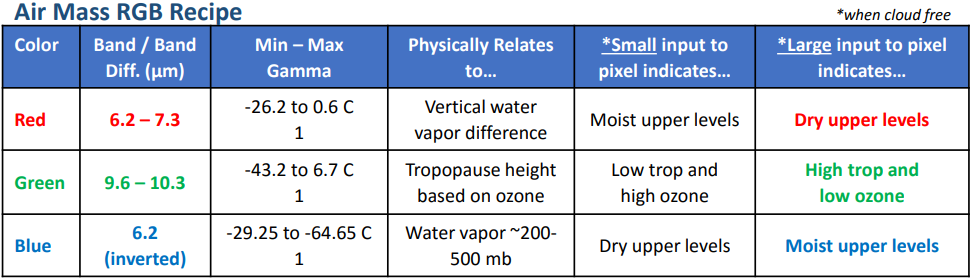

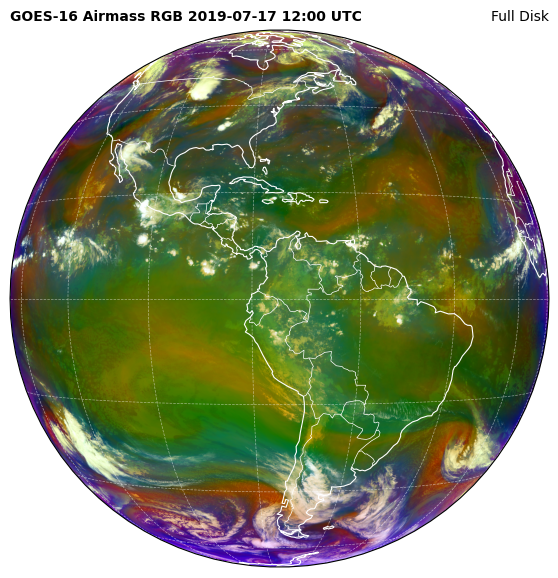

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Training: Python and GOES-R Imagery: Script 7 - RGB Composite (Airmass)
# Author: Diego Souza (DISSM/CGCT/INPE)
#-----------------------------------------------------------------------------------------------------------
# Required modules
from netCDF4 import Dataset                # Read / Write NetCDF4 files
import matplotlib.pyplot as plt            # Plotting library
from datetime import datetime              # Basic Dates and time types
import cartopy, cartopy.crs as ccrs        # Plot maps
import numpy as np                         # Import the Numpy package
#-----------------------------------------------------------------------------------------------------------
# Open the GOES-R image
# Download files at this link: http://home.chpc.utah.edu/~u0553130/Brian_Blaylock/cgi-bin/goes16_download.cgi
file1 = Dataset("/content/Samples/OR_ABI-L2-CMIPF-M6C08_G16_s20191981200396_e20191981210104_c20191981210182.nc")
# Get the pixel values, and convert to Celsius
data1 = file1.variables['CMI'][:,:][::4 ,::4] - 273.15

# Open the GOES-R image
file2 = Dataset("/content/Samples/OR_ABI-L2-CMIPF-M6C10_G16_s20191981200396_e20191981210116_c20191981210188.nc")
# Get the pixel values, and convert to Celsius
data2 = file2.variables['CMI'][:,:][::4 ,::4] - 273.15

# Open the GOES-R image
file3 = Dataset("/content/Samples/OR_ABI-L2-CMIPF-M6C12_G16_s20191981200396_e20191981210111_c20191981210185.nc")
# Get the pixel values, and convert to Celsius
data3 = file3.variables['CMI'][:,:][::4 ,::4] - 273.15

# Open the GOES-R image
file4 = Dataset("/content/Samples/OR_ABI-L2-CMIPF-M6C13_G16_s20191981200396_e20191981210116_c20191981210189.nc")
# Get the pixel values, and convert to Celsius
data4 = file4.variables['CMI'][:,:][::4 ,::4] - 273.15
#-----------------------------------------------------------------------------------------------------------
# RGB Quick Guide: http://rammb.cira.colostate.edu/training/visit/quick_guides/QuickGuide_GOESR_AirMassRGB_final.pdf

# RGB Components
R = data1 - data2
G = data3 - data4
B = data1

# Minimuns, Maximuns and Gamma
Rmin = -26.2
Rmax = 0.6

Gmin = -43.2
Gmax = 6.7

Bmin = -64.65
Bmax = -29.25

R[R > Rmax] = Rmax
R[R < Rmin] = Rmin

G[G > Gmax] = Gmax
G[G < Gmin] = Gmin

B[B > Bmax] = Bmax
B[B < Bmin] = Bmin

gamma_R = 1
gamma_G = 1
gamma_B = 1

# Normalize the data
R = ((R - Rmin) / (Rmax - Rmin)) ** (1/gamma_R)
G = ((G - Gmin) / (Gmax - Gmin)) ** (1/gamma_G)
B = ((B - Bmin) / (Bmax - Bmin)) ** (1/gamma_B)

# Invert the "Blue" component
B = 1.0 - B

# Create the RGB
RGB = np.stack([R, G, B], axis=2)
#-----------------------------------------------------------------------------------------------------------
# Choose the plot size (width x height, in inches)
plt.figure(figsize=(7,7))

# Use the Geostationary projection in cartopy
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=-75.0, satellite_height=35786023.0))
img_extent = (-5434894.67527,5434894.67527,-5434894.67527,5434894.67527)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
ax.coastlines(resolution='110m', color='white', linewidth=0.8)
ax.gridlines(color='white', alpha=0.5, linestyle='--', linewidth=0.5)

# Plot the image
img = ax.imshow(RGB, origin='upper', extent=img_extent)

# Extract date
date = (datetime.strptime(file1.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title('GOES-16 Airmass RGB ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')
#-----------------------------------------------------------------------------------------------------------
# Save the image
plt.savefig('/content/Output/Image_07.png')

# Show the image
plt.show()

#**Script 8: Custom Colormaps - Enhancing IR Channels**

The standard matplotlib color palettes (colormaps) can be found at the following link: https://matplotlib.org/3.5.0/tutorials/colors/colormaps.html

Although varied, sometimes the options are not suitable for some applications. In this example, we'll learn four ways to create custom color palettes (merging existing palettes, discrete palette, continuous palette, and reading "CPT" files).

<ipython-input-13-62a81405bdea>:21: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  gray_cmap = cm.get_cmap('gray_r', 120)                            # Read the reversed 'gray' cmap
<ipython-input-13-62a81405bdea>:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet_cmap  = cm.get_cmap('jet_r', 40)                              # Read the reversed 'jet' cmap
<ipython-input-13-62a81405bdea>:37: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  gray_cmap = cm.get_cmap('gray_r', 120)  

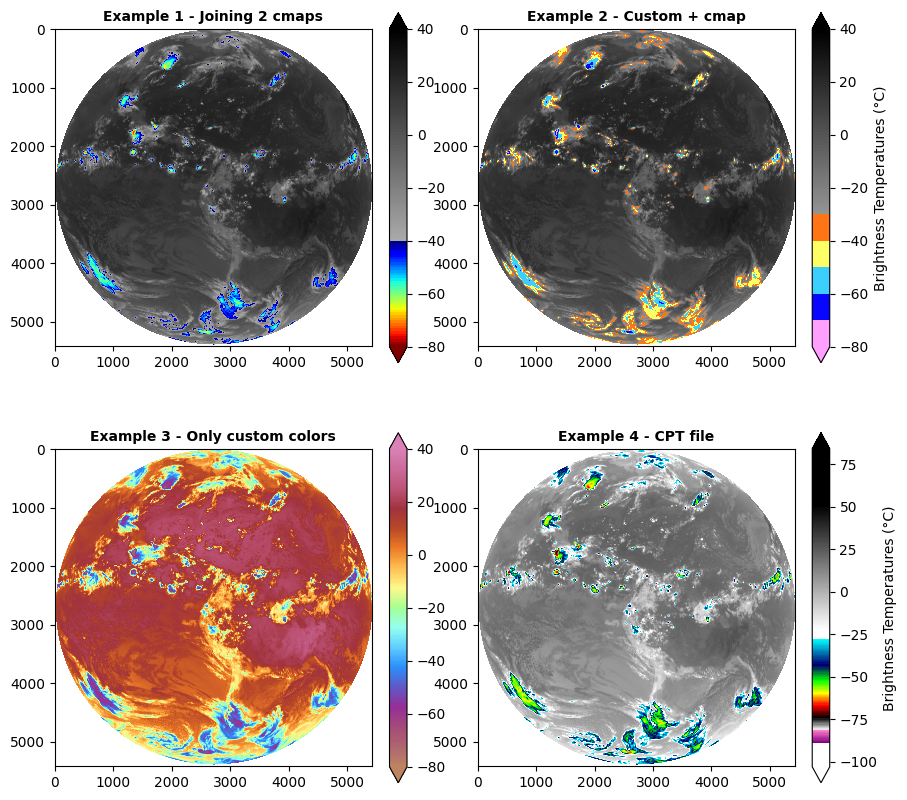

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Training: Python and GOES-R Imagery: Script 8 - Custom Colormaps - Enhancing IR Channels
# Author: Diego Souza (DISSM/CGCT/INPE)
#-----------------------------------------------------------------------------------------------------------
# Required modules
from netCDF4 import Dataset          # Read / Write NetCDF4 files
import matplotlib.pyplot as plt      # Plotting library
from datetime import datetime        # Basic Dates and time types
from matplotlib import cm            # Colormap handling utilities
import numpy as np                   # Scientific computing with Python
from utilities import loadCPT        # Import the CPT convert function
#-----------------------------------------------------------------------------------------------------------

# COLORMAP EXAMPLE 1
# Custom colormap joining matplotlib colormaps
# Available matplotlib colormaps: https://matplotlib.org/stable/tutorials/colors/colormaps.html

vmin1 = -80                                                       # Min. value
vmax1 = 40                                                        # Max. value

gray_cmap = cm.get_cmap('gray_r', 120)                            # Read the reversed 'gray' cmap
gray_cmap = gray_cmap(np.linspace(0, 1, 120))                     # Create the array
jet_cmap  = cm.get_cmap('jet_r', 40)                              # Read the reversed 'jet' cmap
jet_cmap  = jet_cmap(np.linspace(0, 1, 40))                       # Create the array
gray_cmap[:40, :] = jet_cmap                                      # Join both cmaps arrays
my_cmap1 = cm.colors.ListedColormap(gray_cmap)                    # Create the custom colormap

#-----------------------------------------------------------------------------------------------------------

# COLORMAP EXAMPLE 2
# Creating the INPE DISSM IR colormap
# Online color picker: https://imagecolorpicker.com/

vmin2 = -80                                                       # Min. value
vmax2 = 40                                                        # Max. value

gray_cmap = cm.get_cmap('gray_r', 120)                            # Read the reversed 'gray' cmap
gray_cmap = gray_cmap(np.linspace(0, 1, 120))                     # Create the array
colors = ["#ffa0ff", "#0806ff", "#3bcfff", "#feff65", "#ff7516"]  # Custom colors
my_colors = cm.colors.ListedColormap(colors)                      # Create a custom colormap
my_colors = my_colors(np.linspace(0, 1, 50))                      # Create the array
gray_cmap[:50, :] = my_colors                                     # Join both cmaps arrays
my_cmap2 = cm.colors.ListedColormap(gray_cmap)                    # Create the custom colormap

#-----------------------------------------------------------------------------------------------------------

# COLORMAP EXAMPLE 3
# Creating a linear colormap
# Online color picker: https://imagecolorpicker.com/

colors = ["#bc8462", "#ae656f", "#a44a79", "#962e97", "#6158c5",
          "#2b8ffb", "#5fcdff", "#94fff0", "#a5ff94", "#fff88c",
          "#ffbf52", "#ec7b27", "#b84827", "#a1333d", "#bd5478",
          "#cc6a99", "#d982b8"]
my_cmap3 = cm.colors.LinearSegmentedColormap.from_list("", colors)# Create a custom linear colormap
vmin3 = -80                                                       # Min. value
vmax3 = 40                                                        # Max. value

#-----------------------------------------------------------------------------------------------------------

# COLORMAP EXAMPLE 4
# Converts a CPT file to be used in Python
# CPT archive: http://soliton.vm.bytemark.co.uk/pub/cpt-city/

cpt = loadCPT('/content/IR4AVHRR6.cpt')                   # Load the CPT file
my_cmap4 = cm.colors.LinearSegmentedColormap('cpt', cpt)          # Create a custom linear colormap
vmin4 = -103.0                                                    # Min. value
vmax4 = 84.0                                                      # Max. value

#-----------------------------------------------------------------------------------------------------------
# Open the GOES-R image
# Download files at this link: http://home.chpc.utah.edu/~u0553130/Brian_Blaylock/cgi-bin/goes16_download.cgi
file = Dataset("/content/Samples/OR_ABI-L2-CMIPF-M6C13_G16_s20191981200396_e20191981210116_c20191981210189.nc")

# Get the pixel values
data = file.variables['CMI'][:] - 273.15

#-----------------------------------------------------------------------------------------------------------

# Choose the plot size (width x height, in inches)
fig, axs = plt.subplots(2,2, figsize=(10,10)) # 2 rows x 2 columns

#-----------------------------------------------------------------------------------------------------------
# Plot 1 (first row, first column)

# Plot the image
img1 = axs[0,0].imshow(data, vmin=vmin1, vmax=vmax1, origin='upper', cmap=my_cmap1)

# Add a colorbar
plt.colorbar(img1, extend='both', orientation='vertical', pad=0.05, fraction=0.05, ax=axs[0,0])

# Add a title
axs[0,0].set_title('Example 1 - Joining 2 cmaps', fontweight='bold', fontsize=10, loc='center')
#-----------------------------------------------------------------------------------------------------------
# Plot 2 (first row, second column)

# Plot the image
img2 = axs[0,1].imshow(data, vmin=vmin2, vmax=vmax2, origin='upper', cmap=my_cmap2)

# Add a colorbar
plt.colorbar(img2, label='Brightness Temperatures (°C)', extend='both', orientation='vertical', pad=0.05, fraction=0.05, ax=axs[0,1])

# Add a title
axs[0,1].set_title('Example 2 - Custom + cmap', fontweight='bold', fontsize=10, loc='center')
#-----------------------------------------------------------------------------------------------------------
# Plot 3 (second row, first column)

# Plot the image
img3 = axs[1,0].imshow(data, vmin=vmin3, vmax=vmax3, origin='upper', cmap=my_cmap3)

# Add a colorbar
plt.colorbar(img3, extend='both', orientation='vertical', pad=0.05, fraction=0.05, ax=axs[1,0])

# Add a title
axs[1,0].set_title('Example 3 - Only custom colors', fontweight='bold', fontsize=10, loc='center')
#-----------------------------------------------------------------------------------------------------------
# Plot 4 (second row, second column)

# Plot the image
img4 = axs[1,1].imshow(data, vmin=vmin4, vmax=vmax4, origin='upper', cmap=my_cmap4)

# Add a colorbar
plt.colorbar(img4, label='Brightness Temperatures (°C)', extend='both', orientation='vertical', pad=0.05, fraction=0.05, ax=axs[1,1])

# Add a title
axs[1,1].set_title('Example 4 - CPT file', fontweight='bold', fontsize=10, loc='center')
#-----------------------------------------------------------------------------------------------------------
# Save the image
plt.savefig('/content/Output/Image_08.png')

# Show the image
plt.show()

#**Script 9: Downloading Data from the Cloud - Amazon Web Services (AWS)**

So far we are using data downloaded in the initial steps of this procedure. This data was downloaded using the "wget" command from Google Colab's Linux virtual machine. In this script, we will see how to download GOES-R data directly from AWS (Amazon Web Services), using the "Boto3" library.

ABI-L2-CMIPF/2020/037/17/OR_ABI-L2-CMIPF-M6C01_G16_s20200371700103_e20200371709411_c20200371709499.nc


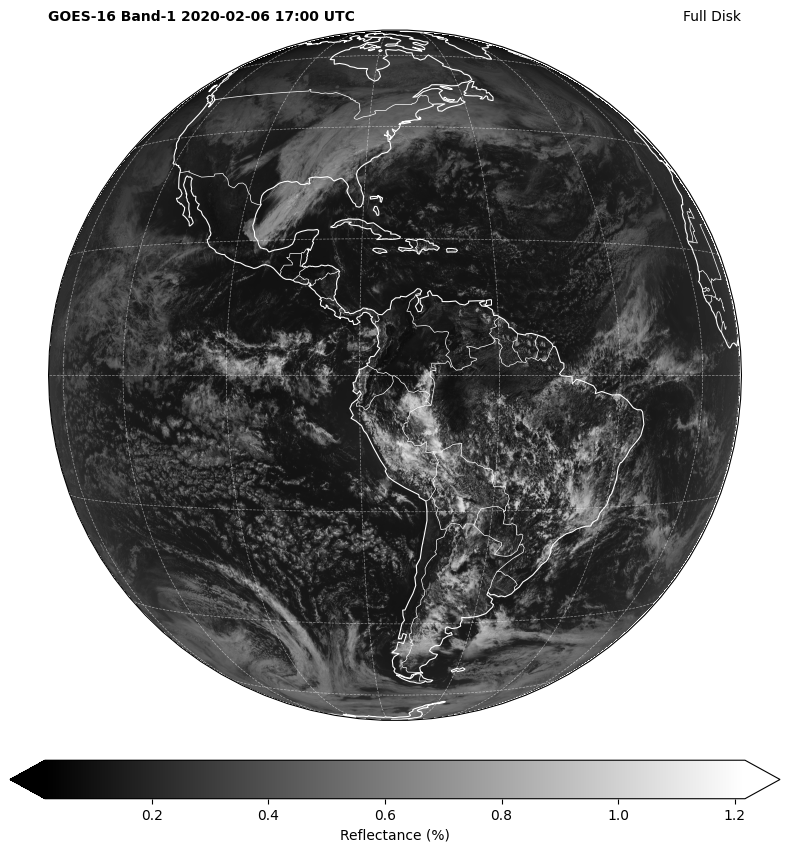

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Training: Python and GOES-R Imagery: Script 9 - Downloading data from AWS
# Author: Diego Souza (DISSM/CGCT/INPE)
#-----------------------------------------------------------------------------------------------------------
# Required modules
from netCDF4 import Dataset          # Read / Write NetCDF4 files
import matplotlib.pyplot as plt      # Plotting library
from datetime import datetime        # Basic Dates and time types
import cartopy, cartopy.crs as ccrs  # Plot maps
import os                            # Miscellaneous operating system interfaces
import boto3                         # Amazon Web Services (AWS) SDK for Python
from botocore import UNSIGNED        # boto3 config
from botocore.config import Config   # boto3 config
#-----------------------------------------------------------------------------------------------------------
# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# AMAZON repository information
# https://noaa-goes16.s3.amazonaws.com/index.html
bucket_name = 'noaa-goes16'
product_name = 'ABI-L2-CMIPF'
year = 2020
day_of_year = 37
hour = 17
min = 00
band = 1

# Initializes the S3 client
s3_client = boto3.client('s3', config=Config(signature_version=UNSIGNED))
#-----------------------------------------------------------------------------------------------------------
# File structure
prefix = f'{product_name}/{year}/{day_of_year:03.0f}/{hour:02.0f}/OR_{product_name}-M6C{band:02.0f}_G16_s{year}{day_of_year:03.0f}{hour:02.0f}{min:02.0f}'

# Seach for the file on the server
s3_result = s3_client.list_objects_v2(Bucket=bucket_name, Prefix=prefix, Delimiter = "/")
#-----------------------------------------------------------------------------------------------------------
# Check if there are files available
if 'Contents' not in s3_result:
    # There are no files
    print("No files found for the date: ",year,day_of_year)
    quit()
else:
    # There are files
    for obj in s3_result['Contents']:
        key = obj['Key']
        # Print the file name
        print(key)
        file_name = key.split('/')[-1].split('.')[0]

        # Download the file
        if not os.path.exists(f'{input}/{file_name}.nc'):
            s3_client.download_file(bucket_name, key, f'{input}/{file_name}.nc')

        # If the file exists
        if (os.path.exists(f'{input}/{file_name}.nc')):

            # Open the GOES-R image
            file = Dataset(f'{input}/{file_name}.nc')

            # Get the pixel values
            data = file.variables['CMI'][:]
            #-----------------------------------------------------------------------------------------------------------
            # Choose the plot size (width x height, in inches)
            plt.figure(figsize=(10,10))

            # Use the Geostationary projection in cartopy
            ax = plt.axes(projection=ccrs.Geostationary(central_longitude=-75.0, satellite_height=35786023.0))
            img_extent = (-5434894.67527,5434894.67527,-5434894.67527,5434894.67527)

            # Add coastlines, borders and gridlines
            ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
            ax.coastlines(resolution='110m', color='white', linewidth=0.8)
            ax.gridlines(color='white', alpha=0.5, linestyle='--', linewidth=0.5)

            # Define the color scale based on the channel
            if band <= 6:
                colormap = "gray"   # Black to white for visible channels
                prodname = "Reflectance (%)"
            else:
                colormap = "gray_r" # White to black for IR channels
                prodname = "Brightness Temperatures (°C)"

            # Plot the image
            img = ax.imshow(data, origin='upper', extent=img_extent, cmap=colormap)

            # Add a colorbar
            plt.colorbar(img, label=prodname, extend='both', orientation='horizontal', pad=0.05, fraction=0.05)

            # Extract date
            date = (datetime.strptime(file.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

            # Add a title
            plt.title('GOES-16 Band-' + str(band) + ' ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
            plt.title('Full Disk', fontsize=10, loc='right')
            #-----------------------------------------------------------------------------------------------------------
            # Save the image
            plt.savefig(f'{output}/Image_09.png')

            # Show the image
            plt.show()

#**Script 10 - Downloading Data from the Cloud - AWS (Using a Function)**

In this script we're going to perform the same operation as the previous script, but using a function, making our script more organized.

ABI-L2-CMIPF/2021/037/18/OR_ABI-L2-CMIPF-M6C13_G16_s20210371800122_e20210371809441_c20210371809524.nc


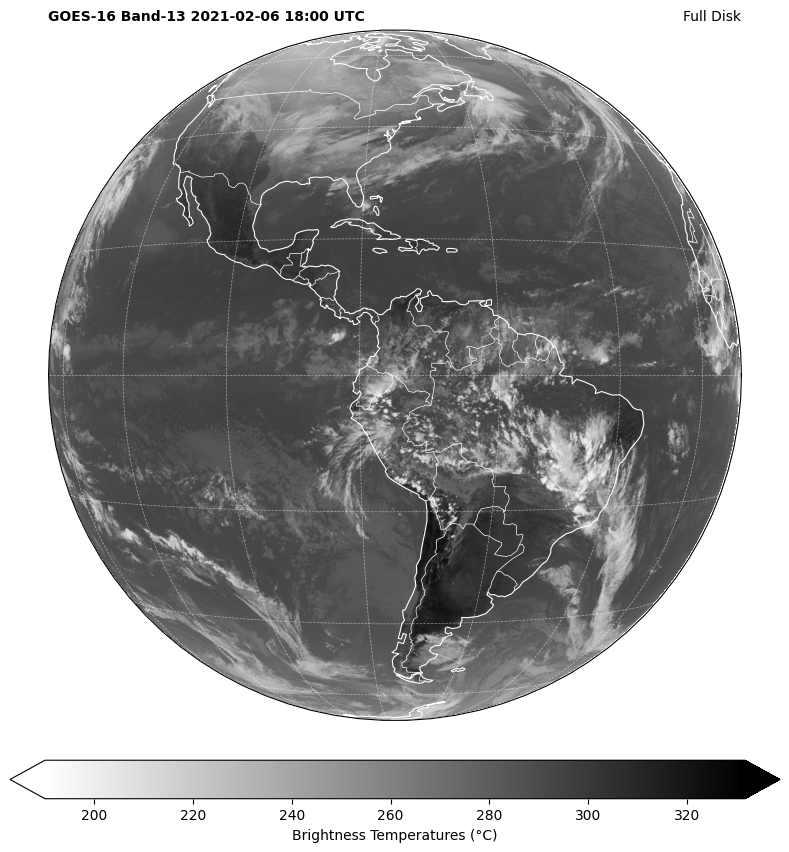

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Training: Python and GOES-R Imagery: Script 10 - Downloading data from AWS (function)
# Author: Diego Souza (DISSM/CGCT/INPE)
#-----------------------------------------------------------------------------------------------------------
# Required modules
from netCDF4 import Dataset          # Read / Write NetCDF4 files
import matplotlib.pyplot as plt      # Plotting library
from datetime import datetime        # Basic Dates and time types
import cartopy, cartopy.crs as ccrs  # Plot maps
import os                            # Miscellaneous operating system interfaces
import boto3                         # Amazon Web Services (AWS) SDK for Python
from botocore import UNSIGNED        # boto3 config
from botocore.config import Config   # boto3 config
#-----------------------------------------------------------------------------------------------------------
# Function to download files
def download_file(s3_client, prefix):
    # Seach for the file on the server
    s3_result = s3_client.list_objects_v2(Bucket=bucket_name, Prefix=prefix, Delimiter = "/")
    # Check if there are files available
    if 'Contents' not in s3_result:
        # There are no files
        print("No files found for the date: ",year,day_of_year)
        quit()
    else:
        # There are files
        for obj in s3_result['Contents']:
            # Print the file name
            key = obj['Key']
            print(key)
            file_name = key.split('/')[-1].split('.')[0]

            # Download the file
            if not os.path.exists(f'{input}/{file_name}.nc'):
                s3_client.download_file(bucket_name, key, f'{input}/{file_name}.nc')

    return file_name
#-----------------------------------------------------------------------------------------------------------
# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# AMAZON repository information
# https://noaa-goes16.s3.amazonaws.com/index.html
bucket_name = 'noaa-goes16'
product_name = 'ABI-L2-CMIPF'
year = 2021
day_of_year = 37
hour = 18
min = 00
band = 13

# Initializes the S3 client
s3_client = boto3.client('s3', config=Config(signature_version=UNSIGNED))
#-----------------------------------------------------------------------------------------------------------
# File structure
prefix = f'{product_name}/{year}/{day_of_year:03.0f}/{hour:02.0f}/OR_{product_name}-M6C{band:02.0f}_G16_s{year}{day_of_year:03.0f}{hour:02.0f}{min:02.0f}'

# Download the file
file_name = download_file(s3_client, prefix)
#-----------------------------------------------------------------------------------------------------------
# Open the GOES-R image
file = Dataset(f'{input}/{file_name}.nc')

# Get the pixel values
data = file.variables['CMI'][:]
#-----------------------------------------------------------------------------------------------------------
# Choose the plot size (width x height, in inches)
plt.figure(figsize=(10,10))

# Use the Geostationary projection in cartopy
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=-75.0, satellite_height=35786023.0))
img_extent = (-5434894.67527,5434894.67527,-5434894.67527,5434894.67527)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
ax.coastlines(resolution='110m', color='white', linewidth=0.8)
ax.gridlines(color='white', alpha=0.5, linestyle='--', linewidth=0.5)

# Define the color scale based on the channel
if band <= 6:
  colormap = "gray"   # Black to white for visible channels
  prodname = "Reflectance (%)"
else:
  colormap = "gray_r" # White to black for IR channels
  prodname = "Brightness Temperatures (°C)"

# Plot the image
img = ax.imshow(data, origin='upper', extent=img_extent, cmap=colormap)

# Add a colorbar
plt.colorbar(img, label=prodname, extend='both', orientation='horizontal', pad=0.05, fraction=0.05)

# Extract date
date = (datetime.strptime(file.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title('GOES-16 Band-' + str(band) + ' ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')
#-----------------------------------------------------------------------------------------------------------
# Save the image
plt.savefig(f'{output}/Image_10.png')

# Show the image
plt.show()

#**Script 11: Downloading Data from the Cloud - AWS (Importing a Function  from "utilities.py")**

In this script we're going to do the same operation as in the previous two scripts, but we're going to call the downloading function from an external file, making our script even cleaner and modular.

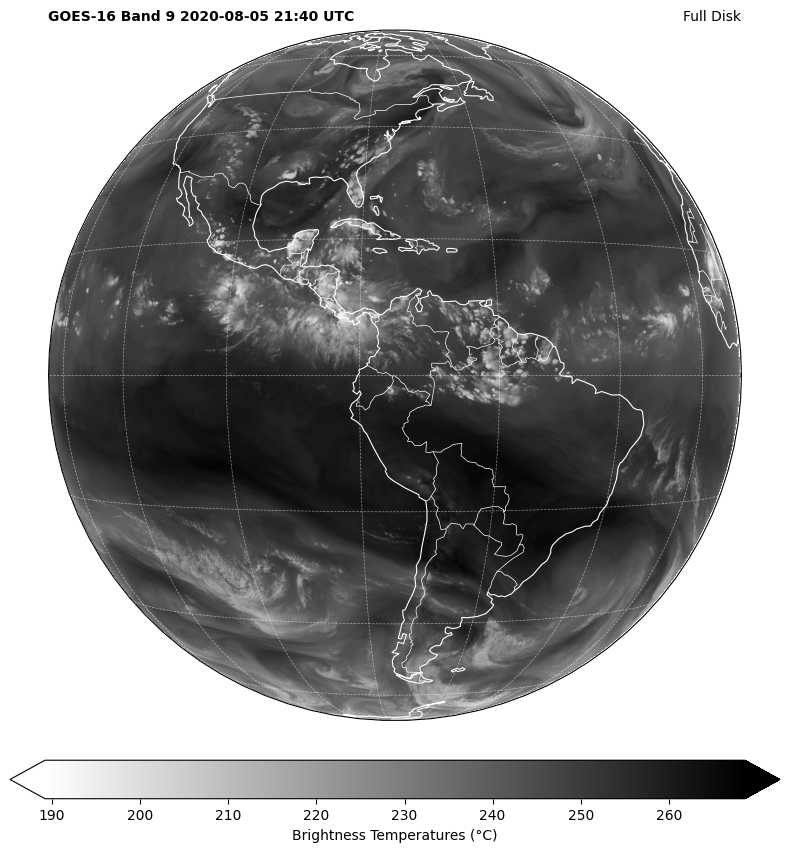

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Training: Python and GOES-R Imagery: Script 11 - Downloading data from AWS import function
# Author: Diego Souza (DISSM/CGCT/INPE)
#-----------------------------------------------------------------------------------------------------------
# Required modules
from netCDF4 import Dataset              # Read / Write NetCDF4 files
import matplotlib.pyplot as plt          # Plotting library
from datetime import datetime            # Basic Dates and time types
import cartopy, cartopy.crs as ccrs      # Plot maps
import os                                # Miscellaneous operating system interfaces
from utilities import download_CMI       # Our own utilities

#-----------------------------------------------------------------------------------------------------------
# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# Datetime to process
yyyymmddhhmn = '202008052140'
band = '9'

# Download the file
file_name = download_CMI(yyyymmddhhmn, band, input)

#-----------------------------------------------------------------------------------------------------------
# Open the GOES-R image
file = Dataset(f'{input}/{file_name}.nc')

# Get the pixel values
data = file.variables['CMI'][:]
#-----------------------------------------------------------------------------------------------------------
# Choose the plot size (width x height, in inches)
plt.figure(figsize=(10,10))

# Use the Geostationary projection in cartopy
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=-75.0, satellite_height=35786023.0))
img_extent = (-5434894.67527,5434894.67527,-5434894.67527,5434894.67527)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
ax.coastlines(resolution='110m', color='white', linewidth=0.8)
ax.gridlines(color='white', alpha=0.5, linestyle='--', linewidth=0.5)

# Define the color scale based on the channel
colormap = "gray_r" # White to black for IR channels

# Plot the image
img = ax.imshow(data, origin='upper', extent=img_extent, cmap=colormap)

# Add a colorbar
plt.colorbar(img, label='Brightness Temperatures (°C)', extend='both', orientation='horizontal', pad=0.05, fraction=0.05)

# Extract date
date = (datetime.strptime(file.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title('GOES-16 Band 9 ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')
#-----------------------------------------------------------------------------------------------------------
# Save the image
plt.savefig(f'{output}/Image_11.png')

# Show the image
plt.show()

#**Script 12: Cropping a Full Disk Image**

We don't always want to plot the entire footprint (or "Full Disk" as it's known). The script below demonstrates how to plot a specific region within the GOES-16 footprint. The functions used to correlate the coordinates with rows and columns are also called from the "utilities.py" script.

File /content/Samples/OR_ABI-L2-CMIPF-M6C13_G16_s20202181500215_e20202181509535_c20202181510021.nc exists


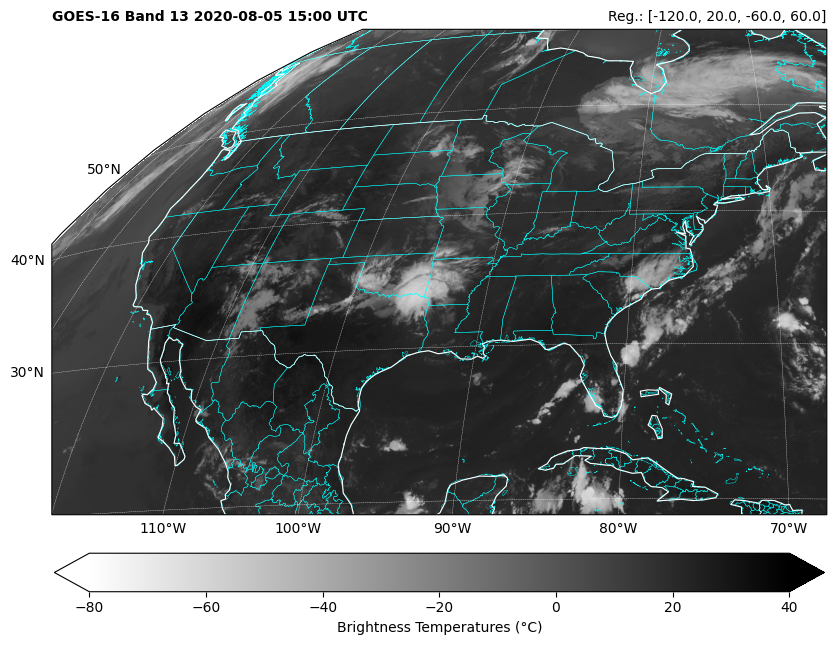

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Training: Python and GOES-R Imagery: Script 12 - Cropping the Full Disk
# Author: Diego Souza (DISSM/CGCT/INPE)
#-----------------------------------------------------------------------------------------------------------
# Required modules
from netCDF4 import Dataset                # Read / Write NetCDF4 files
import matplotlib.pyplot as plt            # Plotting library
from datetime import datetime              # Basic Dates and time types
import cartopy, cartopy.crs as ccrs        # Plot maps
import cartopy.io.shapereader as shpreader # Import shapefiles
import os                                  # Miscellaneous operating system interfaces
import numpy as np                         # Import the Numpy package
from utilities import download_CMI         # Our own utilities
from utilities import geo2grid, latlon2xy, convertExtent2GOESProjection      # Our own utilities
#-----------------------------------------------------------------------------------------------------------
# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# Desired extent
extent = [-120.0, 20.0, -60.0, 60.0] # Min lon, Min lat, Max lon, Max lat

# Datetime to process
yyyymmddhhmn = '202008051500'
band = '13'

# Download the file
file_name = download_CMI(yyyymmddhhmn, band, input)

#-----------------------------------------------------------------------------------------------------------
# Open the GOES-R image
file = Dataset(f'{input}/{file_name}.nc')

# Convert lat/lon to grid-coordinates
lly, llx = geo2grid(extent[1], extent[0], file)
ury, urx = geo2grid(extent[3], extent[2], file)

# Get the pixel values
data = file.variables['CMI'][ury:lly, llx:urx] - 273.15
#-----------------------------------------------------------------------------------------------------------
# Compute data-extent in GOES projection-coordinates
img_extent = convertExtent2GOESProjection(extent)
#-----------------------------------------------------------------------------------------------------------
# Choose the plot size (width x height, in inches)
plt.figure(figsize=(10,10))

# Use the Geostationary projection in cartopy
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=-75.0, satellite_height=35786023.0))

# Define the color scale based on the channel
colormap = "gray_r" # White to black for IR channels

# Plot the image
img = ax.imshow(data,  vmin=-80, vmax=40, origin='upper', extent=img_extent, cmap=colormap)

# Add a shapefile
shapefile = list(shpreader.Reader('/content/ne_10m_admin_1_states_provinces.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='cyan',facecolor='none', linewidth=0.3)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
ax.coastlines(resolution='110m', color='white', linewidth=0.8)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='white', alpha=1.0, linestyle='--', linewidth=0.25,
                  xlocs=np.arange(-180, 180, 10), ylocs=np.arange(-90, 90, 10), draw_labels=True)
gl.top_labels = False
gl.right_labels = False

# Add a colorbar
plt.colorbar(img, label='Brightness Temperatures (°C)', extend='both', orientation='horizontal', pad=0.05, fraction=0.05)

# Extract date
date = (datetime.strptime(file.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title('GOES-16 Band 13 ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Reg.: ' + str(extent) , fontsize=10, loc='right')
#-----------------------------------------------------------------------------------------------------------
# Save the image
plt.savefig(f'{output}/Image_12.png', bbox_inches='tight', pad_inches=0, dpi=300)

# Show the image
plt.show()

#**Script 13: Cropping a Full Disk Image and Creating an RGB Composite**

In this script we're also going to create a regional plot, but as an RGB composite (similar to the Airmass example) - called the "Day Cloud Phase Distinction RGB", using the following "recipe", obtained from: https://rammb.cira.colostate.edu/training/visit/quick_guides/QuickGuide_DayCloudPhaseDistinction_final_v2.pdf

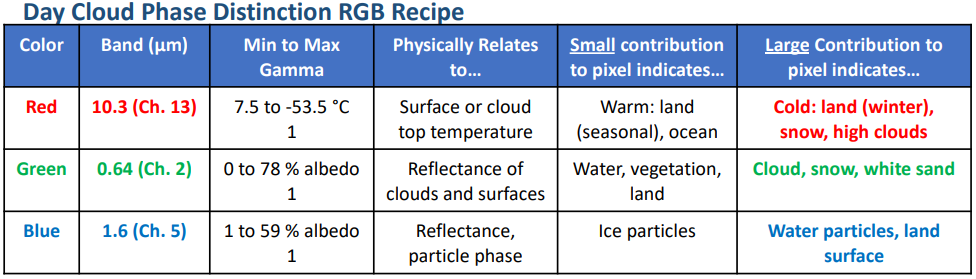

File /content/Samples/OR_ABI-L2-CMIPF-M6C13_G16_s20202181500215_e20202181509535_c20202181510021.nc exists
File /content/Samples/OR_ABI-L2-CMIPF-M6C02_G16_s20202181500215_e20202181509523_c20202181509592.nc exists
File /content/Samples/OR_ABI-L2-CMIPF-M6C05_G16_s20202181500215_e20202181509523_c20202181509597.nc exists


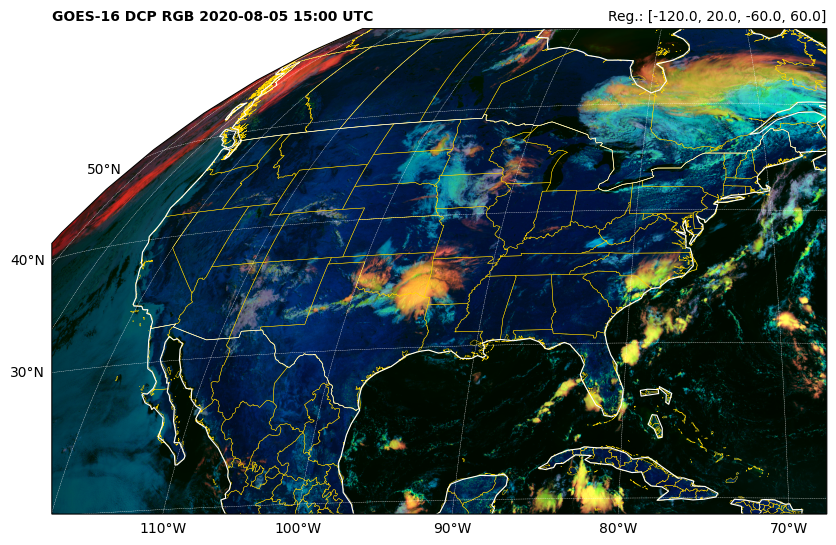

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Training: Python and GOES-R Imagery: Script 13 - Cropping the Full Disk and Creating an RGB
# Author: Diego Souza (DISSM/CGCT/INPE)
#-----------------------------------------------------------------------------------------------------------
# Required modules
from netCDF4 import Dataset                # Read / Write NetCDF4 files
import matplotlib.pyplot as plt            # Plotting library
from datetime import datetime              # Basic Dates and time types
import cartopy, cartopy.crs as ccrs        # Plot maps
import cartopy.io.shapereader as shpreader # Import shapefiles
import numpy as np                         # Scientific computing with Python
import os                                  # Miscellaneous operating system interfaces
from utilities import download_CMI         # Our own utilities
from utilities import geo2grid, latlon2xy, convertExtent2GOESProjection      # Our own utilities
#-----------------------------------------------------------------------------------------------------------
# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# Datetime to process
yyyymmddhhmn = '202008051500'

# Desired extent
extent = [-120.0, 20.0, -60.0, 60.0] # Min lon, Min lat, Max lon, Max lat

#-----------------------------------------------------------------------------------------------------------
# Download the necessary bands from AWS
file_ch13 = download_CMI(yyyymmddhhmn, 13, input)
file_ch02 = download_CMI(yyyymmddhhmn, 2, input)
file_ch05 = download_CMI(yyyymmddhhmn, 5, input)
#-----------------------------------------------------------------------------------------------------------
# Open the GOES-R images
file_ch13 = Dataset(f'{input}/{file_ch13}.nc')
file_ch02 = Dataset(f'{input}/{file_ch02}.nc')
file_ch05 = Dataset(f'{input}/{file_ch05}.nc')
#-----------------------------------------------------------------------------------------------------------
# Convert lat/lon to grid-coordinates
lly, llx = geo2grid(extent[1], extent[0], file_ch13)
ury, urx = geo2grid(extent[3], extent[2], file_ch13)

# Get the pixel values
data_ch13 = file_ch13.variables['CMI'][ury:lly, llx:urx] - 273.15
#-----------------------------------------------------------------------------------------------------------
# Convert lat/lon to grid-coordinates
lly, llx = geo2grid(extent[1], extent[0], file_ch02)
ury, urx = geo2grid(extent[3], extent[2], file_ch02)

# Get the pixel values
data_ch02 = file_ch02.variables['CMI'][ury:lly, llx:urx][::4 ,::4]
#-----------------------------------------------------------------------------------------------------------
# Convert lat/lon to grid-coordinates
lly, llx = geo2grid(extent[1], extent[0], file_ch05)
ury, urx = geo2grid(extent[3], extent[2], file_ch05)

# Get the pixel values
data_ch05 = file_ch05.variables['CMI'][ury:lly, llx:urx][::2 ,::2]
#-----------------------------------------------------------------------------------------------------------
# Make the arrays equal size
cordX = np.shape(data_ch02)[0], np.shape(data_ch05)[0], np.shape(data_ch13)[0]
cordY = np.shape(data_ch02)[1], np.shape(data_ch05)[1], np.shape(data_ch13)[1]

minvalX = np.array(cordX).min()
minvalY = np.array(cordY).min()

data_ch02 = data_ch02[0:minvalX, 0:minvalY]
data_ch05 = data_ch05[0:minvalX, 0:minvalY]
data_ch13 = data_ch13[0:minvalX, 0:minvalY]
#-----------------------------------------------------------------------------------------------------------
# Compute data-extent in GOES projection-coordinates
img_extent = convertExtent2GOESProjection(extent)
#-----------------------------------------------------------------------------------------------------------
# RGB Quick Guide: http://rammb.cira.colostate.edu/training/visit/quick_guides/QuickGuide_DayCloudConvectionRGB_final.pdf

# RGB Components
R = data_ch13
G = data_ch02
B = data_ch05

# Minimuns and Maximuns
Rmin = -53.5
Rmax = 7.5

Gmin = 0.0
Gmax = 0.78

Bmin = 0.01
Bmax = 0.59

R[R<Rmin] = Rmin
R[R>Rmax] = Rmax

G[G<Gmin] = Gmin
G[G>Gmax] = Gmax

B[B<Bmin] = Bmin
B[B>Bmax] = Bmax

# Choose the gamma
gamma = 1

# Normalize the data
R = ((R - Rmax) / (Rmin - Rmax)) ** (1/gamma)
G = ((G - Gmin) / (Gmax - Gmin)) ** (1/gamma)
B = ((B - Bmin) / (Bmax - Bmin)) ** (1/gamma)

# Create the RGB
RGB = np.stack([R, G, B], axis=2)
#-----------------------------------------------------------------------------------------------------------
# Choose the plot size (width x height, in inches)
plt.figure(figsize=(10,10))

# Use the Geostationary projection in cartopy
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=-75.0, satellite_height=35786023.0))

# Plot the image
img = ax.imshow(RGB, origin='upper', extent=img_extent)

# Add a shapefile
shapefile = list(shpreader.Reader('/content/ne_10m_admin_1_states_provinces.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='gold',facecolor='none', linewidth=0.3)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
ax.coastlines(resolution='110m', color='white', linewidth=0.8)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='white', alpha=1.0, linestyle='--', linewidth=0.25,
                  xlocs=np.arange(-180, 180, 10), ylocs=np.arange(-90, 90, 10), draw_labels=True)
gl.top_labels = False
gl.right_labels = False

# Extract date
date = (datetime.strptime(file_ch13.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title('GOES-16 DCP RGB ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Reg.: ' + str(extent) , fontsize=10, loc='right')
#-----------------------------------------------------------------------------------------------------------
# Save the image
plt.savefig(f'{output}/Image_13.png', bbox_inches='tight', pad_inches=0, dpi=300)

# Show the image
plt.show()

#**Script 14: Reprojection with GDAL**

So far we have manipulated GOES-R data without modifying its original  projection ("geos" projection, as it is known). In this example, we will change the projection of the data to the "equidistant cylindrical" projection, using the famous "GDAL" (Geospatial Data Abstraction) library.

File /content/Samples/OR_ABI-L2-CMIPF-M6C13_G16_s20202181500215_e20202181509535_c20202181510021.nc exists
(<osgeo.gdal.GDALWarpAppOptions; proxy of <Swig Object of type 'GDALWarpAppOptions *' at 0x7a3461e2b9f0> >, None, None)


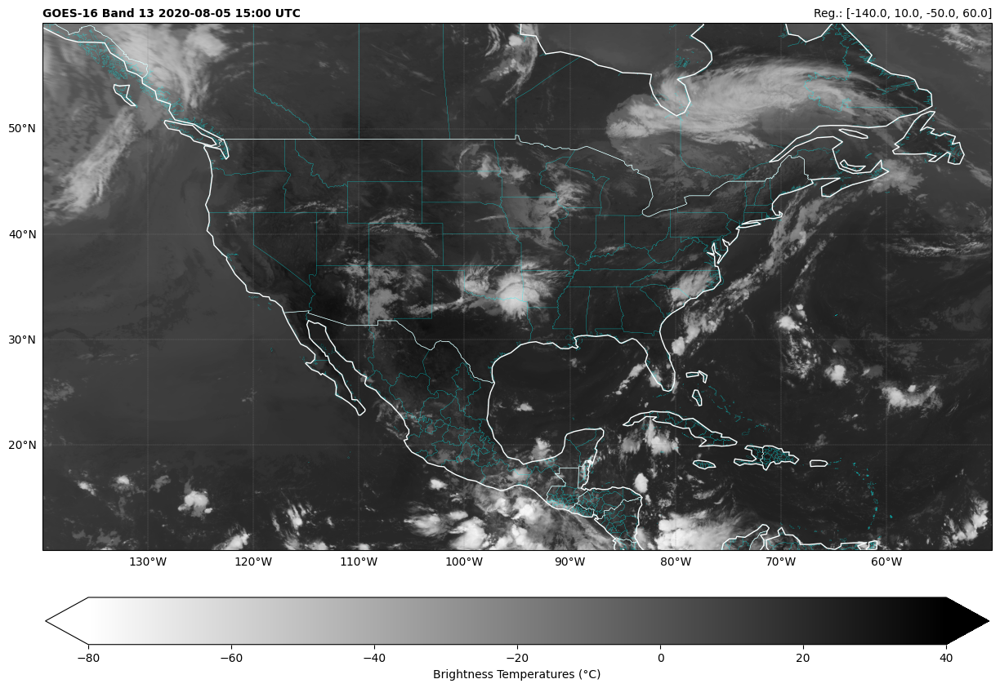

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Training: Python and GOES-R Imagery: Script 14 - Reprojection with GDAL
# Author: Diego Souza (DISSM/CGCT/INPE)
#-----------------------------------------------------------------------------------------------------------
# Required modules
from netCDF4 import Dataset                # Read / Write NetCDF4 files
import matplotlib.pyplot as plt            # Plotting library
from datetime import datetime              # Basic Dates and time types
import cartopy, cartopy.crs as ccrs        # Plot maps
import cartopy.io.shapereader as shpreader # Import shapefiles
import os                                  # Miscellaneous operating system interfaces
from osgeo import osr                      # Python bindings for GDAL
from osgeo import gdal                     # Python bindings for GDAL
import numpy as np                         # Scientific computing with Python
from utilities import download_CMI         # Our function for download

#-----------------------------------------------------------------------------------------------------------
# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# Desired extent
extent = [-140.0, 10.0, -50.0, 60.0] # Min lon, Min lat, Max lon, Max lat

# Datetime to process
yyyymmddhhmn = '202008051500'
band = '13'

# Download the file
file_name = download_CMI(yyyymmddhhmn, band, input)

#-----------------------------------------------------------------------------------------------------------
# Variable
var = 'CMI'

# Open the file
img = gdal.Open(f'NETCDF:{input}/{file_name}.nc:' + var)

# Read the header metadata
metadata = img.GetMetadata()
scale = float(metadata.get(var + '#scale_factor'))
offset = float(metadata.get(var + '#add_offset'))
undef = float(metadata.get(var + '#_FillValue'))
dtime = metadata.get('NC_GLOBAL#time_coverage_start')

# Load the data
ds = img.ReadAsArray(0, 0, img.RasterXSize, img.RasterYSize).astype(float)

# Apply the scale, offset and convert to celsius
ds = (ds * scale + offset) - 273.15

# Read the original file projection and configure the output projection
source_prj = osr.SpatialReference()
source_prj.ImportFromProj4(img.GetProjectionRef())

target_prj = osr.SpatialReference()
target_prj.ImportFromProj4("+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs")

# Reproject the data
GeoT = img.GetGeoTransform()
driver = gdal.GetDriverByName('MEM')
raw = driver.Create('raw', ds.shape[0], ds.shape[1], 1, gdal.GDT_Float32)
raw.SetGeoTransform(GeoT)
raw.GetRasterBand(1).WriteArray(ds)

# Define the parameters of the output file
options = gdal.WarpOptions(format = 'netCDF',
          srcSRS = source_prj,
          dstSRS = target_prj,
          outputBounds = (extent[0], extent[3], extent[2], extent[1]),
          outputBoundsSRS = target_prj,
          outputType = gdal.GDT_Float32,
          srcNodata = undef,
          dstNodata = 'nan',
          xRes = 0.02,
          yRes = 0.02,
          resampleAlg = gdal.GRA_NearestNeighbour)

print(options)

# Write the reprojected file on disk
gdal.Warp(f'{output}/{file_name}_ret.nc', raw, options=options)
#-----------------------------------------------------------------------------------------------------------
# Open the reprojected GOES-R image
file = Dataset(f'{output}/{file_name}_ret.nc')

# Get the pixel values
data = file.variables['Band1'][:]
#-----------------------------------------------------------------------------------------------------------
# Choose the plot size (width x height, in inches)
plt.figure(figsize=(15,15))

# Use the Geostationary projection in cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define the image extent
img_extent = [extent[0], extent[2], extent[1], extent[3]]

# Define the color scale based on the channel
colormap = "gray_r" # White to black for IR channels

# Plot the image
img = ax.imshow(data, origin='upper', vmin=-80, vmax=40, extent=img_extent, cmap=colormap)

# Add a shapefile
shapefile = list(shpreader.Reader('/content/ne_10m_admin_1_states_provinces.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='cyan',facecolor='none', linewidth=0.1)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
ax.coastlines(resolution='110m', color='white', linewidth=1.0)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--', linewidth=0.25,
                  xlocs=np.arange(-180, 180, 10), ylocs=np.arange(-90, 90, 10), draw_labels=True)
gl.top_labels = False
gl.right_labels = False

# Add a colorbar
plt.colorbar(img, label='Brightness Temperatures (°C)', extend='both', orientation='horizontal', pad=0.05, fraction=0.05)

# Extract date
date = (datetime.strptime(dtime, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title('GOES-16 Band 13 ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Reg.: ' + str(extent) , fontsize=10, loc='right')
#-----------------------------------------------------------------------------------------------------------
# Save the image
plt.savefig(f'{output}/Image_14.png', bbox_inches='tight', pad_inches=0, dpi=300)

# Show the image
plt.show()

#**Script 15: Level 2 Products (SST) and Data Quality Flags (DQF)**

So far we have manipulated data from the individual GOES-16 channels to create plots of these bands or RGB composites. In this example, we're going to plot one of the GOES-R derived products (Sea Surface Temperature in this case). We'll see how to read the data quality flags and disregard pixels depending on the flag values. You can find more information about GOES-16 derived products at the following link: https://www.goes-r.gov/products/overview.html

File /content/Samples/OR_ABI-L2-SSTF-M6_G16_s20210491800058_e20210491859366_c20210491905272.nc exists


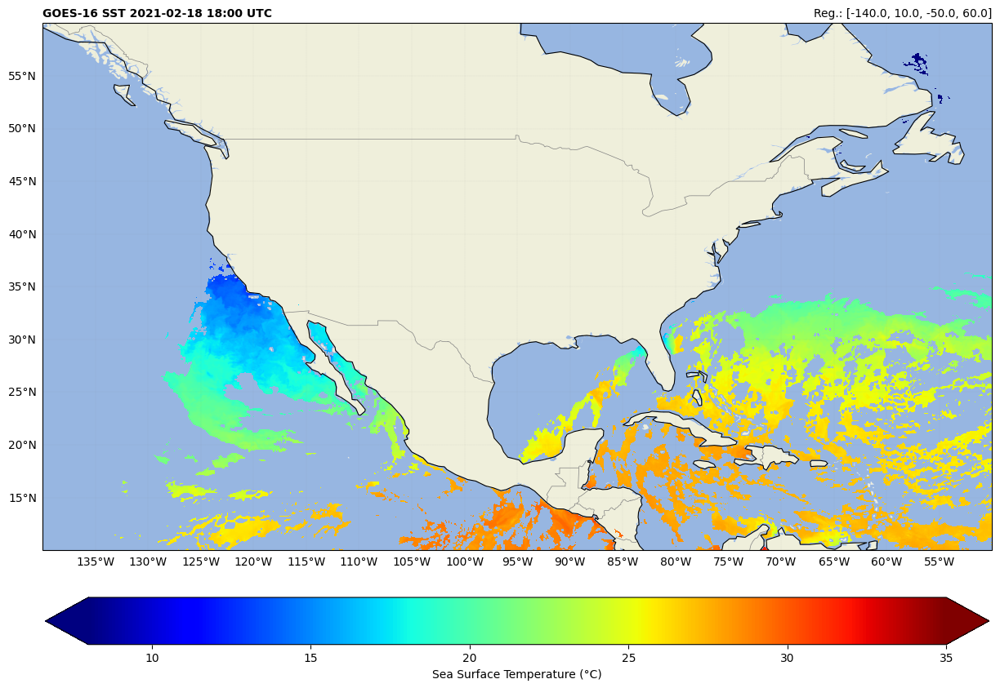

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Training: Python and GOES-R Imagery: Script 15 - Level 2 Products (SST) and Data Quality Flags
# Author: Diego Souza (DISSM/CGCT/INPE)
#-----------------------------------------------------------------------------------------------------------
# Required modules
from netCDF4 import Dataset                     # Read / Write NetCDF4 files
import matplotlib.pyplot as plt                 # Plotting library
from datetime import datetime                   # Basic Dates and time types
import cartopy, cartopy.crs as ccrs             # Plot maps
import cartopy.feature as cfeature              # Common drawing and filtering operations
import os                                       # Miscellaneous operating system interfaces
from osgeo import gdal                          # Python bindings for GDAL
import numpy as np                              # Scientific computing with Python
from utilities import download_PROD             # Our function for download
from utilities import reproject                 # Our function for reproject
gdal.PushErrorHandler('CPLQuietErrorHandler')   # Ignore GDAL warnings
#-----------------------------------------------------------------------------------------------------------

#-----------------------------------------------------------------------------------------------------------
# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# Desired extent
extent = [-140.0, 10.0, -50.0, 60.0] # Min lon, Min lat, Max lon, Max lat

# Parameters to process
yyyymmddhhmn = '202102181800'
product_name = 'ABI-L2-SSTF'

# Download the file
file_name = download_PROD(yyyymmddhhmn, product_name, input)

#-----------------------------------------------------------------------------------------------------------
# Variable
var = 'SST'

# Open the file
img = gdal.Open(f'NETCDF:{input}/{file_name}.nc:' + var)

# Data Quality Flag (DQF)
dqf = gdal.Open(f'NETCDF:{input}/{file_name}.nc:DQF')

# Read the header metadata
metadata = img.GetMetadata()
scale = float(metadata.get(var + '#scale_factor'))
offset = float(metadata.get(var + '#add_offset'))
undef = float(metadata.get(var + '#_FillValue'))
dtime = metadata.get('NC_GLOBAL#time_coverage_start')

# Load the data
ds = img.ReadAsArray(0, 0, img.RasterXSize, img.RasterYSize).astype(float)
ds_dqf = dqf.ReadAsArray(0, 0, dqf.RasterXSize, dqf.RasterYSize).astype(float)

# Apply the scale, offset and convert to celsius
ds = (ds * scale + offset) - 273.15

# Apply NaN's where the quality flag is greater than 1
ds[ds_dqf > 1] = np.nan

# Reproject the file
filename_ds = f'{output}/{file_name}_ret.nc'
reproject(filename_ds, img, ds, extent, undef)

#-----------------------------------------------------------------------------------------------------------
# Open the reprojected GOES-R image
file = Dataset(filename_ds)

# Get the pixel values
data = file.variables['Band1'][:]
#-----------------------------------------------------------------------------------------------------------
# Choose the plot size (width x height, in inches)
plt.figure(figsize=(15,15))

# Use the Geostationary projection in cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define the image extent
img_extent = [extent[0], extent[2], extent[1], extent[3]]

# Plot the image
img = ax.imshow(data, vmin=8, vmax=35, cmap='jet', origin='upper', extent=img_extent)

# Add some map elements to the plot
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='gray', linewidth=0.5)
ax.coastlines(resolution='110m', color='black', linewidth=0.8)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=0.5, linestyle='--', linewidth=0.1,
                  xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5), draw_labels=True)
gl.top_labels = False
gl.right_labels = False

# Add a colorbar
plt.colorbar(img, label='Sea Surface Temperature (°C)', extend='both', orientation='horizontal', pad=0.05, fraction=0.05)

# Extract date
date = (datetime.strptime(dtime, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title('GOES-16 SST ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Reg.: ' + str(extent) , fontsize=10, loc='right')
#-----------------------------------------------------------------------------------------------------------
# Save the image
plt.savefig(f'{output}/Image_15.png', bbox_inches='tight', pad_inches=0, dpi=300)

# Show the image
plt.show()

#**Script 16: Level 2 Products (SST) and Daily Average**

In the previous example, we saw how to plot SST data for a specific time, and this product is generated every hour. In the following example, we're going to read 24 hourly samples for a given day, and we're average this information on a daily basis.

In [ ]:
# @title
from IPython.core.display import HTML
HTML("""
<div class="alert">
  <p><b>Warning:</b> This script downloads and processes many files, so it takes a while to finish.</p>
</div>

<style>
.alert {
  padding: 20px;
  background-color: #d9edf7;
  color: #3170B1;
  margin-bottom: 15px;
  font-size: 20px;
}
</style>
""")

File /content/Samples/OR_ABI-L2-SSTF-M6_G16_s20210490000062_e20210490059370_c20210490105234.nc exists
File /content/Samples/OR_ABI-L2-SSTF-M6_G16_s20210490100062_e20210490159369_c20210490205169.nc exists
File /content/Samples/OR_ABI-L2-SSTF-M6_G16_s20210490200061_e20210490259369_c20210490305158.nc exists
File /content/Samples/OR_ABI-L2-SSTF-M6_G16_s20210490300061_e20210490359369_c20210490405221.nc exists
File /content/Samples/OR_ABI-L2-SSTF-M6_G16_s20210490400061_e20210490459369_c20210490505226.nc exists
File /content/Samples/OR_ABI-L2-SSTF-M6_G16_s20210490500061_e20210490559371_c20210490605186.nc exists
File /content/Samples/OR_ABI-L2-SSTF-M6_G16_s20210490600063_e20210490659371_c20210490705162.nc exists
File /content/Samples/OR_ABI-L2-SSTF-M6_G16_s20210490700063_e20210490759370_c20210490805213.nc exists
File /content/Samples/OR_ABI-L2-SSTF-M6_G16_s20210490800062_e20210490859370_c20210490905185.nc exists
File /content/Samples/OR_ABI-L2-SSTF-M6_G16_s20210490900062_e20210490959370_c20210

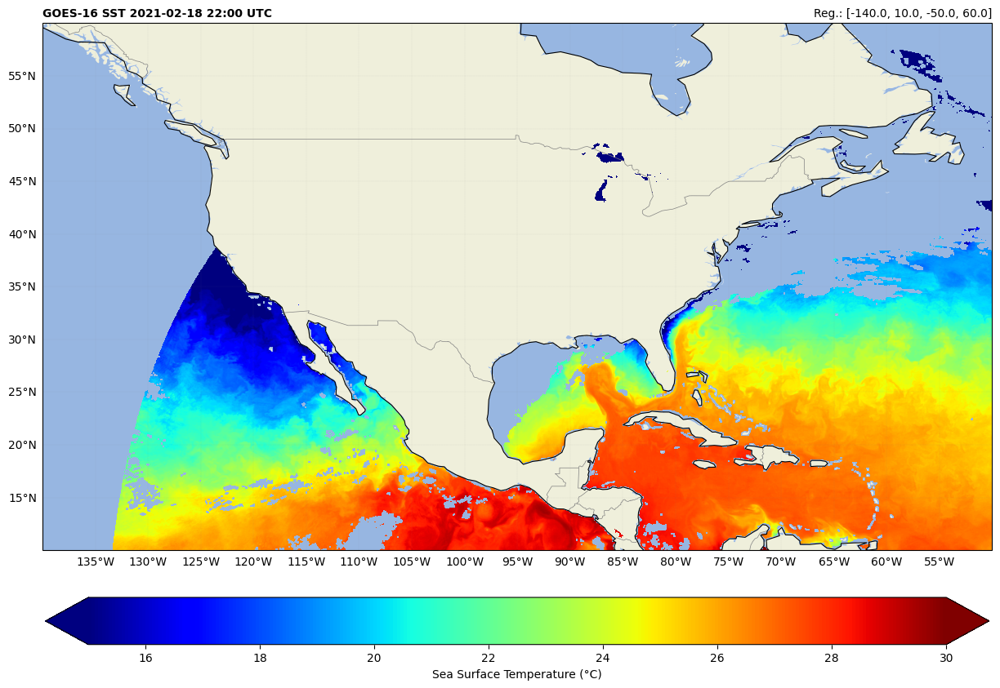

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Training: Python and GOES-R Imagery: Script 16 - Level 2 Products (SST) and Average
# Author: Diego Souza (DISSM/CGCT/INPE)
#-----------------------------------------------------------------------------------------------------------
# Required modules
from netCDF4 import Dataset                     # Read / Write NetCDF4 files
import matplotlib.pyplot as plt                 # Plotting library
from datetime import datetime                   # Basic Dates and time types
import cartopy, cartopy.crs as ccrs             # Plot maps
import cartopy.feature as cfeature              # Common drawing and filtering operations
import os                                       # Miscellaneous operating system interfaces
from osgeo import gdal                          # Python bindings for GDAL
import numpy as np                              # Scientific computing with Python
from utilities import download_PROD             # Our function for download
from utilities import reproject                 # Our function for reproject
gdal.PushErrorHandler('CPLQuietErrorHandler')   # Ignore GDAL warnings

#-----------------------------------------------------------------------------------------------------------
# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# Parameters to process
yyyymmdd = '20210218'
product_name = 'ABI-L2-SSTF'

# Desired extent
extent = [-140.0, 10.0, -50.0, 60.0] # Min lon, Min lat, Max lon, Max lat

########################################################################
# Sea Surface Temperature - "X" Hours
########################################################################

sum_ds = np.zeros((5424,5424))
count_ds = np.zeros((5424,5424))
#-----------------------------------------------------------------------------------------------------------
for hour in np.arange(0,23,1):

    # Date structure
    yyyymmddhhmn = f'{yyyymmdd}{hour:02.0f}00'

    # Download the file
    file_name = download_PROD(yyyymmddhhmn, product_name, input)
    #-----------------------------------------------------------------------------------------------------------
    # Variable
    var = 'SST'

    # Open the GOES-R image
    file = Dataset(f'{input}/{file_name}.nc')

    # Open the file
    img = gdal.Open(f'NETCDF:{input}/{file_name}.nc:' + var)

    # Data Quality Flag (DQF)
    dqf = gdal.Open(f'NETCDF:{input}/{file_name}.nc:DQF')

    # Read the header metadata
    metadata = img.GetMetadata()
    scale = float(metadata.get(var + '#scale_factor'))
    offset = float(metadata.get(var + '#add_offset'))
    undef = float(metadata.get(var + '#_FillValue'))
    dtime = metadata.get('NC_GLOBAL#time_coverage_start')

    # Load the data
    ds = img.ReadAsArray(0, 0, img.RasterXSize, img.RasterYSize).astype(float)
    ds_dqf = dqf.ReadAsArray(0, 0, dqf.RasterXSize, dqf.RasterYSize).astype(float)

    # Apply the scale, offset and convert to celsius
    ds = (ds * scale + offset) - 273.15

    # Apply NaN's where the quality flag is greater than 1
    ds[ds_dqf > 1] = np.nan

    # Calculate the sum
    sum_ds = np.nansum(np.dstack((sum_ds,ds)),2)
    count_ds = np.nansum(np.dstack((count_ds,(ds/ds))),2)
    #-----------------------------------------------------------------------------------------------------------

# Calculate the sum
ds_day = np.empty((5424,5424))
ds_day[::] = np.nan
ds_day[count_ds!=0] = sum_ds[count_ds!=0]/count_ds[count_ds!=0]

#-----------------------------------------------------------------------------------------------------------
# Reproject the file
filename_ds = f'{output}/{file_name}_ret.nc'
reproject(filename_ds, img, ds_day, extent, undef)
#-----------------------------------------------------------------------------------------------------------
# Open the reprojected GOES-R image
file = Dataset(filename_ds)

# Get the pixel values
data = file.variables['Band1'][:]
#-----------------------------------------------------------------------------------------------------------
# Choose the plot size (width x height, in inches)
plt.figure(figsize=(15,15))

# Use the Geostationary projection in cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define the image extent
img_extent = [extent[0], extent[2], extent[1], extent[3]]

# Plot the image
img = ax.imshow(data, vmin=15, vmax=30, cmap='jet', origin='upper', extent=img_extent)

# Add some map elements to the plot
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='gray', linewidth=0.5)
ax.coastlines(resolution='110m', color='black', linewidth=0.8)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=0.5, linestyle='--', linewidth=0.1,
                  xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5), draw_labels=True)
gl.top_labels = False
gl.right_labels = False

# Add a colorbar
plt.colorbar(img, label='Sea Surface Temperature (°C)', extend='both', orientation='horizontal', pad=0.05, fraction=0.05)

# Extract date
date = (datetime.strptime(dtime, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title('GOES-16 SST ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Reg.: ' + str(extent) , fontsize=10, loc='right')
#-----------------------------------------------------------------------------------------------------------
# Save the image
plt.savefig(f'{output}/Image_16.png', bbox_inches='tight', pad_inches=0, dpi=300)

# Show the image
plt.show()

#**Script 17: Level 2 Products (RRQPE - Rainfall Rate) and Data Accumulation**

In this example we are going to manipulate another derived product, the rainfall rate / quantitative precipitation estimate. We're going to read samples every hour make a 24 hour accumulation. More information at:

https://www.goes-r.gov/products/baseline-rainfall-rate-qpe.html

File /content/Samples/OR_ABI-L2-RRQPEF-M6_G16_s20203511300221_e20203511309528_c20203511310017.nc exists
File /content/Samples/OR_ABI-L2-RRQPEF-M6_G16_s20203511400220_e20203511409528_c20203511410016.nc exists
File /content/Samples/OR_ABI-L2-RRQPEF-M6_G16_s20203511500220_e20203511509528_c20203511510017.nc exists
File /content/Samples/OR_ABI-L2-RRQPEF-M6_G16_s20203511600220_e20203511609528_c20203511610019.nc exists
File /content/Samples/OR_ABI-L2-RRQPEF-M6_G16_s20203511700218_e20203511709526_c20203511710014.nc exists
File /content/Samples/OR_ABI-L2-RRQPEF-M6_G16_s20203511800218_e20203511809526_c20203511810055.nc exists
File /content/Samples/OR_ABI-L2-RRQPEF-M6_G16_s20203511900218_e20203511909526_c20203511910055.nc exists
File /content/Samples/OR_ABI-L2-RRQPEF-M6_G16_s20203512000217_e20203512009525_c20203512010050.nc exists
File /content/Samples/OR_ABI-L2-RRQPEF-M6_G16_s20203512100217_e20203512109525_c20203512110016.nc exists
File /content/Samples/OR_ABI-L2-RRQPEF-M6_G16_s20203512200217_e2

<ipython-input-21-995193558796>:112: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = cm.get_cmap('rainbow', 240)


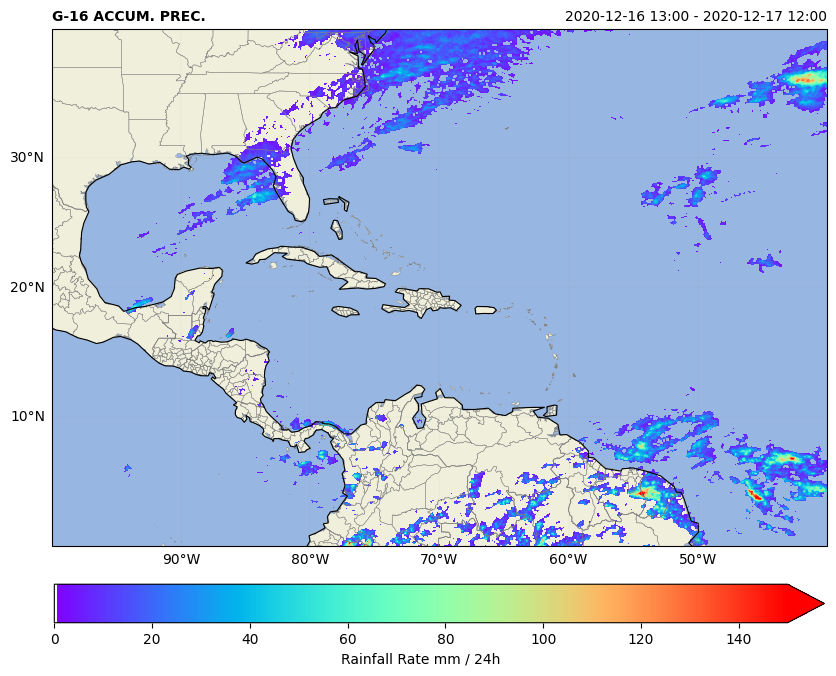

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Training: Python and GOES-R Imagery: Script 17 - Level 2 Products (RRQPE) and Data Accumulation
# Author: Diego Souza (DISSM/CGCT/INPE)
#-----------------------------------------------------------------------------------------------------------
# Required modules
from netCDF4 import Dataset                     # Read / Write NetCDF4 files
import matplotlib.pyplot as plt                 # Plotting library
from datetime import timedelta, date, datetime  # Basic Dates and time types
import cartopy, cartopy.crs as ccrs             # Plot maps
import cartopy.feature as cfeature              # Common drawing and filtering operations
import os                                       # Miscellaneous operating system interfaces
from osgeo import gdal                          # Python bindings for GDAL
import numpy as np                              # Scientific computing with Python
from matplotlib import cm                       # Colormap handling utilities
from utilities import download_PROD             # Our function for download
from utilities import reproject                 # Our function for reproject
gdal.PushErrorHandler('CPLQuietErrorHandler')   # Ignore GDAL warnings

#-----------------------------------------------------------------------------------------------------------
# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# Desired extent
extent = [-100.0, 0.00, -40.00, 40.00] # Min lon, Min lat, Max lon, Max lat

# Parameters to process
yyyymmdd = '20201217'
product_name = 'ABI-L2-RRQPEF'

########################################################################
# Rainfall Rate Quantitative Precipitation Estimation ("X" hours)
########################################################################

# Initial time and date
yyyy = datetime.strptime(yyyymmdd, '%Y%m%d').strftime('%Y')
mm = datetime.strptime(yyyymmdd, '%Y%m%d').strftime('%m')
dd = datetime.strptime(yyyymmdd, '%Y%m%d').strftime('%d')

date_ini = str(datetime(int(yyyy),int(mm),int(dd),12,0) - timedelta(hours=23))
date_end = str(datetime(int(yyyy),int(mm),int(dd),12,0))

acum = np.zeros((5424,5424))

#-----------------------------------------------------------------------------------------------------------
# Accumulation loop
while (date_ini <= date_end):

    # Date structure
    yyyymmddhhmn = datetime.strptime(date_ini, '%Y-%m-%d %H:%M:%S').strftime('%Y%m%d%H%M')

    # Download the file
    file_name = download_PROD(yyyymmddhhmn, product_name, input)
    #-----------------------------------------------------------------------------------------------------------
    # Variable
    var = 'RRQPE'

    # Open the file
    img = gdal.Open(f'NETCDF:{input}/{file_name}.nc:' + var)
    dqf = gdal.Open(f'NETCDF:{input}/{file_name}.nc:DQF')

    # Read the header metadata
    metadata = img.GetMetadata()
    scale = float(metadata.get(var + '#scale_factor'))
    offset = float(metadata.get(var + '#add_offset'))
    undef = float(metadata.get(var + '#_FillValue'))
    dtime = metadata.get('NC_GLOBAL#time_coverage_start')

    # Load the data
    ds = img.ReadAsArray(0, 0, img.RasterXSize, img.RasterYSize).astype(float)
    ds_dqf = dqf.ReadAsArray(0, 0, dqf.RasterXSize, dqf.RasterYSize).astype(float)

    # Remove undef
    ds[ds == undef] = np.nan

    # Apply the scale, offset and convert to celsius
    ds = (ds * scale + offset)

    # Apply NaN's where the quality flag is greater than 1
    ds[ds_dqf > 0] = np.nan

    # Sum the instantaneous value in the accumulation
    acum = np.nansum(np.dstack((acum, ds)),2)

    # Increment 1 hour
    date_ini = str(datetime.strptime(date_ini, '%Y-%m-%d %H:%M:%S') + timedelta(hours=1))
    #-----------------------------------------------------------------------------------------------------------

# Reproject the file
filename_acum = f'{output}/prec_acum_ret_{yyyymmddhhmn}.nc'
reproject(filename_acum, img, acum, extent, undef)
#-----------------------------------------------------------------------------------------------------------
# Open the reprojected GOES-R image
file = Dataset(filename_acum)

# Get the pixel values
data = file.variables['Band1'][:]

# Set pixels with value "0" as NaN
data[data==0] = np.nan
#-----------------------------------------------------------------------------------------------------------
# Choose the plot size (width x height, in inches)
plt.figure(figsize=(10,10))

# Use the Geostationary projection in cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define the image extent
img_extent = [extent[0], extent[2], extent[1], extent[3]]

# Modify the colormap to zero values are white
colormap = cm.get_cmap('rainbow', 240)
newcolormap = colormap(np.linspace(0, 1, 240))
newcolormap[:1, :] = np.array([1, 1, 1, 1])
cmap = cm.colors.ListedColormap(newcolormap)

# Plot the image
img = ax.imshow(data, vmin=0, vmax=150, origin='upper', extent=img_extent, cmap=cmap)

# Add a shapefile
shapefile = list(shpreader.Reader('/content/ne_10m_admin_1_states_provinces.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='gray',facecolor='none', linewidth=0.3)

# Add some map elements to the plot
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='gray', linewidth=0.5)
ax.coastlines(resolution='110m', color='black', linewidth=0.8)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=0.5, linestyle='--', linewidth=0.1,
                  xlocs=np.arange(-180, 180, 10), ylocs=np.arange(-90, 90, 10), draw_labels=True)
gl.top_labels = False
gl.right_labels = False

# Add a colorbar
plt.colorbar(img, label='Rainfall Rate mm / 24h', extend='max', orientation='horizontal', pad=0.05, fraction=0.05)

# Extract date
date = (datetime.strptime(dtime, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title('G-16 ACCUM. PREC.', fontweight='bold', fontsize=10, loc='left')
date_ini = datetime(int(yyyy),int(mm),int(dd),12,0) - timedelta(hours=23)
date_end = datetime(int(yyyy),int(mm),int(dd),12,0)
plt.title(date_ini.strftime('%Y-%m-%d %H:%M') + " - " + date_end.strftime('%Y-%m-%d %H:%M'), fontsize=10, loc='right')
#-----------------------------------------------------------------------------------------------------------
# Save the image
plt.savefig(f'{output}/Image_17.png', bbox_inches='tight', pad_inches=0, dpi=300)

# Show the image
plt.show()

#**Script 18: GLM Density**

GLM data is generated every 20 seconds, a huge amount of information. Generally, this data is not plotted every 20 seconds, but is accumulated every "x" minutes. In this example, we will accumulate GLM data over a 10-minute interval and overlay this data with the the ABI sensor (Band 13).

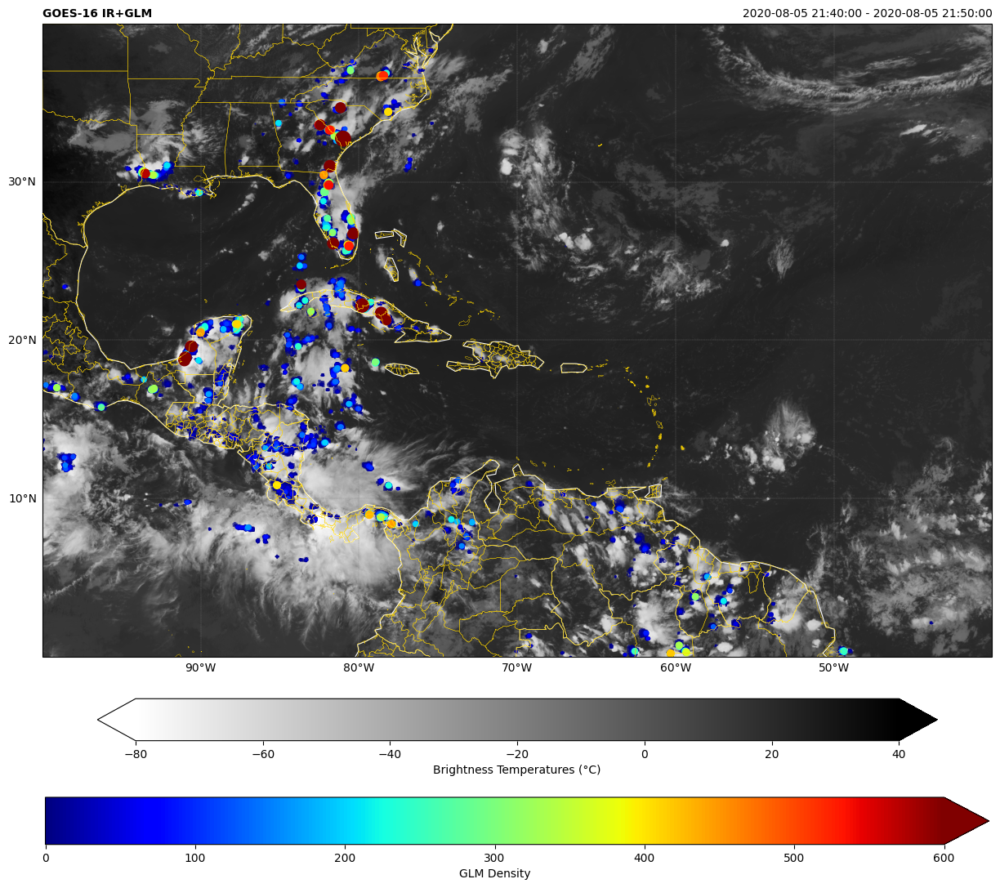

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Training: Python and GOES-R Imagery: Script 18 - GLM Density
# Author: Diego Souza (DISSM/CGCT/INPE)
#-----------------------------------------------------------------------------------------------------------
# Required modules
from netCDF4 import Dataset                         # Read / Write NetCDF4 files
import matplotlib.pyplot as plt                     # Plotting library
import cartopy, cartopy.crs as ccrs                 # Plot maps
from datetime import timedelta, date, datetime      # Basic Dates and time types
import cartopy, cartopy.crs as ccrs                 # Plot maps
import os                                           # Miscellaneous operating system interfaces
from osgeo import gdal                              # Python bindings for GDAL
import numpy as np                                  # Scientific computing with Python
from matplotlib import cm                           # Colormap handling utilities
from utilities import download_CMI, download_GLM    # Our function for download
from utilities import reproject                     # Our function for reproject
gdal.PushErrorHandler('CPLQuietErrorHandler')       # Ignore GDAL warnings
#-----------------------------------------------------------------------------------------------------------
# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# Desired extent
#extent = [-150.0, -81, 0, 81] # Min lon, Min lat, Max lon, Max lat
extent = [-100.0, 0.00, -40.00, 40.00]

# Datetime to process
yyyymmddhhmn = '202008052140'

#-----------------------------------------------------------------------------------------------------------
# Get the Band 13 Data

# Download the file
file_ir = download_CMI(yyyymmddhhmn, 13, input)
#-----------------------------------------------------------------------------------------------------------
# Variable
var = 'CMI'

# Open the file
img = gdal.Open(f'NETCDF:{input}/{file_ir}.nc:' + var)

# Data Quality Flag (DQF)
dqf = gdal.Open(f'NETCDF:{input}/{file_ir}.nc:DQF')

# Read the header metadata
metadata = img.GetMetadata()
scale = float(metadata.get(var + '#scale_factor'))
offset = float(metadata.get(var + '#add_offset'))
undef = float(metadata.get(var + '#_FillValue'))
dtime = metadata.get('NC_GLOBAL#time_coverage_start')

# Load the data
ds_cmi = img.ReadAsArray(0, 0, img.RasterXSize, img.RasterYSize).astype(float)
ds_dqf = dqf.ReadAsArray(0, 0, dqf.RasterXSize, dqf.RasterYSize).astype(float)

# Apply the scale, offset and convert to celsius
ds_cmi = (ds_cmi * scale + offset) - 273.15

# Apply NaN's where the quality flag is greater than 1
ds_cmi[ds_dqf > 1] = np.nan

# Reproject the file
filename_ret = f'{output}/IR_{yyyymmddhhmn}.nc'
reproject(filename_ret, img, ds_cmi, extent, undef)

# Open the reprojected GOES-R image
file = Dataset(filename_ret)

# Get the pixel values
data = file.variables['Band1'][:]
#-----------------------------------------------------------------------------------------------------------
# Get the GLM Data

# Initialize arrays for latitude, longitude, and event energy
lats = np.array([])
lons = np.array([])
energies = np.array([])
#-----------------------------------------------------------------------------------------------------------
# Initial time and date
yyyy = datetime.strptime(yyyymmddhhmn, '%Y%m%d%H%M').strftime('%Y')
mm = datetime.strptime(yyyymmddhhmn, '%Y%m%d%H%M').strftime('%m')
dd = datetime.strptime(yyyymmddhhmn, '%Y%m%d%H%M').strftime('%d')
hh = datetime.strptime(yyyymmddhhmn, '%Y%m%d%H%M').strftime('%H')
mn = datetime.strptime(yyyymmddhhmn, '%Y%m%d%H%M').strftime('%M')

date_ini = str(datetime(int(yyyy),int(mm),int(dd),int(hh),int(mn)))
date_end = str(datetime(int(yyyy),int(mm),int(dd),int(hh),int(mn)) + timedelta(minutes=10))

# GLM accumulation loop
while (date_ini <= date_end):

    # Date structure
    yyyymmddhhmnss = datetime.strptime(date_ini, '%Y-%m-%d %H:%M:%S').strftime('%Y%m%d%H%M%S')

    # Download the file
    file_glm = download_GLM(yyyymmddhhmnss, input)

    # Read the file
    glm = Dataset(f'{input}/{file_glm}.nc')

    # Append lats / longs / event energies
    lats = np.append(lats, glm.variables['event_lat'][:])
    lons = np.append(lons, glm.variables['event_lon'][:])
    energies = np.append(energies, glm.variables['event_energy'][:])

    # Increment the date_ini
    date_ini = str(datetime.strptime(date_ini, '%Y-%m-%d %H:%M:%S') + timedelta(seconds=20))
#-----------------------------------------------------------------------------------------------------------
# Stack and transpose the lat lons
values = np.vstack((lats, lons)).T

# Get the counts
points, counts = np.unique(values, axis=0, return_counts=True)

# Get the counts indices
idx = counts.argsort()
#-----------------------------------------------------------------------------------------------------------
# Choose the plot size (width x height, in inches)
plt.figure(figsize=(15,15))

# Use the Geostationary projection in cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define the image extent
ax.set_extent([extent[0], extent[2], extent[1], extent[3]], ccrs.PlateCarree())

# Define the data extent
img_extent = [extent[0], extent[2], extent[1], extent[3]]

# Plot the image
img = ax.imshow(data, vmin=-80, vmax=40, cmap='gray_r', origin='upper', extent=img_extent, zorder=1)

# Plot the GLM Data
glm = plt.scatter(points[idx,1], points[idx,0], vmin=0, vmax=600, s=counts[idx]*0.1, c=counts[idx], cmap="jet", zorder=2)

# Add a shapefile
shapefile = list(shpreader.Reader('/content/ne_10m_admin_1_states_provinces.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='gold',facecolor='none', linewidth=0.3, zorder=3)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
ax.coastlines(resolution='110m', color='white', linewidth=0.8)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--', linewidth=0.25,
                  xlocs=np.arange(-180, 180, 10), ylocs=np.arange(-90, 90, 10), draw_labels=True)
gl.top_labels = False
gl.right_labels = False

# Add the glm colorbar
plt.colorbar(glm, label='GLM Density', extend='max', orientation='horizontal', pad=0.06, fraction=0.05)

# Add the img colorbar
plt.colorbar(img, label='Brightness Temperatures (°C)', extend='both', orientation='horizontal', pad=0.05, fraction=0.05)

# Add a title
plt.title('GOES-16 IR+GLM', fontweight='bold', fontsize=10, loc='left')
date_ini = str(datetime(int(yyyy),int(mm),int(dd),int(hh),int(mn)))
date_end = str(datetime(int(yyyy),int(mm),int(dd),int(hh),int(mn)) + timedelta(minutes=10))
plt.title(str(date_ini) + " - " + str(date_end), fontsize="10", loc="right")

#-----------------------------------------------------------------------------------------------------------
# Save the image
plt.savefig(f'{output}/Image_18.png', bbox_inches='tight', pad_inches=0, dpi=300)

# Show the image
plt.show()

# **Additional Examples: Downloading from Cloud, Channel Differences and RGBs**


In [ ]:
# @title
from IPython.core.display import HTML
HTML("""
<div class="alert">
  <p><b>Note:</b> The following examples (channel differences and RGBs) are taken from a homework assignment from a longer training event. You may use them as a reference.</p>
</div>

<style>
.alert {
  padding: 20px;
  background-color: #d9edf7;
  color: #3170B1;
  margin-bottom: 15px;
  font-size: 20px;
}
</style>
""")

# **Example 1: Channel Difference: "Split Window" (10.3 µm – 12.3 µm)**

RAMMB Quick Guide:
http://cimss.ssec.wisc.edu/goes/OCLOFactSheetPDFs/ABIQuickGuide_SplitWindowDifference.pdf

*   **Difference:** Channel 13 (10.3 µm) - Channel 15 (12.3 µm)
*   **Suggested Colormap:** Spectral
*   **Minimum value:** -6
*   **Maximum value:**  6
*   **Legend:** Split Window Difference
*   **Time and Date:** 18 June 2020 - 1700 UTC



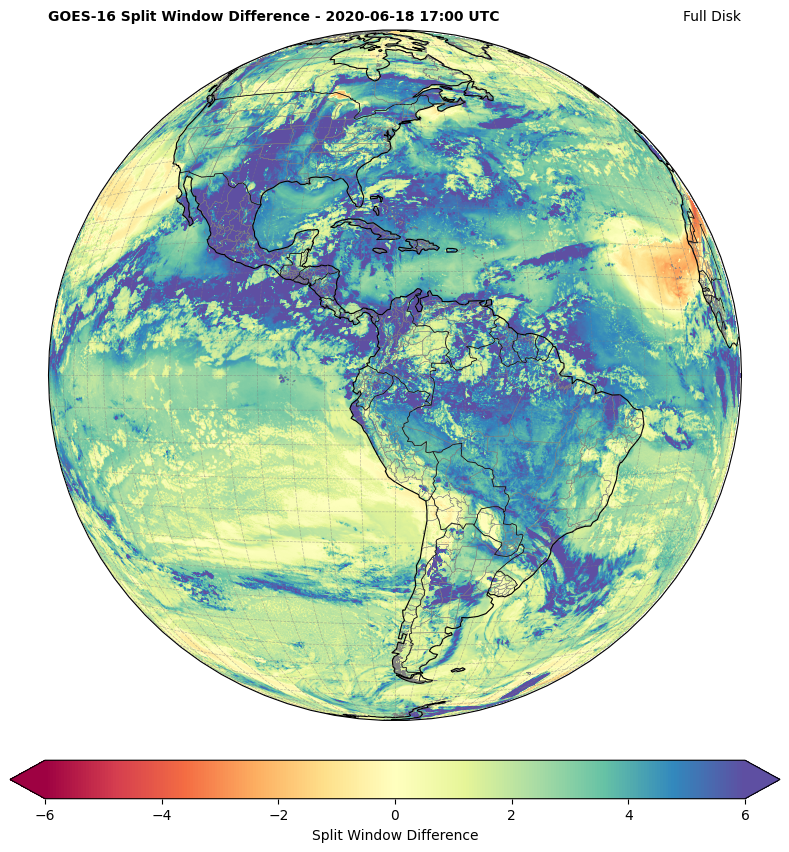

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Homework - Example 1 - Split Window Difference
#-----------------------------------------------------------------------------------------------------------

# Required modules
from netCDF4 import Dataset                # Read / Write NetCDF4 files
import matplotlib.pyplot as plt            # Plotting library
from datetime import datetime              # Basic Dates and time types
import cartopy, cartopy.crs as ccrs        # Plot maps
import cartopy.io.shapereader as shpreader # Import shapefiles
import numpy as np                         # Scientific computing with Python
import os                                  # Miscellaneous operating system interfaces
from utilities import download_CMI         # Our own utilities
import warnings; warnings.filterwarnings("ignore")

#-----------------------------------------------------------------------------------------------------------

# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# Time / Date for download
yyyymmddhhmn = '202006181700' # YYYYMMDDHHMN

# Download the file
file1 = download_CMI(yyyymmddhhmn, '13', input) # (Time&Date, Band, Directory)

# Download the file
file2 = download_CMI(yyyymmddhhmn, '15', input) # (Time&Date, Band, Directory)

#-----------------------------------------------------------------------------------------------------------

# Open the GOES-R image
file1 = Dataset(f'{input}/{file1}.nc')

# Get the pixel values
data1 = file1.variables['CMI'][:]

# Open the GOES-R image
file2 = Dataset(f'{input}/{file2}.nc')

# Get the pixel values
data2 = file2.variables['CMI'][:]

#-----------------------------------------------------------------------------------------------------------

# Calculate the channel difference
data = data1 - data2

#-----------------------------------------------------------------------------------------------------------

# Choose the plot size (width x height, in inches)
plt.figure(figsize=(10,10))

# Use the Geostationary projection in cartopy
longitude_of_projection_origin = file1.variables['goes_imager_projection'].longitude_of_projection_origin
perspective_point_height = file1.variables['goes_imager_projection'].perspective_point_height
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=longitude_of_projection_origin, satellite_height=perspective_point_height))

# Extent of data in decimais (2712*0.000056*35786023.0)
xmin = file1.variables['x'][:].min()*perspective_point_height
xmax = file1.variables['x'][:].max()*perspective_point_height
ymin = file1.variables['y'][:].min()*perspective_point_height
ymax = file1.variables['y'][:].max()*perspective_point_height
img_extent = (xmin, xmax, ymin, ymax)

# Add a shapefile
shapefile = list(shpreader.Reader('/content/ne_10m_admin_1_states_provinces.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='gray',facecolor='none', linewidth=0.3)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='black', linewidth=0.5)
ax.coastlines(resolution='110m', color='black', linewidth=0.8)
ax.gridlines(color='gray', alpha=0.5, linestyle='--', linewidth=0.5, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5))

# Define some parameters
colormap = 'Spectral'
vmin = -6
vmax = 6
title = 'GOES-16 Split Window Difference'
legend = 'Split Window Difference'

# Plot the image
img = ax.imshow(data, origin='upper', vmin=vmin, vmax=vmax, extent=img_extent, cmap=colormap)

# Add a colorbar
plt.colorbar(img, label=legend, extend='both', orientation='horizontal', pad=0.05, fraction=0.05)

# Extract date
date = (datetime.strptime(file1.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title(title + ' - ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')

#-----------------------------------------------------------------------------------------------------------

# Save the image
plt.savefig(f'{output}/image_1.png')

# Show the image
plt.show()

# **Example 2: Creating an RGB (Red-Green-Blue Composite) - Airmass**

RAMMB Quick Guide:
https://rammb.cira.colostate.edu/training/visit/quick_guides/QuickGuide_GOESR_AirMassRGB_final.pdf


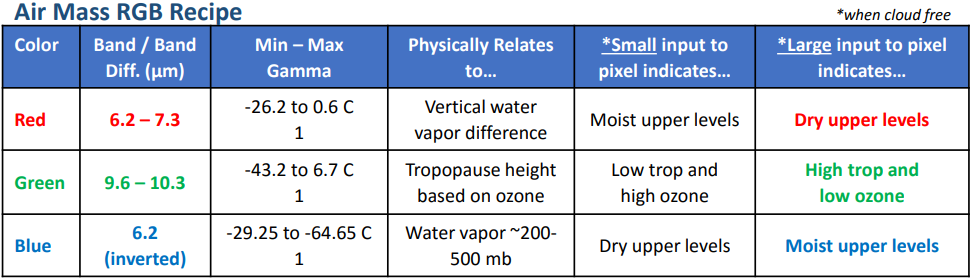

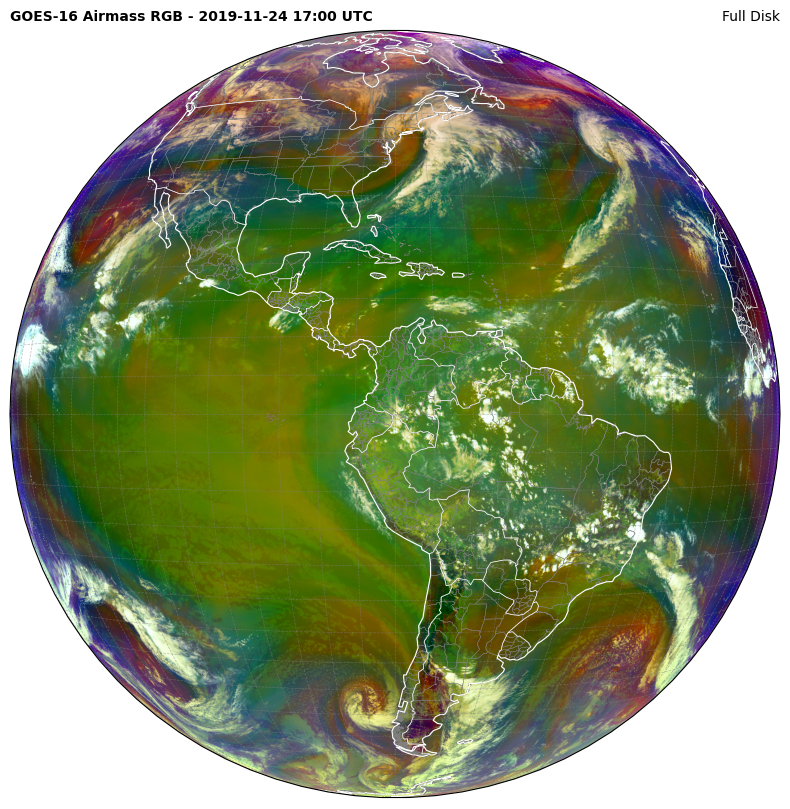

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Homework - Example 2 - Airmass RGB
#-----------------------------------------------------------------------------------------------------------

# Required modules
from netCDF4 import Dataset                # Read / Write NetCDF4 files
import matplotlib.pyplot as plt            # Plotting library
from datetime import datetime              # Basic Dates and time types
import cartopy, cartopy.crs as ccrs        # Plot maps
import cartopy.io.shapereader as shpreader # Import shapefiles
import numpy as np                         # Scientific computing with Python
import os                                  # Miscellaneous operating system interfaces
from utilities import download_CMI         # Our own utilities
import warnings; warnings.filterwarnings("ignore")

#-----------------------------------------------------------------------------------------------------------

# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# Time / Date for download
yyyymmddhhmn = '201911241700' # YYYYMMDDHHMN

# Download the file
file1 = download_CMI(yyyymmddhhmn, 8, input) # (Time&Date, Band, Directory)

# Download the file
file2 = download_CMI(yyyymmddhhmn, 10, input) # (Time&Date, Band, Directory)

# Download the file
file3 = download_CMI(yyyymmddhhmn, 12, input) # (Time&Date, Band, Directory)

# Download the file
file4 = download_CMI(yyyymmddhhmn, 13, input) # (Time&Date, Band, Directory)

#-----------------------------------------------------------------------------------------------------------

# Open the GOES-R image
file1 = Dataset(f'{input}/{file1}.nc')

# Get the pixel values
data1 = file1.variables['CMI'][:,:][::4 ,::4] - 273.15

# Open the GOES-R image
file2 = Dataset(f'{input}/{file2}.nc')

# Get the pixel values
data2 = file2.variables['CMI'][:,:][::4 ,::4] - 273.15

# Open the GOES-R image
file3 = Dataset(f'{input}/{file3}.nc')

# Get the pixel values
data3 = file3.variables['CMI'][:,:][::4 ,::4] - 273.15

# Open the GOES-R image
file4 = Dataset(f'{input}/{file4}.nc')

# Get the pixel values
data4 = file4.variables['CMI'][:,:][::4 ,::4] - 273.15

#-----------------------------------------------------------------------------------------------------------

# RGB Quick Guide: http://rammb.cira.colostate.edu/training/visit/quick_guides/QuickGuide_GOESR_AirMassRGB_final.pdf

# RGB Components (recipe)
R = data1 - data2
G = data3 - data4
B = data1

# Minimuns and Maximuns (recipe)
Rmin = -26.2
Rmax = 0.6

Gmin = -43.2
Gmax = 6.7

Bmin = -64.65
Bmax = -29.25

R = np.clip(R, Rmin, Rmax)
G = np.clip(G, Gmin, Gmax)
B = np.clip(B, Bmin, Bmax)

# Gammas (recipe)
gamma_R = 1
gamma_G = 1
gamma_B = 1

# Normalize the data and appy the gamma correction
R = ((R - Rmin) / (Rmax - Rmin)) ** (1/gamma_R)
G = ((G - Gmin) / (Gmax - Gmin)) ** (1/gamma_G)
B = ((B - Bmin) / (Bmax - Bmin)) ** (1/gamma_B)

# Invert the "Blue" component
B = 1.0 - B

# Create the RGB
RGB = np.stack([R, G, B], axis=2)

#-----------------------------------------------------------------------------------------------------------

# Choose the plot size (width x height, in inches)
plt.figure(figsize=(10,10))

# Use the Geostationary projection in cartopy
longitude_of_projection_origin = file1.variables['goes_imager_projection'].longitude_of_projection_origin
perspective_point_height = file1.variables['goes_imager_projection'].perspective_point_height
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=longitude_of_projection_origin, satellite_height=perspective_point_height))

# Extent of data in decimais (2712*0.000056*35786023.0)
xmin = file1.variables['x'][:].min()*perspective_point_height
xmax = file1.variables['x'][:].max()*perspective_point_height
ymin = file1.variables['y'][:].min()*perspective_point_height
ymax = file1.variables['y'][:].max()*perspective_point_height
img_extent = (xmin, xmax, ymin, ymax)

# Add a shapefile
shapefile = list(shpreader.Reader('/content/ne_10m_admin_1_states_provinces.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='gray',facecolor='none', linewidth=0.3)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
ax.coastlines(resolution='110m', color='white', linewidth=0.8)
ax.gridlines(color='gray', alpha=0.5, linestyle='--', linewidth=0.5, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5))

# Define the title
title = 'GOES-16 Airmass RGB'

# Plot the image
img = ax.imshow(RGB, origin='upper', extent=img_extent)

# Extract date
date = (datetime.strptime(file1.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title(title + ' - ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')

#-----------------------------------------------------------------------------------------------------------

# Save the image
plt.savefig(f'{output}/image_airmass.png')

# Show the image
plt.show()

# **Example 3: Creating an RGB (Red-Green-Blue Composite) - Day Cloud Phase**

RAMMB Quick Guide:
https://rammb.cira.colostate.edu/training/visit/quick_guides/QuickGuide_DayCloudPhaseDistinction_final_v2.pdf


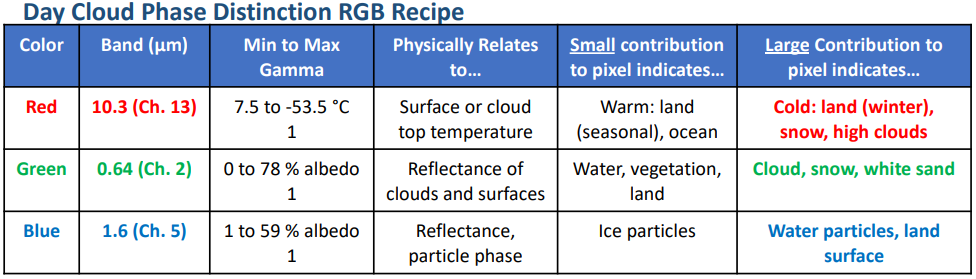

File /content/Samples/OR_ABI-L2-CMIPF-M6C13_G16_s20201701700222_e20201701709542_c20201701710027.nc exists
(5424, 5424)
(5424, 5424)
(5424, 5424)


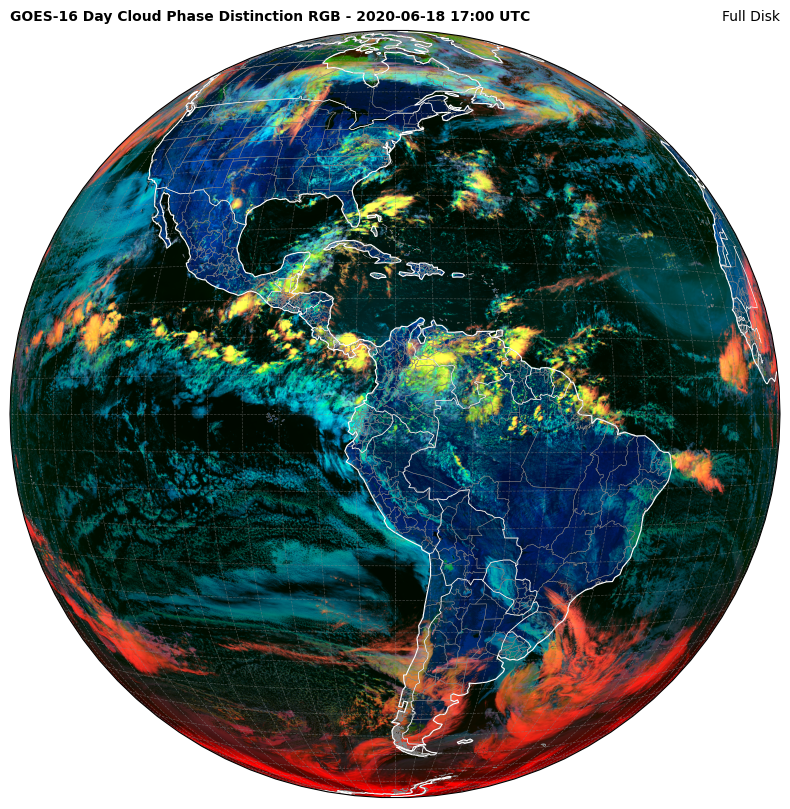

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Homework - Example 3 - Day Cloud Phase Distinction RGB
#-----------------------------------------------------------------------------------------------------------

# Required modules
from netCDF4 import Dataset                # Read / Write NetCDF4 files
import matplotlib.pyplot as plt            # Plotting library
from datetime import datetime              # Basic Dates and time types
import cartopy, cartopy.crs as ccrs        # Plot maps
import cartopy.io.shapereader as shpreader # Import shapefiles
import numpy as np                         # Scientific computing with Python
import os                                  # Miscellaneous operating system interfaces
from utilities import download_CMI         # Our own utilities
import warnings; warnings.filterwarnings("ignore")

#-----------------------------------------------------------------------------------------------------------

# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# Time / Date for download
yyyymmddhhmn = '202006181700' # YYYYMMDDHHMN

# Download the file
file1 = download_CMI(yyyymmddhhmn, 13, input) # (Time&Date, Band, Directory)

# Download the file
file2 = download_CMI(yyyymmddhhmn, 2, input) # (Time&Date, Band, Directory)

# Download the file
file3 = download_CMI(yyyymmddhhmn, 5, input) # (Time&Date, Band, Directory)

#-----------------------------------------------------------------------------------------------------------

# Open the GOES-R image
file_ch13 = Dataset(f'{input}/{file1}.nc')

# Get the pixel values
data_ch13 = file_ch13.variables['CMI'][:,:][::1 ,::1] - 273.15

# Open the GOES-R image
file_ch02 = Dataset(f'{input}/{file2}.nc')

# Get the pixel values
data_ch02 = file_ch02.variables['CMI'][:,:][::4 ,::4] # Read every 4 pixels (0.5 km to 2 km)

# Open the GOES-R image
file_ch05 = Dataset(f'{input}/{file3}.nc')

# Get the pixel values
data_ch05 = file_ch05.variables['CMI'][:,:][::2 ,::2] # Read every 2 pixels (1.0 km to 2 km)

print(data_ch13.shape)
print(data_ch02.shape)
print(data_ch05.shape)
#-----------------------------------------------------------------------------------------------------------

# RGB Quick Guide: https://rammb.cira.colostate.edu/training/visit/quick_guides/QuickGuide_DayCloudPhaseDistinction_final_v2.pdf

# RGB Components (recipe)
R = data_ch13
G = data_ch02
B = data_ch05

# Minimuns and Maximuns (recipe)
Rmin = -53.5
Rmax = 7.5

Gmin = 0.0
Gmax = 0.78

Bmin = 0.01
Bmax = 0.59

R = np.clip(R, Rmin, Rmax)
G = np.clip(G, Gmin, Gmax)
B = np.clip(B, Bmin, Bmax)

# Gammas (recipe)
gamma_R = 1
gamma_G = 1
gamma_B = 1

# Normalize the data and appy the gamma correction
R = ((R - Rmax) / (Rmin - Rmax)) ** (1/gamma_R)
G = ((G - Gmin) / (Gmax - Gmin)) ** (1/gamma_G)
B = ((B - Bmin) / (Bmax - Bmin)) ** (1/gamma_B)

# Create the RGB
RGB = np.stack([R, G, B], axis=2)

#-----------------------------------------------------------------------------------------------------------

# Choose the plot size (width x height, in inches)
plt.figure(figsize=(10,10))

# Use the Geostationary projection in cartopy
longitude_of_projection_origin = file_ch13.variables['goes_imager_projection'].longitude_of_projection_origin
perspective_point_height = file_ch13.variables['goes_imager_projection'].perspective_point_height
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=longitude_of_projection_origin, satellite_height=perspective_point_height))

# Extent of data in decimais (2712*0.000056*35786023.0)
xmin = file_ch13.variables['x'][:].min()*perspective_point_height
xmax = file_ch13.variables['x'][:].max()*perspective_point_height
ymin = file_ch13.variables['y'][:].min()*perspective_point_height
ymax = file_ch13.variables['y'][:].max()*perspective_point_height
img_extent = (xmin, xmax, ymin, ymax)

# Add a shapefile
shapefile = list(shpreader.Reader('/content/ne_10m_admin_1_states_provinces.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='gray',facecolor='none', linewidth=0.3)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
ax.coastlines(resolution='110m', color='white', linewidth=0.8)
ax.gridlines(color='gray', alpha=0.5, linestyle='--', linewidth=0.5, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5))

# Define the title
title = 'GOES-16 Day Cloud Phase Distinction RGB'

# Plot the image
img = ax.imshow(RGB, origin='upper', extent=img_extent)

# Extract date
date = (datetime.strptime(file_ch13.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title(title + ' - ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')

#-----------------------------------------------------------------------------------------------------------

# Save the image
plt.savefig(f'{output}/image_dcp.png')

# Show the image
plt.show()

# **Assignment 1: Create the Channel Difference - "Night Fog" (10.3 µm – 3.9 µm)**

RAMMB Quick Guide:
http://cimss.ssec.wisc.edu/goes/OCLOFactSheetPDFs/ABIQuickGuide_NightFogBTD.pdf

*   **Difference:** Channel 13 (10.3 µm) - Channel 7 (3.9 µm)
*   **Suggested Colormap:** gray
*   **Minimum Value:** -5
*   **Maximum Value:**  5
*   **Legend:** Night Fog Difference
*   **Time and Date:** You may select any date (variable 'yyyymmddhhmn')



File /content/Samples/OR_ABI-L2-CMIPF-M6C13_G16_s20231280400204_e20231280409523_c20231280410006.nc exists
File /content/Samples/OR_ABI-L2-CMIPF-M6C07_G16_s20231280400204_e20231280409524_c20231280410012.nc exists


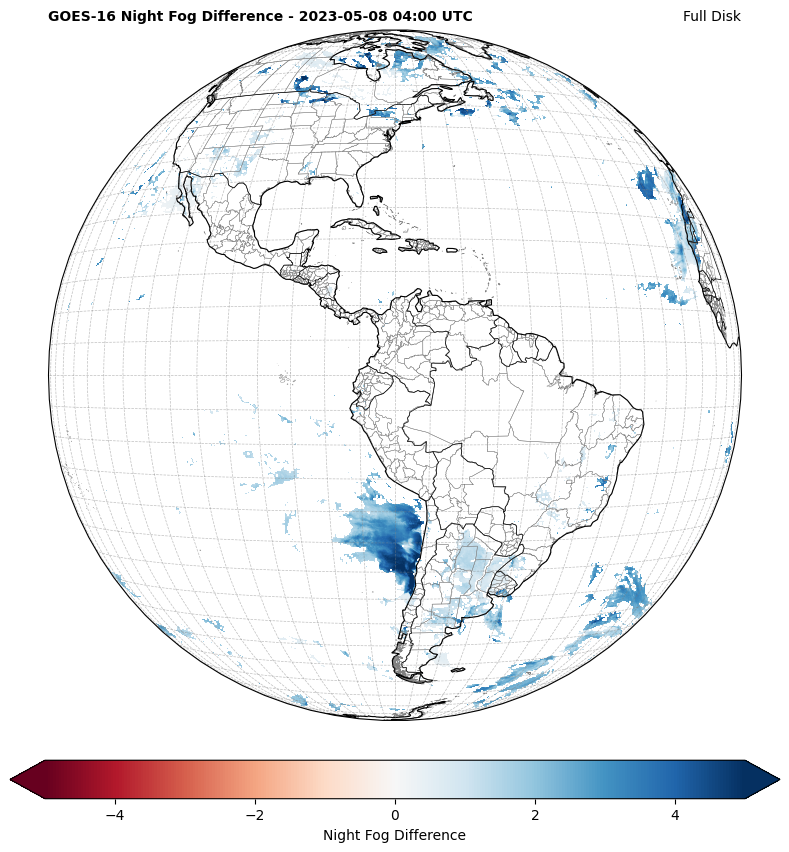

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Homework - Assignment 1 - Night Fog Difference
#-----------------------------------------------------------------------------------------------------------

# Required modules
from netCDF4 import Dataset                # Read / Write NetCDF4 files
import matplotlib.pyplot as plt            # Plotting library
from datetime import datetime              # Basic Dates and time types
import cartopy, cartopy.crs as ccrs        # Plot maps
import cartopy.io.shapereader as shpreader # Import shapefiles
import numpy as np                         # Scientific computing with Python
import os                                  # Miscellaneous operating system interfaces
from utilities import download_CMI         # Our own utilities
import warnings; warnings.filterwarnings("ignore")

#-----------------------------------------------------------------------------------------------------------

# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# Time / Date for download
yyyymmddhhmn = '202305080400' # YYYYMMDDHHMN

# Download the file
file1 = download_CMI(yyyymmddhhmn, '13', input) # (Time&Date, Band, Directory)

# Download the file
file2 = download_CMI(yyyymmddhhmn, '7', input) # (Time&Date, Band, Directory)

#-----------------------------------------------------------------------------------------------------------

# Open the GOES-R image
file1 = Dataset(f'{input}/{file1}.nc')

# Get the pixel values
data1 = file1.variables['CMI'][:]

# Open the GOES-R image
file2 = Dataset(f'{input}/{file2}.nc')

# Get the pixel values
data2 = file2.variables['CMI'][:]

#-----------------------------------------------------------------------------------------------------------

# Calculate the channel difference
data = data1 - data2
data[data < 0] = np.nan
#-----------------------------------------------------------------------------------------------------------

# Choose the plot size (width x height, in inches)
plt.figure(figsize=(10,10))

# Use the Geostationary projection in cartopy
longitude_of_projection_origin = file1.variables['goes_imager_projection'].longitude_of_projection_origin
perspective_point_height = file1.variables['goes_imager_projection'].perspective_point_height
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=longitude_of_projection_origin, satellite_height=perspective_point_height))

# Extent of data in decimais (2712*0.000056*35786023.0)
xmin = file1.variables['x'][:].min()*perspective_point_height
xmax = file1.variables['x'][:].max()*perspective_point_height
ymin = file1.variables['y'][:].min()*perspective_point_height
ymax = file1.variables['y'][:].max()*perspective_point_height
img_extent = (xmin, xmax, ymin, ymax)

# Add a shapefile
shapefile = list(shpreader.Reader('/content/ne_10m_admin_1_states_provinces.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='gray',facecolor='none', linewidth=0.3)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='black', linewidth=0.5)
ax.coastlines(resolution='110m', color='black', linewidth=0.8)
ax.gridlines(color='gray', alpha=0.5, linestyle='--', linewidth=0.5, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5))

# Define some parameters
colormap = 'RdBu'
vmin = -5
vmax = 5
title = 'GOES-16 Night Fog Difference'
legend = 'Night Fog Difference'

# Plot the image
img = ax.imshow(data, origin='upper', vmin=vmin, vmax=vmax, extent=img_extent, cmap=colormap)

# Add a colorbar
plt.colorbar(img, label=legend, extend='both', orientation='horizontal', pad=0.05, fraction=0.05)

# Extract date
date = (datetime.strptime(file1.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title(title + ' - ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')

#-----------------------------------------------------------------------------------------------------------

# Save the image
plt.savefig(f'{output}/image_nfd.png')

# Show the image
plt.show()

# **Assignment 2: Create the Channel Difference - "Split Cloud Phase" (11.2 µm – 8.4 µm)**

RAMMB Quick Guide:
http://cimss.ssec.wisc.edu/goes/OCLOFactSheetPDFs/ABIQuickGuide_G16_CloudPhaseBTD.pdf

*   **Difference:** Channel 14 (11.2 µm) - Channel 11 (8.4 µm)
*   **Suggested Colormap:** jet
*   **Minimum Value:** -10
*   **Maximum Value:**  25
*   **Legend:** Split Cloud Phase
*   **Time and Date:** You may select any date (variable 'yyyymmddhhmn')



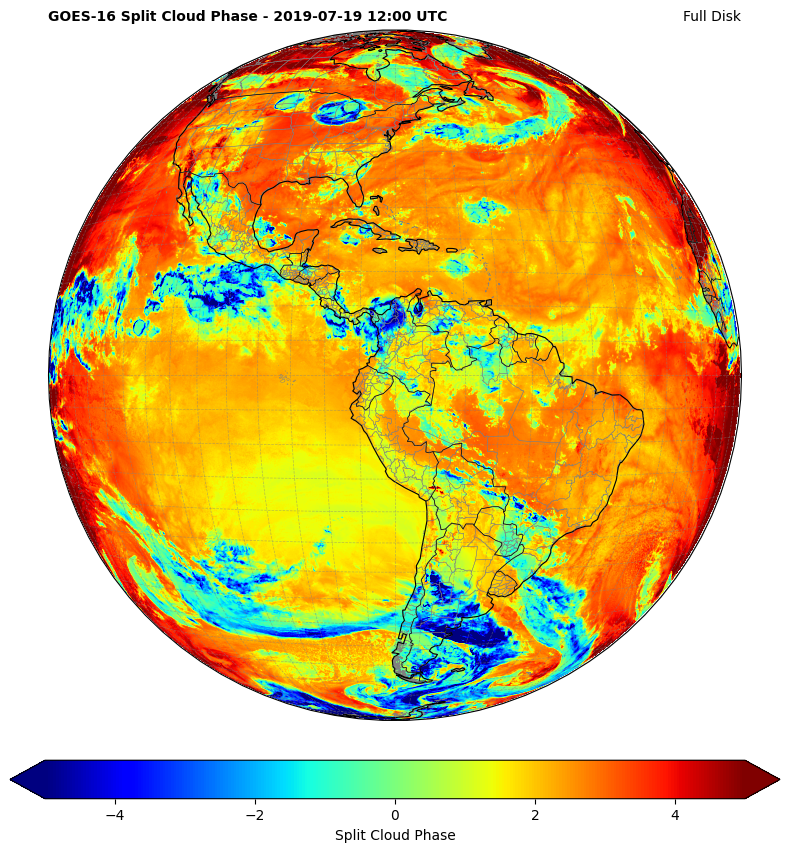

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Homework - Assignment 2 - Split Cloud Phase Difference
#-----------------------------------------------------------------------------------------------------------

# Required modules
from netCDF4 import Dataset                # Read / Write NetCDF4 files
import matplotlib.pyplot as plt            # Plotting library
from datetime import datetime              # Basic Dates and time types
import cartopy, cartopy.crs as ccrs        # Plot maps
import cartopy.io.shapereader as shpreader # Import shapefiles
import numpy as np                         # Scientific computing with Python
import os                                  # Miscellaneous operating system interfaces
from utilities import download_CMI         # Our own utilities
import warnings; warnings.filterwarnings("ignore")

#-----------------------------------------------------------------------------------------------------------

# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# Time / Date for download
yyyymmddhhmn = '201907191200' # YYYYMMDDHHMN

# Download the file
file1 = download_CMI(yyyymmddhhmn, '14', input) # (Time&Date, Band, Directory)

# Download the file
file2 = download_CMI(yyyymmddhhmn, '11', input) # (Time&Date, Band, Directory)

#-----------------------------------------------------------------------------------------------------------

# Open the GOES-R image
file1 = Dataset(f'{input}/{file1}.nc')

# Get the pixel values
data1 = file1.variables['CMI'][:]

# Open the GOES-R image
file2 = Dataset(f'{input}/{file2}.nc')

# Get the pixel values
data2 = file2.variables['CMI'][:]

#-----------------------------------------------------------------------------------------------------------

# Calculate the channel difference
data = data1 - data2

#-----------------------------------------------------------------------------------------------------------

# Choose the plot size (width x height, in inches)
plt.figure(figsize=(10,10))

# Use the Geostationary projection in cartopy
longitude_of_projection_origin = file1.variables['goes_imager_projection'].longitude_of_projection_origin
perspective_point_height = file1.variables['goes_imager_projection'].perspective_point_height
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=longitude_of_projection_origin, satellite_height=perspective_point_height))

# Extent of data in decimais (2712*0.000056*35786023.0)
xmin = file1.variables['x'][:].min()*perspective_point_height
xmax = file1.variables['x'][:].max()*perspective_point_height
ymin = file1.variables['y'][:].min()*perspective_point_height
ymax = file1.variables['y'][:].max()*perspective_point_height
img_extent = (xmin, xmax, ymin, ymax)

# Add a shapefile
shapefile = list(shpreader.Reader('/content/ne_10m_admin_1_states_provinces.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='gray',facecolor='none', linewidth=0.3)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='black', linewidth=0.5)
ax.coastlines(resolution='110m', color='black', linewidth=0.8)
ax.gridlines(color='gray', alpha=0.5, linestyle='--', linewidth=0.5, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5))

# Define some parameters
colormap = 'jet'
vmin = -5
vmax = 5
title = 'GOES-16 Split Cloud Phase'
legend = 'Split Cloud Phase'

# Plot the image
img = ax.imshow(data, origin='upper', vmin=vmin, vmax=vmax, extent=img_extent, cmap=colormap)

# Add a colorbar
plt.colorbar(img, label=legend, extend='both', orientation='horizontal', pad=0.05, fraction=0.05)

# Extract date
date = (datetime.strptime(file1.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title(title + ' - ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')

#-----------------------------------------------------------------------------------------------------------

# Save the image
plt.savefig(f'{output}/image_scp.png')

# Show the image
plt.show()

# **Assignment 3: Create the Channel Difference - "Split Water Vapor" (6.2 µm – 7.3 µm)**

RAMMB Quick Guide:
http://cimss.ssec.wisc.edu/goes/OCLOFactSheetPDFs/ABIQuickGuide_SplitWV_BTDiffv2.pdf

*   **Difference:** Channel 8 (6.2 µm) - Channel 10 (7.3 µm)
*   **Suggested Colormap:** nipy_spectral
*   **Minimum Value:** -30
*   **Maximum Value:**  5
*   **Legend:** Split Water Vapor
*   **Time and Date:** You may select any date (variable 'yyyymmddhhmn')




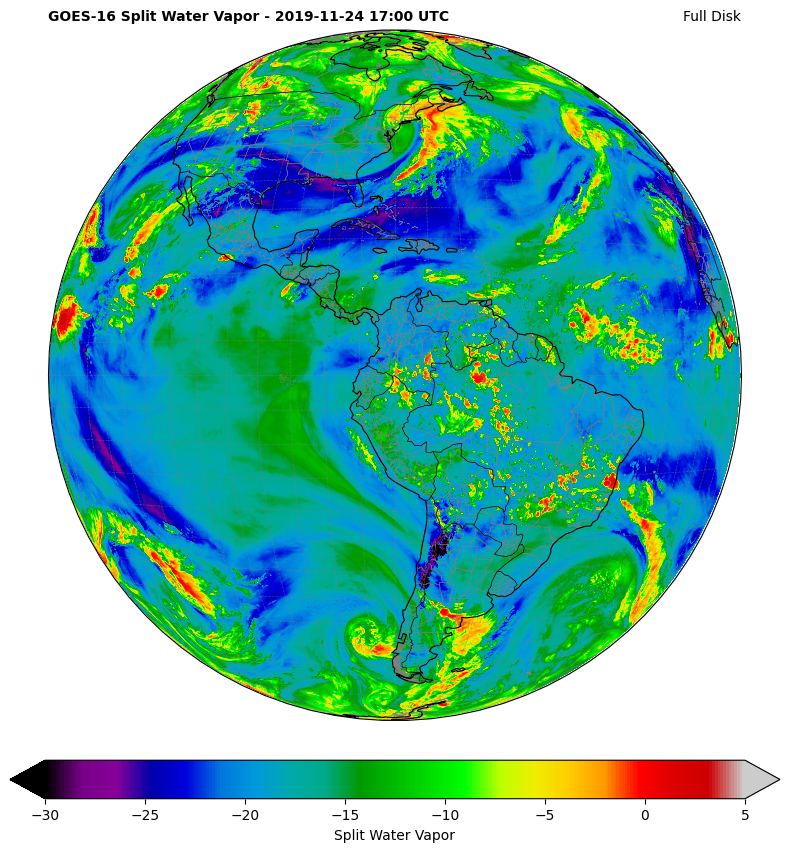

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Homework - Assignment 3 -  Split Water Vapor Difference
#-----------------------------------------------------------------------------------------------------------

# Required modules
from netCDF4 import Dataset                # Read / Write NetCDF4 files
import matplotlib.pyplot as plt            # Plotting library
from datetime import datetime              # Basic Dates and time types
import cartopy, cartopy.crs as ccrs        # Plot maps
import cartopy.io.shapereader as shpreader # Import shapefiles
import numpy as np                         # Scientific computing with Python
import os                                  # Miscellaneous operating system interfaces
from utilities import download_CMI         # Our own utilities
import warnings; warnings.filterwarnings("ignore")

#-----------------------------------------------------------------------------------------------------------

# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# Time / Date for download
yyyymmddhhmn = '201911241700' # YYYYMMDDHHMN

# Download the file
file1 = download_CMI(yyyymmddhhmn, '8', input) # (Time&Date, Band, Directory)

# Download the file
file2 = download_CMI(yyyymmddhhmn, '10', input) # (Time&Date, Band, Directory)

#-----------------------------------------------------------------------------------------------------------

# Open the GOES-R image
file1 = Dataset(f'{input}/{file1}.nc')

# Get the pixel values
data_ch08 = file1.variables['CMI'][:]

# Open the GOES-R image
file2 = Dataset(f'{input}/{file2}.nc')

# Get the pixel values
data_ch10 = file2.variables['CMI'][:]

#-----------------------------------------------------------------------------------------------------------

# Calculate the channel difference
data_swv = data_ch08 - data_ch10

#-----------------------------------------------------------------------------------------------------------

# Choose the plot size (width x height, in inches)
plt.figure(figsize=(10,10))

# Use the Geostationary projection in cartopy
longitude_of_projection_origin = file1.variables['goes_imager_projection'].longitude_of_projection_origin
perspective_point_height = file1.variables['goes_imager_projection'].perspective_point_height
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=longitude_of_projection_origin, satellite_height=perspective_point_height))

# Extent of data in decimais (2712*0.000056*35786023.0)
xmin = file1.variables['x'][:].min()*perspective_point_height
xmax = file1.variables['x'][:].max()*perspective_point_height
ymin = file1.variables['y'][:].min()*perspective_point_height
ymax = file1.variables['y'][:].max()*perspective_point_height
img_extent = (xmin, xmax, ymin, ymax)

# Add a shapefile
shapefile = list(shpreader.Reader('/content/ne_10m_admin_1_states_provinces.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='gray',facecolor='none', linewidth=0.3)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='black', linewidth=0.5)
ax.coastlines(resolution='110m', color='black', linewidth=0.8)
ax.gridlines(color='gray', alpha=0.5, linestyle='--', linewidth=0.5, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5))

# Define some parameters
colormap = 'nipy_spectral'
vmin = -30
vmax = 5
title = 'GOES-16 Split Water Vapor'
legend = 'Split Water Vapor'

# Plot the image
img = ax.imshow(data_swv, origin='upper', vmin=vmin, vmax=vmax, extent=img_extent, cmap=colormap)

# Add a colorbar
plt.colorbar(img, label=legend, extend='both', orientation='horizontal', pad=0.05, fraction=0.05)

# Extract date
date = (datetime.strptime(file1.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title(title + ' - ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')

#-----------------------------------------------------------------------------------------------------------

# Save the image
plt.savefig(f'{output}/image_1.png')

# Show the image
plt.show()

# **Assignment 4: Create the Channel Difference - "Split Ozone" (9.6 µm – 10.3 µm)**

RAMMB Quick Guide:
http://cimss.ssec.wisc.edu/goes/OCLOFactSheetPDFs/ABIQuickGuide_SplitOzoneDiff.pdf

*   **Difference:** Channel 12 (9.6 µm) - Channel 13 (10.3 µm)
*   **Suggested Colormap:** nipy_spectral
*   **Minimum Value:** -45
*   **Maximum Value:**  5
*   **Legend:** Split Ozone
*   **Time and Date:** La que desees (variable yyyymmddhhmn)




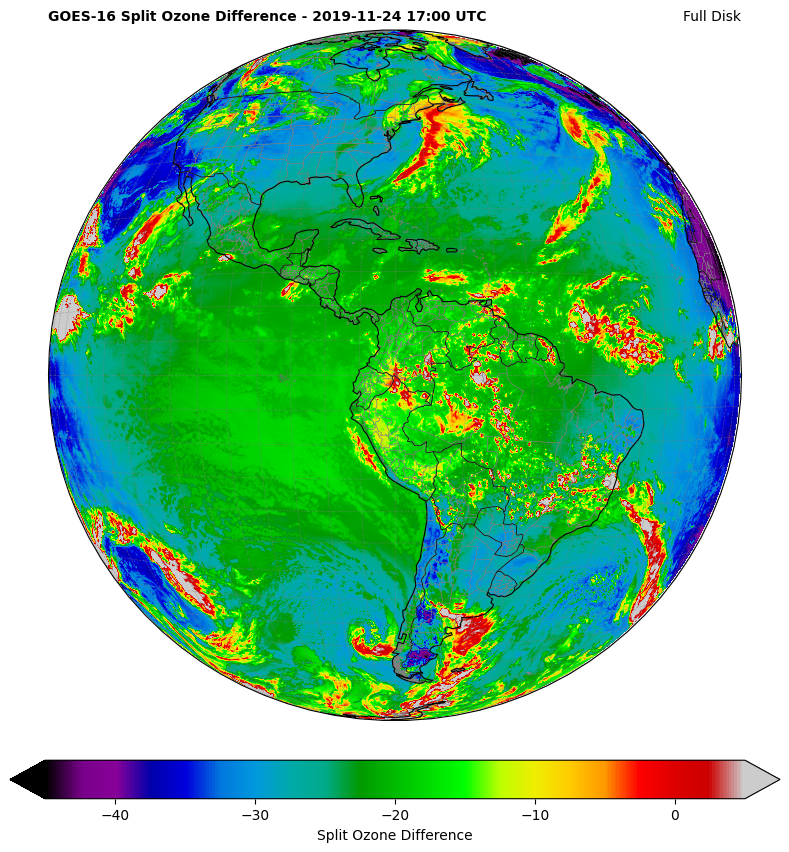

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Homework - Assignment 4 - Split Ozone
#-----------------------------------------------------------------------------------------------------------

# Required modules
from netCDF4 import Dataset                # Read / Write NetCDF4 files
import matplotlib.pyplot as plt            # Plotting library
from datetime import datetime              # Basic Dates and time types
import cartopy, cartopy.crs as ccrs        # Plot maps
import cartopy.io.shapereader as shpreader # Import shapefiles
import numpy as np                         # Scientific computing with Python
import os                                  # Miscellaneous operating system interfaces
from utilities import download_CMI         # Our own utilities
import warnings; warnings.filterwarnings("ignore")

#-----------------------------------------------------------------------------------------------------------

# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# Time / Date for download
yyyymmddhhmn = '201911241700' # YYYYMMDDHHMN

# Download the file
file1 = download_CMI(yyyymmddhhmn, '12', input) # (Time&Date, Band, Directory)

# Download the file
file2 = download_CMI(yyyymmddhhmn, '13', input) # (Time&Date, Band, Directory)

#-----------------------------------------------------------------------------------------------------------

# Open the GOES-R image
file1 = Dataset(f'{input}/{file1}.nc')

# Get the pixel values
data_ch12 = file1.variables['CMI'][:]

# Open the GOES-R image
file2 = Dataset(f'{input}/{file2}.nc')

# Get the pixel values
data_ch13 = file2.variables['CMI'][:]

#-----------------------------------------------------------------------------------------------------------

# Calculate the channel difference
data_soz = data_ch12 - data_ch13

#-----------------------------------------------------------------------------------------------------------

# Choose the plot size (width x height, in inches)
plt.figure(figsize=(10,10))

# Use the Geostationary projection in cartopy
longitude_of_projection_origin = file1.variables['goes_imager_projection'].longitude_of_projection_origin
perspective_point_height = file1.variables['goes_imager_projection'].perspective_point_height
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=longitude_of_projection_origin, satellite_height=perspective_point_height))

# Extent of data in decimais (2712*0.000056*35786023.0)
xmin = file1.variables['x'][:].min()*perspective_point_height
xmax = file1.variables['x'][:].max()*perspective_point_height
ymin = file1.variables['y'][:].min()*perspective_point_height
ymax = file1.variables['y'][:].max()*perspective_point_height
img_extent = (xmin, xmax, ymin, ymax)

# Add a shapefile
shapefile = list(shpreader.Reader('/content/ne_10m_admin_1_states_provinces.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='gray',facecolor='none', linewidth=0.3)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='black', linewidth=0.5)
ax.coastlines(resolution='110m', color='black', linewidth=0.8)
ax.gridlines(color='gray', alpha=0.5, linestyle='--', linewidth=0.5, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5))

# Define some parameters
colormap = 'nipy_spectral'
vmin = -45
vmax = 5
title = 'GOES-16 Split Ozone Difference'
legend = 'Split Ozone Difference'

# Plot the image
img = ax.imshow(data_soz, origin='upper', vmin=vmin, vmax=vmax, extent=img_extent, cmap=colormap)

# Add a colorbar
plt.colorbar(img, label=legend, extend='both', orientation='horizontal', pad=0.05, fraction=0.05)

# Extract date
date = (datetime.strptime(file1.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title(title + ' - ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')

#-----------------------------------------------------------------------------------------------------------

# Save the image
plt.savefig(f'{output}/image_sozone.png')

# Show the image
plt.show()

# **Assignment 5: Plot an RGB Composite - "Dust" and "Ash"**

RAMMB Quick Guide:
https://rammb.cira.colostate.edu/training/visit/quick_guides/Dust_RGB_Quick_Guide.pdf




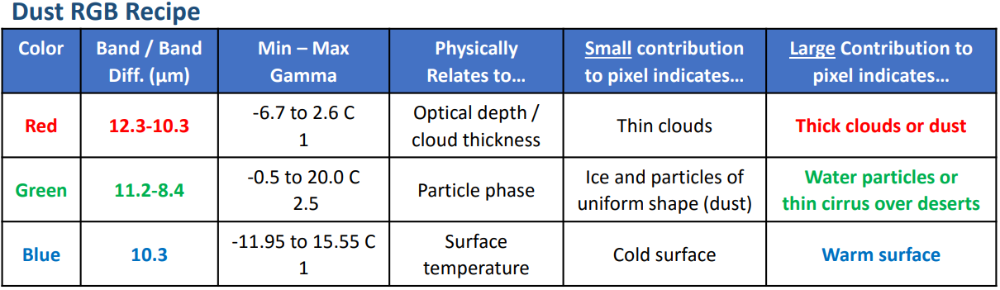

File /content/Samples/OR_ABI-L2-CMIPF-M6C15_G16_s20201701700222_e20201701709536_c20201701710023.nc exists
File /content/Samples/OR_ABI-L2-CMIPF-M6C13_G16_s20201701700222_e20201701709542_c20201701710027.nc exists


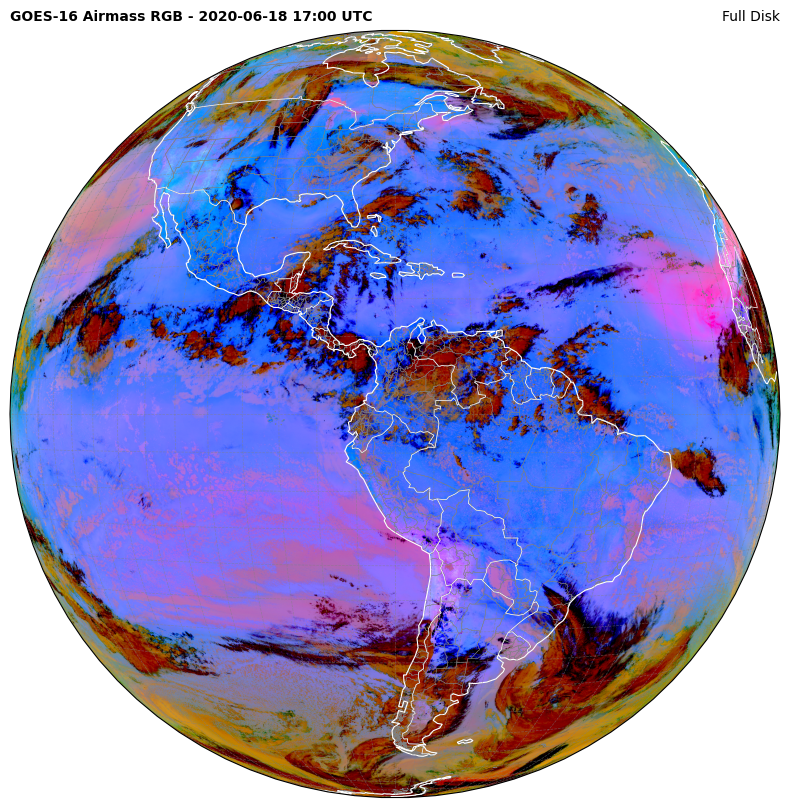

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Homework - Assignment 5 - Dust RGB
#-----------------------------------------------------------------------------------------------------------

# Required modules
from netCDF4 import Dataset                # Read / Write NetCDF4 files
import matplotlib.pyplot as plt            # Plotting library
from datetime import datetime              # Basic Dates and time types
import cartopy, cartopy.crs as ccrs        # Plot maps
import cartopy.io.shapereader as shpreader # Import shapefiles
import numpy as np                         # Scientific computing with Python
import os                                  # Miscellaneous operating system interfaces
from utilities import download_CMI         # Our own utilities
import warnings; warnings.filterwarnings("ignore")

#-----------------------------------------------------------------------------------------------------------

# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# Time / Date for download
yyyymmddhhmn = '202006181700' # YYYYMMDDHHMN

# Download the file
file1 = download_CMI(yyyymmddhhmn, 15, input) # (Time&Date, Band, Directory)

# Download the file
file2 = download_CMI(yyyymmddhhmn, 13, input) # (Time&Date, Band, Directory)

# Download the file
file3 = download_CMI(yyyymmddhhmn, 14, input) # (Time&Date, Band, Directory)

# Download the file
file4 = download_CMI(yyyymmddhhmn, 11, input) # (Time&Date, Band, Directory)

#-----------------------------------------------------------------------------------------------------------

# Open the GOES-R image
file1 = Dataset(f'{input}/{file1}.nc')

# Get the pixel values
data_ch15 = file1.variables['CMI'][:,:][::4 ,::4] - 273.15

# Open the GOES-R image
file2 = Dataset(f'{input}/{file2}.nc')

# Get the pixel values
data_ch13 = file2.variables['CMI'][:,:][::4 ,::4] - 273.15

# Open the GOES-R image
file3 = Dataset(f'{input}/{file3}.nc')

# Get the pixel values
data_ch14 = file3.variables['CMI'][:,:][::4 ,::4] - 273.15

# Open the GOES-R image
file4 = Dataset(f'{input}/{file4}.nc')

# Get the pixel values
data_ch11 = file4.variables['CMI'][:,:][::4 ,::4] - 273.15

#-----------------------------------------------------------------------------------------------------------

# RGB Quick Guide: http://rammb.cira.colostate.edu/training/visit/quick_guides/QuickGuide_GOESR_AirMassRGB_final.pdf

# RGB Components (recipe)
R = data_ch15 - data_ch13
G = data_ch14 - data_ch11
B = data_ch13

# Minimuns and Maximuns (recipe)
Rmin = -6.7
Rmax = 2.6

Gmin = -0.5
Gmax = 20.0

Bmin = -11.95
Bmax = 15.55

R = np.clip(R, Rmin, Rmax)
G = np.clip(G, Gmin, Gmax)
B = np.clip(B, Bmin, Bmax)

# Gammas (recipe)
gamma_R = 1
gamma_G = 2.5
gamma_B = 1

# Normalize the data and appy the gamma correction
R = ((R - Rmin) / (Rmax - Rmin)) ** (1/gamma_R)
G = ((G - Gmin) / (Gmax - Gmin)) ** (1/gamma_G)
B = ((B - Bmin) / (Bmax - Bmin)) ** (1/gamma_B)

# Create the RGB
RGB = np.stack([R, G, B], axis=2)

#-----------------------------------------------------------------------------------------------------------

# Choose the plot size (width x height, in inches)
plt.figure(figsize=(10,10))

# Use the Geostationary projection in cartopy
longitude_of_projection_origin = file1.variables['goes_imager_projection'].longitude_of_projection_origin
perspective_point_height = file1.variables['goes_imager_projection'].perspective_point_height
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=longitude_of_projection_origin, satellite_height=perspective_point_height))

# Extent of data in decimais (2712*0.000056*35786023.0)
xmin = file1.variables['x'][:].min()*perspective_point_height
xmax = file1.variables['x'][:].max()*perspective_point_height
ymin = file1.variables['y'][:].min()*perspective_point_height
ymax = file1.variables['y'][:].max()*perspective_point_height
img_extent = (xmin, xmax, ymin, ymax)

# Add a shapefile
shapefile = list(shpreader.Reader('/content/ne_10m_admin_1_states_provinces.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='gray',facecolor='none', linewidth=0.3)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
ax.coastlines(resolution='110m', color='white', linewidth=0.8)
ax.gridlines(color='gray', alpha=0.5, linestyle='--', linewidth=0.5, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5))

# Define the title
title = 'GOES-16 Dust RGB'

# Plot the image
img = ax.imshow(RGB, origin='upper', extent=img_extent)

# Extract date
date = (datetime.strptime(file1.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title(title + ' - ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')

#-----------------------------------------------------------------------------------------------------------

# Save the image
plt.savefig(f'{output}/image_dust.png')

# Show the image
plt.show()

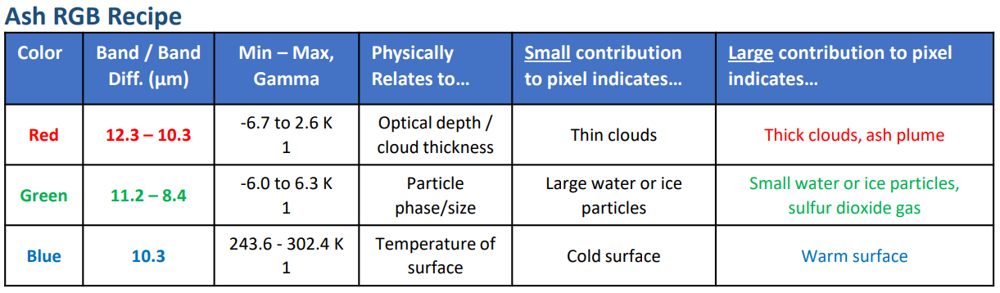

File /content/Samples/OR_ABI-L2-CMIPF-M6C13_G16_s20231242100203_e20231242109523_c20231242110001.nc exists
File /content/Samples/OR_ABI-L2-CMIPF-M6C11_G16_s20231242100203_e20231242109511_c20231242109579.nc exists


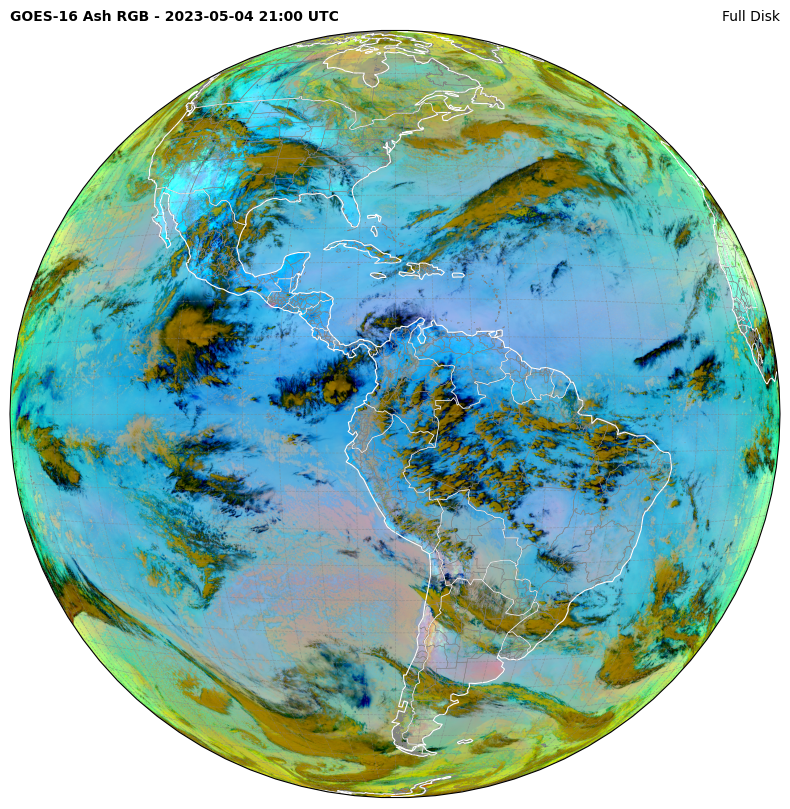

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Homework - Assignment 5 - Ash RGB
#-----------------------------------------------------------------------------------------------------------

# Required modules
from netCDF4 import Dataset                # Read / Write NetCDF4 files
import matplotlib.pyplot as plt            # Plotting library
from datetime import datetime              # Basic Dates and time types
import cartopy, cartopy.crs as ccrs        # Plot maps
import cartopy.io.shapereader as shpreader # Import shapefiles
import numpy as np                         # Scientific computing with Python
import os                                  # Miscellaneous operating system interfaces
from utilities import download_CMI         # Our own utilities
import warnings; warnings.filterwarnings("ignore")

#-----------------------------------------------------------------------------------------------------------

# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# Time / Date for download
yyyymmddhhmn = '202305042100' # YYYYMMDDHHMN

# Download the file
file1 = download_CMI(yyyymmddhhmn, 15, input) # (Time&Date, Band, Directory)

# Download the file
file2 = download_CMI(yyyymmddhhmn, 13, input) # (Time&Date, Band, Directory)

# Download the file
file3 = download_CMI(yyyymmddhhmn, 14, input) # (Time&Date, Band, Directory)

# Download the file
file4 = download_CMI(yyyymmddhhmn, 11, input) # (Time&Date, Band, Directory)

#-----------------------------------------------------------------------------------------------------------

# Open the GOES-R image
file1 = Dataset(f'{input}/{file1}.nc')

# Get the pixel values
data_ch15 = file1.variables['CMI'][:,:][::4 ,::4] - 273.15

# Open the GOES-R image
file2 = Dataset(f'{input}/{file2}.nc')

# Get the pixel values
data_ch13 = file2.variables['CMI'][:,:][::4 ,::4] - 273.15

# Open the GOES-R image
file3 = Dataset(f'{input}/{file3}.nc')

# Get the pixel values
data_ch14 = file3.variables['CMI'][:,:][::4 ,::4] - 273.15

# Open the GOES-R image
file4 = Dataset(f'{input}/{file4}.nc')

# Get the pixel values
data_ch11 = file4.variables['CMI'][:,:][::4 ,::4] - 273.15

#-----------------------------------------------------------------------------------------------------------

# RGB Quick Guide: http://rammb.cira.colostate.edu/training/visit/quick_guides/QuickGuide_GOESR_AirMassRGB_final.pdf

# RGB Components (recipe)
R = data_ch15 - data_ch13
G = data_ch14 - data_ch11
B = data_ch13

# Minimuns and Maximuns (recipe)
Rmin = -6.7
Rmax = 2.6

Gmin = -6.0
Gmax = 6.3

Bmin = -29.55
Bmax = 29.25

R = np.clip(R, Rmin, Rmax)
G = np.clip(G, Gmin, Gmax)
B = np.clip(B, Bmin, Bmax)

# Gammas (recipe)
gamma_R = 1
gamma_G = 1
gamma_B = 1

# Normalize the data and appy the gamma correction
R = ((R - Rmin) / (Rmax - Rmin)) ** (1/gamma_R)
G = ((G - Gmin) / (Gmax - Gmin)) ** (1/gamma_G)
B = ((B - Bmin) / (Bmax - Bmin)) ** (1/gamma_B)

# Create the RGB
RGB = np.stack([R, G, B], axis=2)

#-----------------------------------------------------------------------------------------------------------

# Choose the plot size (width x height, in inches)
plt.figure(figsize=(10,10))

# Use the Geostationary projection in cartopy
longitude_of_projection_origin = file1.variables['goes_imager_projection'].longitude_of_projection_origin
perspective_point_height = file1.variables['goes_imager_projection'].perspective_point_height
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=longitude_of_projection_origin, satellite_height=perspective_point_height))

# Extent of data in decimais (2712*0.000056*35786023.0)
xmin = file1.variables['x'][:].min()*perspective_point_height
xmax = file1.variables['x'][:].max()*perspective_point_height
ymin = file1.variables['y'][:].min()*perspective_point_height
ymax = file1.variables['y'][:].max()*perspective_point_height
img_extent = (xmin, xmax, ymin, ymax)

# Add a shapefile
shapefile = list(shpreader.Reader('/content/ne_10m_admin_1_states_provinces.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='gray',facecolor='none', linewidth=0.3)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
ax.coastlines(resolution='110m', color='white', linewidth=0.8)
ax.gridlines(color='gray', alpha=0.5, linestyle='--', linewidth=0.5, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5))

# Define the title
title = 'GOES-16 Ash RGB'

# Plot the image
img = ax.imshow(RGB, origin='upper', extent=img_extent)

# Extract date
date = (datetime.strptime(file1.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title(title + ' - ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')

#-----------------------------------------------------------------------------------------------------------

# Save the image
plt.savefig(f'{output}/image_ash.png')

# Show the image
plt.show()

# **Assignment 6: Plot an RGB Composite - "SO2"**

Guía Rápida RAMMB:
https://rammb.cira.colostate.edu/training/visit/quick_guides/Quick_Guide_SO2_RGB.pdf




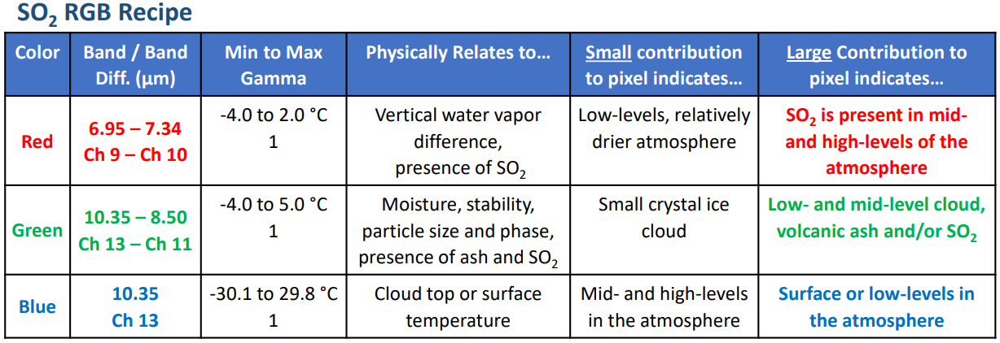

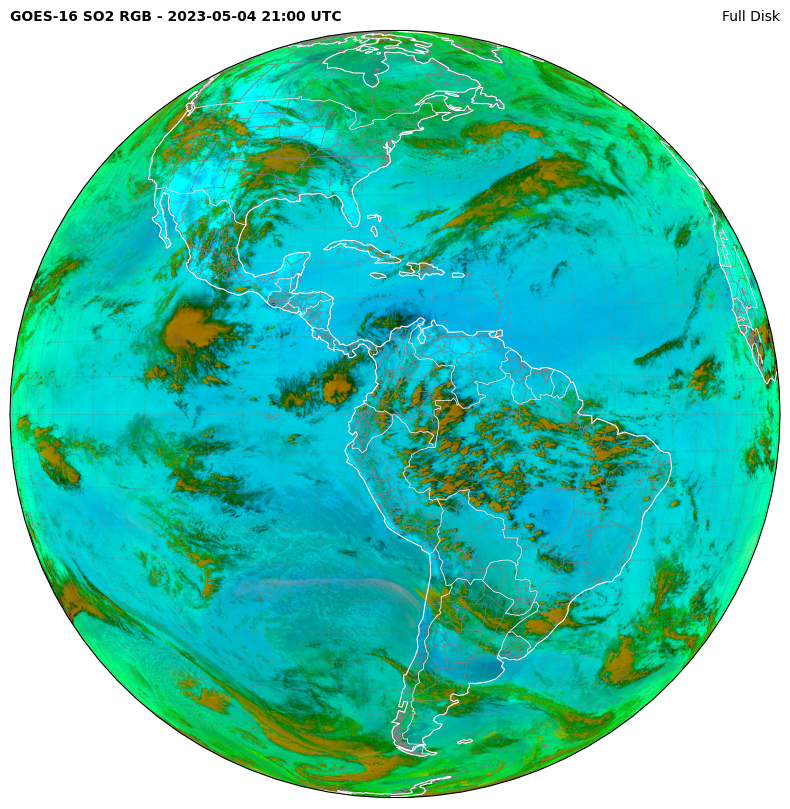

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Homework - Assignment 6 - SO2 RGB
#-----------------------------------------------------------------------------------------------------------

# Required modules
from netCDF4 import Dataset                # Read / Write NetCDF4 files
import matplotlib.pyplot as plt            # Plotting library
from datetime import datetime              # Basic Dates and time types
import cartopy, cartopy.crs as ccrs        # Plot maps
import cartopy.io.shapereader as shpreader # Import shapefiles
import numpy as np                         # Scientific computing with Python
import os                                  # Miscellaneous operating system interfaces
from utilities import download_CMI         # Our own utilities
import warnings; warnings.filterwarnings("ignore")

#-----------------------------------------------------------------------------------------------------------

# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# Time / Date for download
yyyymmddhhmn = '202305042100' # YYYYMMDDHHMN

# Download the file
file1 = download_CMI(yyyymmddhhmn, 9, input) # (Time&Date, Band, Directory)

# Download the file
file2 = download_CMI(yyyymmddhhmn, 10, input) # (Time&Date, Band, Directory)

# Download the file
file3 = download_CMI(yyyymmddhhmn, 13, input) # (Time&Date, Band, Directory)

# Download the file
file4 = download_CMI(yyyymmddhhmn, 11, input) # (Time&Date, Band, Directory)

#-----------------------------------------------------------------------------------------------------------

# Open the GOES-R image
file1 = Dataset(f'{input}/{file1}.nc')

# Get the pixel values
data_ch09 = file1.variables['CMI'][:,:][::4 ,::4] - 273.15

# Open the GOES-R image
file2 = Dataset(f'{input}/{file2}.nc')

# Get the pixel values
data_ch10 = file2.variables['CMI'][:,:][::4 ,::4] - 273.15

# Open the GOES-R image
file3 = Dataset(f'{input}/{file3}.nc')

# Get the pixel values
data_ch13 = file3.variables['CMI'][:,:][::4 ,::4] - 273.15

# Open the GOES-R image
file4 = Dataset(f'{input}/{file4}.nc')

# Get the pixel values
data_ch11 = file4.variables['CMI'][:,:][::4 ,::4] - 273.15

#-----------------------------------------------------------------------------------------------------------

# RGB Quick Guide: http://rammb.cira.colostate.edu/training/visit/quick_guides/QuickGuide_GOESR_AirMassRGB_final.pdf

# RGB Components (recipe)
R = data_ch09 - data_ch10
G = data_ch13 - data_ch11
B = data_ch13

# Minimuns and Maximuns (recipe)
Rmin = -4.0
Rmax = 2.0

Gmin = -4.0
Gmax = 5.0

Bmin = -30.1
Bmax = 29.8

R = np.clip(R, Rmin, Rmax)
G = np.clip(G, Gmin, Gmax)
B = np.clip(B, Bmin, Bmax)

# Gammas (recipe)
gamma_R = 1
gamma_G = 1
gamma_B = 1

# Normalize the data and appy the gamma correction
R = ((R - Rmin) / (Rmax - Rmin)) ** (1/gamma_R)
G = ((G - Gmin) / (Gmax - Gmin)) ** (1/gamma_G)
B = ((B - Bmin) / (Bmax - Bmin)) ** (1/gamma_B)

# Create the RGB
RGB = np.stack([R, G, B], axis=2)

#-----------------------------------------------------------------------------------------------------------

# Choose the plot size (width x height, in inches)
plt.figure(figsize=(10,10))

# Use the Geostationary projection in cartopy
longitude_of_projection_origin = file1.variables['goes_imager_projection'].longitude_of_projection_origin
perspective_point_height = file1.variables['goes_imager_projection'].perspective_point_height
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=longitude_of_projection_origin, satellite_height=perspective_point_height))

# Extent of data in decimais (2712*0.000056*35786023.0)
xmin = file1.variables['x'][:].min()*perspective_point_height
xmax = file1.variables['x'][:].max()*perspective_point_height
ymin = file1.variables['y'][:].min()*perspective_point_height
ymax = file1.variables['y'][:].max()*perspective_point_height
img_extent = (xmin, xmax, ymin, ymax)

# Add a shapefile
shapefile = list(shpreader.Reader('/content/ne_10m_admin_1_states_provinces.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='gray',facecolor='none', linewidth=0.3)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
ax.coastlines(resolution='110m', color='white', linewidth=0.8)
ax.gridlines(color='gray', alpha=0.5, linestyle='--', linewidth=0.5, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5))

# Define the title
title = 'GOES-16 SO2 RGB'

# Plot the image
img = ax.imshow(RGB, origin='upper', extent=img_extent)

# Extract date
date = (datetime.strptime(file1.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title(title + ' - ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')

#-----------------------------------------------------------------------------------------------------------

# Save the image
plt.savefig(f'{output}/image_so2.png')

# Show the image
plt.show()

# **Assignment 7: Plot an RGB Composite - "Night Microphysics"**

RAMMB Quick Guide:
https://rammb.cira.colostate.edu/training/visit/quick_guides/QuickGuide_GOESR_NtMicroRGB_Final_20191206.pdf




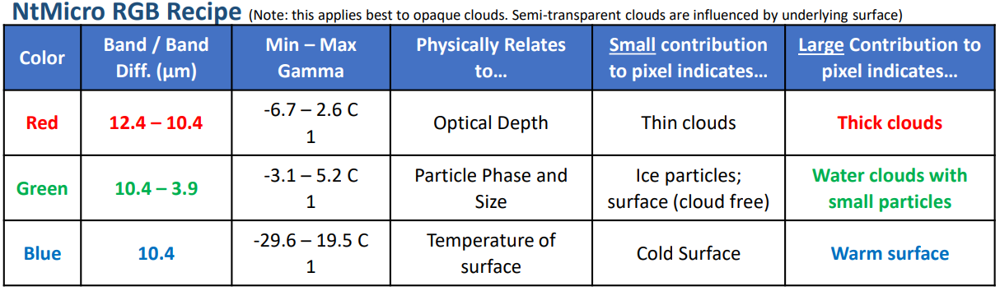

File /content/Samples/OR_ABI-L2-CMIPF-M6C15_G16_s20231350400203_e20231350409519_c20231350409595.nc exists
File /content/Samples/OR_ABI-L2-CMIPF-M6C13_G16_s20231350400203_e20231350409529_c20231350409589.nc exists
File /content/Samples/OR_ABI-L2-CMIPF-M6C07_G16_s20231350400203_e20231350409528_c20231350409596.nc exists


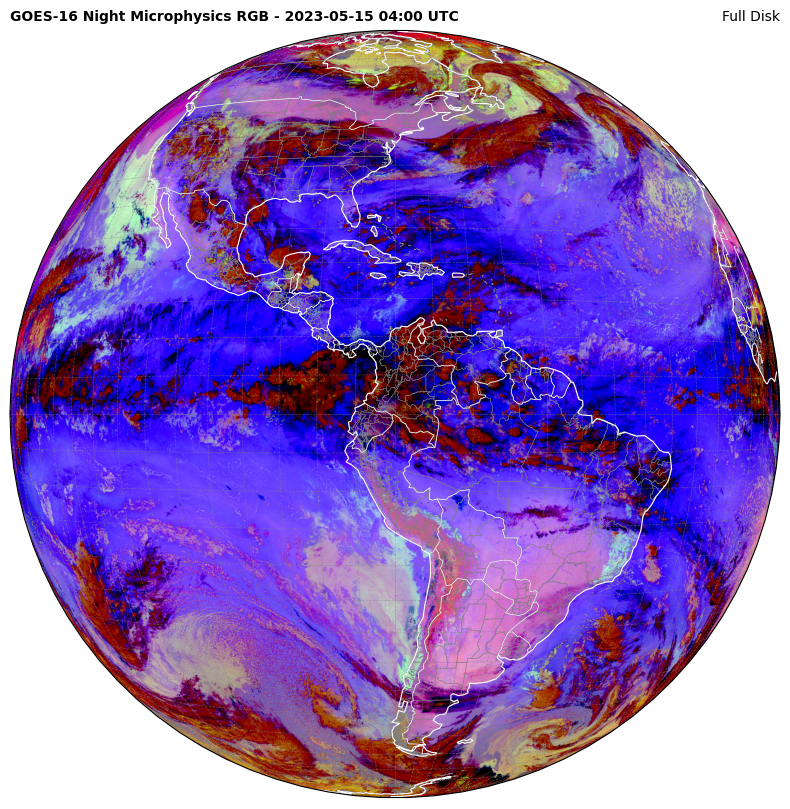

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Homework - Assignment 7 - NightMicrophysics RGB
#-----------------------------------------------------------------------------------------------------------

# Required modules
from netCDF4 import Dataset                # Read / Write NetCDF4 files
import matplotlib.pyplot as plt            # Plotting library
from datetime import datetime              # Basic Dates and time types
import cartopy, cartopy.crs as ccrs        # Plot maps
import cartopy.io.shapereader as shpreader # Import shapefiles
import numpy as np                         # Scientific computing with Python
import os                                  # Miscellaneous operating system interfaces
from utilities import download_CMI         # Our own utilities
import warnings; warnings.filterwarnings("ignore")

#-----------------------------------------------------------------------------------------------------------

# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# Time / Date for download
yyyymmddhhmn = '202305150400' # YYYYMMDDHHMN

# Download the file
file1 = download_CMI(yyyymmddhhmn, 15, input) # (Time&Date, Band, Directory)

# Download the file
file2 = download_CMI(yyyymmddhhmn, 13, input) # (Time&Date, Band, Directory)

# Download the file
file3 = download_CMI(yyyymmddhhmn, 7, input) # (Time&Date, Band, Directory)

#-----------------------------------------------------------------------------------------------------------

# Open the GOES-R image
file1 = Dataset(f'{input}/{file1}.nc')

# Get the pixel values
data_ch15 = file1.variables['CMI'][:,:][::4 ,::4] - 273.15

# Open the GOES-R image
file2 = Dataset(f'{input}/{file2}.nc')

# Get the pixel values
data_ch13 = file2.variables['CMI'][:,:][::4 ,::4] - 273.15

# Open the GOES-R image
file3 = Dataset(f'{input}/{file3}.nc')

# Get the pixel values
data_ch07 = file3.variables['CMI'][:,:][::4 ,::4] - 273.15

#-----------------------------------------------------------------------------------------------------------

# RGB Quick Guide: http://rammb.cira.colostate.edu/training/visit/quick_guides/QuickGuide_GOESR_AirMassRGB_final.pdf

# RGB Components (recipe)
R = data_ch15 - data_ch13
G = data_ch13 - data_ch07
B = data_ch13

# Minimuns and Maximuns (recipe)
Rmin = -6.7
Rmax = 2.6

Gmin = -3.1
Gmax = 5.2

Bmin = -29.6
Bmax = 19.5

R = np.clip(R, Rmin, Rmax)
G = np.clip(G, Gmin, Gmax)
B = np.clip(B, Bmin, Bmax)

# Gammas (recipe)
gamma_R = 1
gamma_G = 1
gamma_B = 1

# Normalize the data and appy the gamma correction
R = ((R - Rmin) / (Rmax - Rmin)) ** (1/gamma_R)
G = ((G - Gmin) / (Gmax - Gmin)) ** (1/gamma_G)
B = ((B - Bmin) / (Bmax - Bmin)) ** (1/gamma_B)

# Invert the "Blue" component
#B = 1.0 - B

# Create the RGB
RGB = np.stack([R, G, B], axis=2)

#-----------------------------------------------------------------------------------------------------------

# Choose the plot size (width x height, in inches)
plt.figure(figsize=(10,10))

# Use the Geostationary projection in cartopy
longitude_of_projection_origin = file1.variables['goes_imager_projection'].longitude_of_projection_origin
perspective_point_height = file1.variables['goes_imager_projection'].perspective_point_height
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=longitude_of_projection_origin, satellite_height=perspective_point_height))

# Extent of data in decimais (2712*0.000056*35786023.0)
xmin = file1.variables['x'][:].min()*perspective_point_height
xmax = file1.variables['x'][:].max()*perspective_point_height
ymin = file1.variables['y'][:].min()*perspective_point_height
ymax = file1.variables['y'][:].max()*perspective_point_height
img_extent = (xmin, xmax, ymin, ymax)

# Add a shapefile
shapefile = list(shpreader.Reader('/content/ne_10m_admin_1_states_provinces.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='gray',facecolor='none', linewidth=0.3)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
ax.coastlines(resolution='110m', color='white', linewidth=0.8)
ax.gridlines(color='gray', alpha=0.5, linestyle='--', linewidth=0.5, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5))

# Define the title
title = 'GOES-16 Night Microphysics RGB'

# Plot the image
img = ax.imshow(RGB, origin='upper', extent=img_extent)

# Extract date
date = (datetime.strptime(file1.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title(title + ' - ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')

#-----------------------------------------------------------------------------------------------------------

# Save the image
plt.savefig(f'{output}/image_nmp.png')

# Show the image
plt.show()

# **Assignment 8: Plot an RGB Composite - "Day Land Cloud"**

RAMMB Quick Guide:
https://rammb.cira.colostate.edu/training/visit/quick_guides/QuickGuide_GOESR_daylandcloudRGB_final.pdf




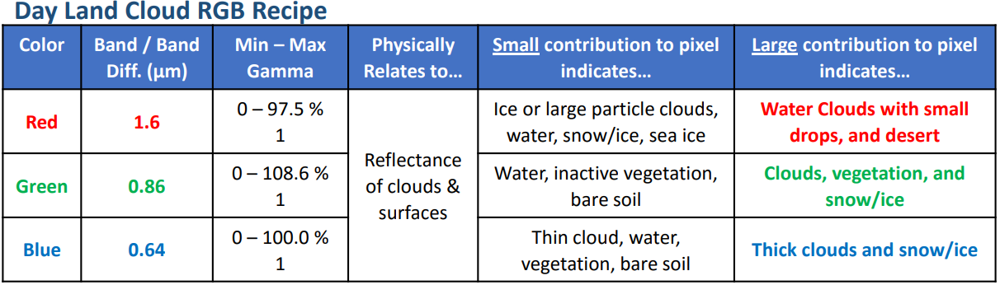

File /content/Samples/OR_ABI-L2-CMIPF-M6C05_G16_s20231341700203_e20231341709511_c20231341710027.nc exists
File /content/Samples/OR_ABI-L2-CMIPF-M6C03_G16_s20231341700203_e20231341709511_c20231341710007.nc exists
File /content/Samples/OR_ABI-L2-CMIPF-M6C02_G16_s20231341700203_e20231341709511_c20231341709599.nc exists


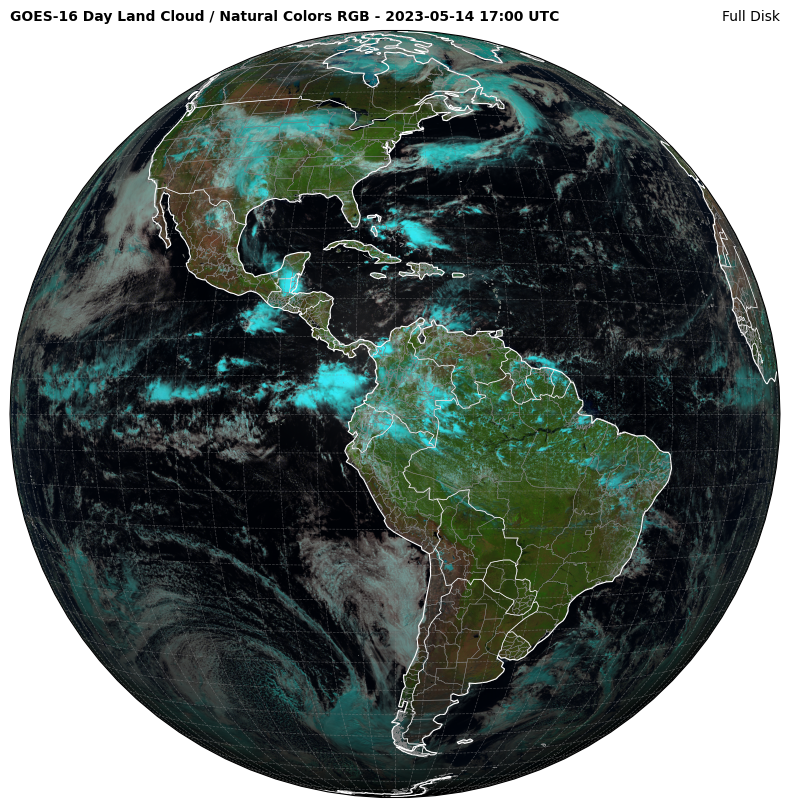

In [ ]:
#-----------------------------------------------------------------------------------------------------------
# Homework - Assignment 8 - Day Land Cloud / Natural Colors RGB
#-----------------------------------------------------------------------------------------------------------

# Required modules
from netCDF4 import Dataset                # Read / Write NetCDF4 files
import matplotlib.pyplot as plt            # Plotting library
from datetime import datetime              # Basic Dates and time types
import cartopy, cartopy.crs as ccrs        # Plot maps
import cartopy.io.shapereader as shpreader # Import shapefiles
import numpy as np                         # Scientific computing with Python
import os                                  # Miscellaneous operating system interfaces
from utilities import download_CMI         # Our own utilities
import warnings; warnings.filterwarnings("ignore")

#-----------------------------------------------------------------------------------------------------------

# Input and output directories
input = "/content/Samples"; os.makedirs(input, exist_ok=True)
output = "/content/Output"; os.makedirs(output, exist_ok=True)

# Time / Date for download
yyyymmddhhmn = '202305141700' # YYYYMMDDHHMN

# Download the file
file1 = download_CMI(yyyymmddhhmn, 5, input) # (Time&Date, Band, Directory)

# Download the file
file2 = download_CMI(yyyymmddhhmn, 3, input) # (Time&Date, Band, Directory)

# Download the file
file3 = download_CMI(yyyymmddhhmn, 2, input) # (Time&Date, Band, Directory)

#-----------------------------------------------------------------------------------------------------------

# Open the GOES-R image
file1 = Dataset(f'{input}/{file1}.nc')

# Get the pixel values
data_ch05 = file1.variables['CMI'][:,:][::4 ,::4]

# Open the GOES-R image
file2 = Dataset(f'{input}/{file2}.nc')

# Get the pixel values
data_ch03 = file2.variables['CMI'][:,:][::4 ,::4]

# Open the GOES-R image
file3 = Dataset(f'{input}/{file3}.nc')

# Get the pixel values
data_ch02 = file3.variables['CMI'][:,:][::8 ,::8]

#-----------------------------------------------------------------------------------------------------------

# RGB Quick Guide: http://rammb.cira.colostate.edu/training/visit/quick_guides/QuickGuide_GOESR_AirMassRGB_final.pdf

# RGB Components (recipe)
R = data_ch05
G = data_ch03
B = data_ch02

# Minimuns and Maximuns (recipe)
Rmin = 0.0
Rmax = 0.975

Gmin = 0
Gmax = 1.086

Bmin = 0
Bmax = 1

R = np.clip(R, Rmin, Rmax)
G = np.clip(G, Gmin, Gmax)
B = np.clip(B, Bmin, Bmax)

# Gammas (recipe)
gamma_R = 1
gamma_G = 1
gamma_B = 1

# Normalize the data and appy the gamma correction
R = ((R - Rmin) / (Rmax - Rmin)) ** (1/gamma_R)
G = ((G - Gmin) / (Gmax - Gmin)) ** (1/gamma_G)
B = ((B - Bmin) / (Bmax - Bmin)) ** (1/gamma_B)

# Create the RGB
RGB = np.stack([R, G, B], axis=2)

#-----------------------------------------------------------------------------------------------------------

# Choose the plot size (width x height, in inches)
plt.figure(figsize=(10,10))

# Use the Geostationary projection in cartopy
longitude_of_projection_origin = file1.variables['goes_imager_projection'].longitude_of_projection_origin
perspective_point_height = file1.variables['goes_imager_projection'].perspective_point_height
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=longitude_of_projection_origin, satellite_height=perspective_point_height))

# Extent of data in decimais (2712*0.000056*35786023.0)
xmin = file1.variables['x'][:].min()*perspective_point_height
xmax = file1.variables['x'][:].max()*perspective_point_height
ymin = file1.variables['y'][:].min()*perspective_point_height
ymax = file1.variables['y'][:].max()*perspective_point_height
img_extent = (xmin, xmax, ymin, ymax)

# Add a shapefile
shapefile = list(shpreader.Reader('/content/ne_10m_admin_1_states_provinces.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='gray',facecolor='none', linewidth=0.3)

# Add coastlines, borders and gridlines
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
ax.coastlines(resolution='110m', color='white', linewidth=0.8)
ax.gridlines(color='gray', alpha=0.5, linestyle='--', linewidth=0.5, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5))

# Define the title
title = 'GOES-16 Day Land Cloud / Natural Colors RGB'

# Plot the image
img = ax.imshow(RGB, origin='upper', extent=img_extent)

# Extract date
date = (datetime.strptime(file1.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ'))

# Add a title
plt.title(title + ' - ' + date.strftime('%Y-%m-%d %H:%M') + ' UTC', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')

#-----------------------------------------------------------------------------------------------------------

# Save the image
plt.savefig(f'{output}/image_dcp.png')

# Show the image
plt.show()

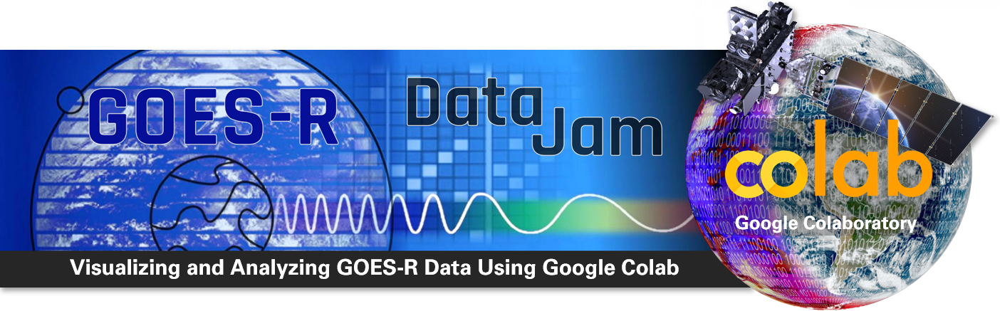

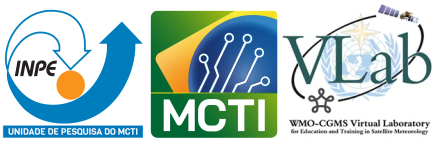

**Developed by:** Diego Souza - INPE / CGCT / DISSM - Brazil

**COLAB Notebook Version:** September 07, 2023

### **Contact:**
####Diego Souza - INPE / CGCT / DISSM - (diego.souza@inpe.br)
To reference this work, please use:
https://github.com/diegormsouza/gnc-a-caribbean/tree/main/GOES